# Fourier Transformation of Trajectories - Haibei Zhang

In [2]:
import os
import glob,csv
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import math
import matplotlib as mpl
import random
from PIL import Image
from skimage.io import imread, imshow

In [3]:
upperdir = '/'.join(os.getcwd().split('/')[:-2]) #define upper directory
lowerdir = '/TRACKS!/Sorted_Tracks/' #define lower directory where all the data is located
files = glob.glob(upperdir + lowerdir + '*.csv') #grab all the files in their pathways 
files = sorted(files) #sort the files based on the naming
len(files)

91

In [4]:
#Define a function to calculate the arc tangent value from 0-2pi
def myatan(y, x=None):
    if x is None:  # If only y is given, set x to 1
        x = 1

    v = np.nan
    if x > 0:
        v = np.arctan(y / x)
    if y >= 0 and x < 0:
        v = np.pi + np.arctan(y / x)
    if y < 0 and x < 0:
        v = -np.pi + np.arctan(y / x)
    if y > 0 and x == 0:
        v = np.pi / 2
    if y < 0 and x == 0:
        v = -np.pi / 2
    if v < 0:
        v += 2 * np.pi

    return v #returns the radian

# Example usage
y = 1
x = 1
angle = myatan(y, x)
print(angle) 

0.7853981633974483


In [5]:
## Angle computation
def anglestart(x_pos,y_pos,x_start,y_start,pixel_to_micron,skip):
    angles = []
    for t in range(0,len(x_pos),skip):
        x_repos = pixel_to_micron*(x_pos[t]-x_start)
        y_repos = pixel_to_micron*(y_pos[t]-y_start)
        angle = myatan(y_repos,x_repos)
        angles.append(angle)
    return angles

In [6]:
# Example usage
x_pos = np.array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20])
y_pos = np.array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20])
x_start = 0
y_start = 0
pixel_to_micron = 1

angles = anglestart(x_pos, y_pos, x_start, y_start, pixel_to_micron,skip=1)
#print(len(angles))

In [7]:

def sliding_window(elements, window_size, overlap):
    means = []
    step = window_size - overlap
    if step <= 0:
        raise ValueError("Overlap must be smaller than window size")
    if len(elements) <= window_size:
        return elements
    for i in range(0, len(elements) - window_size +1,step):
        mean = np.mean(elements[i:i+window_size])
        means.append(mean)
        #print((elements[i:i+window_size]),'k')
    return means

# Example usage
lst = [1, 1, 1, 2, 2, 2, 3, 3] 
window_size = 4
overlap = 2

result = sliding_window(lst, window_size, overlap)
print(result)

[1.25, 1.75, 2.5]


In [8]:
lst = [1,1,1,2,2,2,3,3] 
def sliding_window(elements, window_size):
    means = []
    if len(elements) <= window_size:
        return elements
    for i in range(len(elements)-window_size+1):
        #mean = np.mean(elements[i:i+window_size])
        #means.append(mean)
        print(elements[i:i+window_size])
    #return means

sliding_window(lst, 4)

[1, 1, 1, 2]
[1, 1, 2, 2]
[1, 2, 2, 2]
[2, 2, 2, 3]
[2, 2, 3, 3]


### Every 40/20/15/10/5/3 Frames

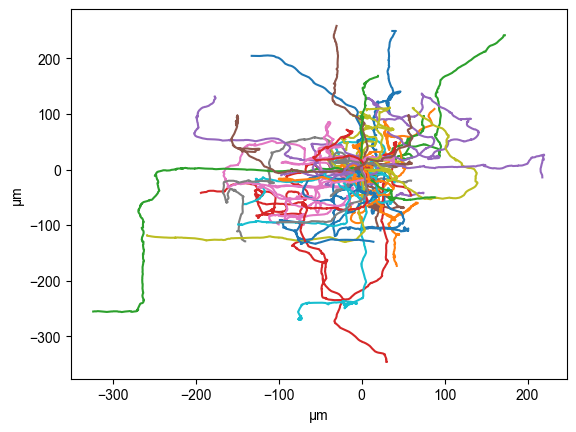

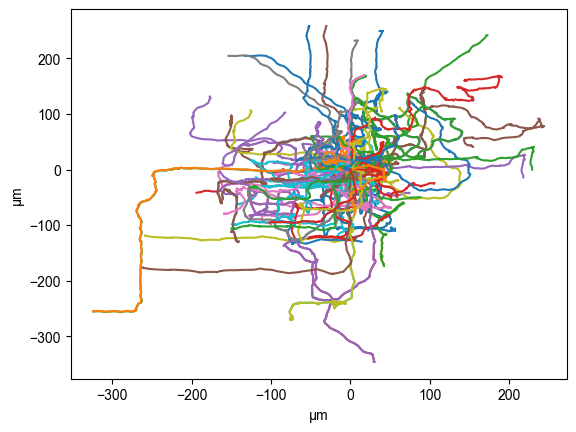

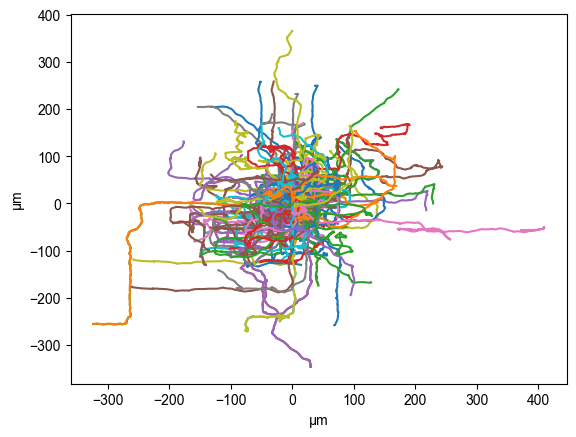

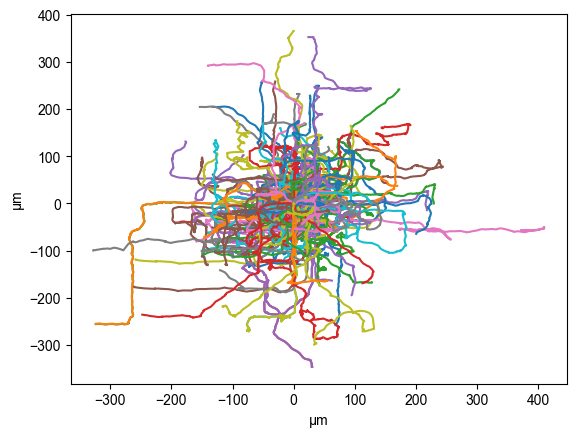

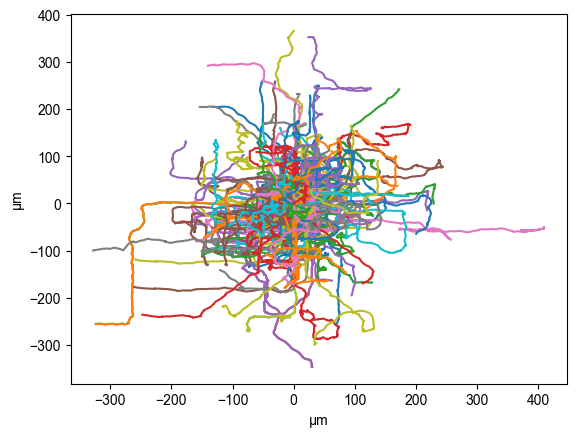

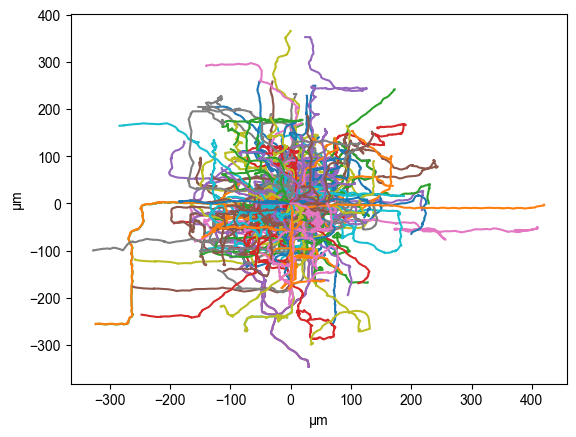

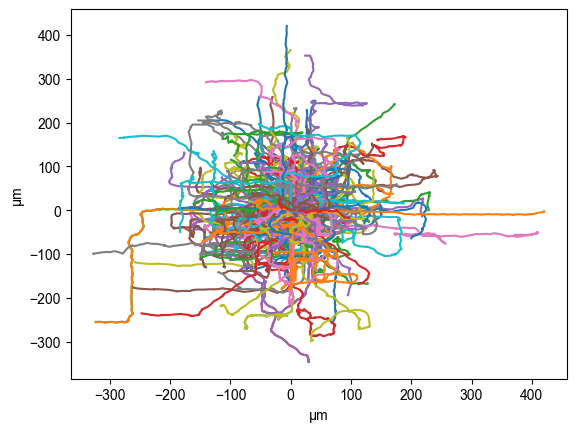

In [389]:
### Every 40 frames
#1.Construct a dictionary for data storage and analysis
datadic = {} #set up a data directory
dev = [] #number of device
pil= [] #number of confinement
dis = [] #number of disorders
rep = [] #number of repititions 
pixel_to_micron = 0.656 #pixel to micron (from Miles)
fps = 20 #frames per second
skip = 40

for file in files:
    
    curr_data = pd.read_csv(file)
    data = curr_data[['TRACK_ID','POSITION_X','POSITION_Y','POSITION_T']]
    grouped_df = data.groupby('TRACK_ID')
    # Filter out data with less spots
    minimum_spots = 160  # Replace this with a desired "minimum_spots" value
    filtered_df = grouped_df.filter(lambda group: len(group) >= minimum_spots)
    # Reindex the track IDs starting from 1
    filtered_df.reset_index(drop=True, inplace=True) #reindex the column starting from 0
    df = filtered_df.groupby('TRACK_ID', group_keys=True, as_index=False).apply(lambda x: x) #group the dataframe by TRACK_ID
    df.reset_index(level=0, inplace=True) #move the first level to a separate column
    df.rename(columns={'level_0': 'ID'}, inplace=True) #rename new level  
    track_names = df['ID'].unique().tolist()
    #print(df)
    
    device = file.split('-')[-5] #retrieve the strains used in each microfluidic device 
    pillar = file.split('-')[-4] #retrieve the specific confinement 
    disorder = file.split('-')[-3] #retrieve the specific disorder degree
    #repetition = file.split('-')[-1][:4] #the first four letter
    if device not in datadic:
        dev.extend([device])
        datadic[device] = {} 
    if pillar not in datadic[device]:
        if pillar not in pil:
            pil.extend([pillar])
        datadic[device][pillar] = {}
    if disorder not in datadic[device][pillar]:
        if disorder not in dis:
            dis.extend([disorder])
        datadic[device][pillar][disorder] = {}
        datadic[device][pillar][disorder]['time'] = []
        datadic[device][pillar][disorder]['rescaled_time'] = [] #Create a list to store all 'rescaled' time info
        datadic[device][pillar][disorder]['pos'] = []
        datadic[device][pillar][disorder]['rescaled_pos'] = [] #Create a list to store all 'rescaled' x and y info
        #datadic[device][pillar][disorder]['MSD'] = [[]]
        datadic[device][pillar][disorder]['reposition'] = []
        datadic[device][pillar][disorder]['angle_start'] = []
        
    for i in range(len(track_names)):
        time = np.array(df[df['ID']==track_names[i]]['POSITION_T'].tolist())
        time_start = time[0]        
       
        datadic[device][pillar][disorder]['time'].append(time)
        
        datadic[device][pillar][disorder]['rescaled_time'].append([(time[i]-time_start)/fps for i in range(len(time))]) #rescale the time as well based on fps
        x_pos = np.array(df[df['ID']==track_names[i]]['POSITION_X'].tolist())
        y_pos = np.array(df[df['ID']==track_names[i]]['POSITION_Y'].tolist())
        x_start = x_pos[0]
        y_start = y_pos[0] 
        datadic[device][pillar][disorder]['pos'].append([(x_pos[t]-x_start,y_pos[t]-y_start) for t in range(len(x_pos))])
        datadic[device][pillar][disorder]['rescaled_pos'].append([(pixel_to_micron*x_pos[t], pixel_to_micron*y_pos[t]) for t in range(len(x_pos))]) 
        datadic[device][pillar][disorder]['reposition'].append([(pixel_to_micron*(x_pos[t]-x_start), pixel_to_micron*(y_pos[t]-y_start)) for t in range(len(x_pos))])
        
        #compute the angles with respect to the same origin (0,0)
        angles = anglestart(x_pos,y_pos,x_start,y_start,pixel_to_micron,skip)
        datadic[device][pillar][disorder]['angle_start'].append(angles)
        
    #     Test whether the trajecories are stored properly           
    if device == 'dev1' and pillar == 'pil1' and disorder == 'dis1':
         for i in range(len(datadic[device][pillar][disorder]['reposition'])):
            path = np.array(datadic[device][pillar][disorder]['reposition'][i])
            plt.plot(*path.T) # ".T" attribute is used to transpose the array, swapping its rows and columns. # "*" unpacks the rows of the transposed array
            plt.xlabel('µm')
            plt.ylabel('µm')

    plt.show()

In [390]:
alpha = []

for dev in list(datadic):
    for pil in list(datadic[dev]):
        for dis in list(datadic[dev][pil]):
            alpha.extend([(pil, dis, angle) for angle in datadic[dev][pil][dis]['angle_start']])

df = pd.DataFrame(alpha,columns=['confinement', 'disorder', 'alpha'])

pillar_mapping = {'pil0': 'Unc', 'pil1': '6 µm', 'pil2': '2.6 µm', 'pil3': '1.3 µm'}
disorder_mapping = {'dis0': '0x', 'dis1': '0x', 'dis2': '1x', 
                    'dis3': '2x', 'dis4':'3x'}

# Replace the category names in the DataFrame
df['confinement'] = df['confinement'].replace(pillar_mapping)
df['disorder'] = df['disorder'].replace(disorder_mapping) 


#Merge the two columns to one 'condition' column
df['condition'] = df['confinement'] + '; ' + df['disorder']

df_exploded = df.explode('alpha')
df_exploded

,confinement,disorder,alpha,condition
0,Unc,0x,NaN,Unc; 0x
0,Unc,0x,2.56227,Unc; 0x
0,Unc,0x,2.89106,Unc; 0x
0,Unc,0x,2.91093,Unc; 0x
0,Unc,0x,3.106642,Unc; 0x
...,...,...,...,...
4100,1.3 µm,3x,NaN,1.3 µm; 3x
4100,1.3 µm,3x,0.559363,1.3 µm; 3x
4100,1.3 µm,3x,2.083259,1.3 µm; 3x
4100,1.3 µm,3x,2.477234,1.3 µm; 3x


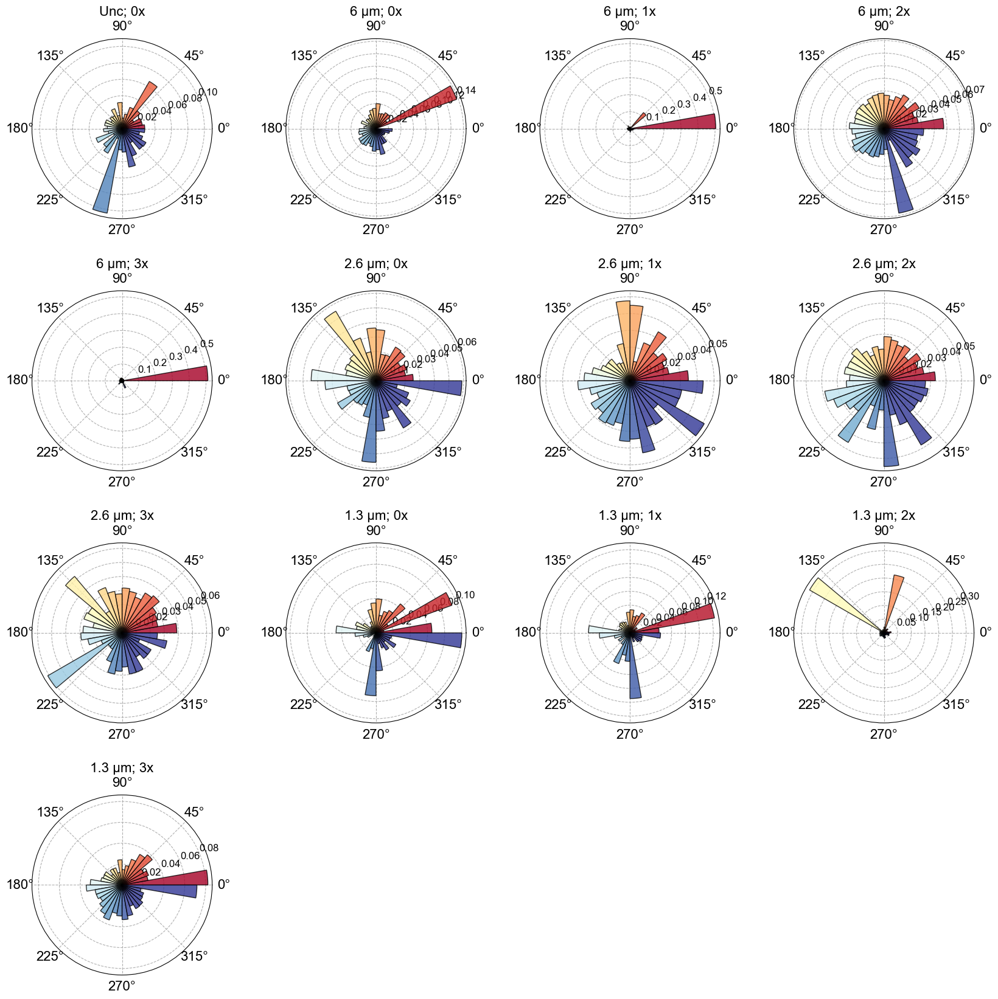

In [391]:
#Every 40 frames
condition = ['Unc; 0x', '6 µm; 0x', '6 µm; 1x', '6 µm; 2x', '6 µm; 3x',
       '2.6 µm; 0x', '2.6 µm; 1x', '2.6 µm; 2x', '2.6 µm; 3x', 
        '1.3 µm; 0x', '1.3 µm; 1x', '1.3 µm; 2x', '1.3 µm; 3x']

fig, axes = plt.subplots(nrows=4, ncols=4, subplot_kw=dict(projection="polar"), figsize=(20, 20))
fig.subplots_adjust(hspace=0.4, wspace=0.4)

for i, ax in enumerate(axes.flat):
    if i < len(condition):
        subset_df = df_exploded[df_exploded['condition'] == condition[i]]['alpha']
        
        # Define binning
        abins = np.linspace(0, 2*np.pi, 37)
        
        # Calculate histogram
        hist, bin_edges = np.histogram(subset_df, bins=abins)
        
        # Normalize histogram
        hist = hist / (len(subset_df))
        
        # Create the bar plot on the polar axis
        bars = ax.bar(bin_edges[:-1], hist, width=(2*np.pi)/36, align='edge')
        ax.set_theta_zero_location("E")
        
        # Use custom colors and opacity
        for r, bar in zip(bin_edges[:-1], bars):
            bar.set_facecolor(plt.cm.RdYlBu(r / 5.))
            bar.set_edgecolor('black')
            bar.set_alpha(0.8)
            bar.set_zorder(2)
        
        # Change the size of the degree labels
        ax.tick_params(axis='x', labelsize=16)
        ax.tick_params(axis='y', labelsize=12)
        
        # Set grid style
        ax.grid(True, linestyle='dashed', zorder=1)
        ax.set_title(condition[i], fontsize=16)
    else:
        # Hide any extra subplots if the number of conditions is less than 16
        ax.axis('off')

plt.show()

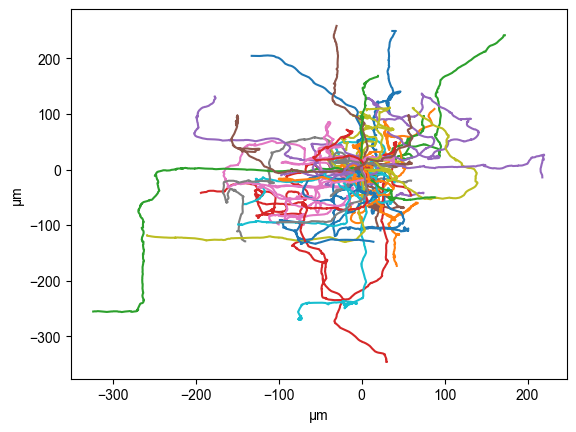

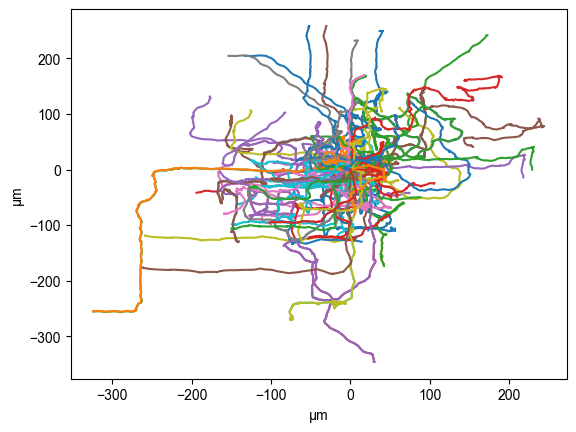

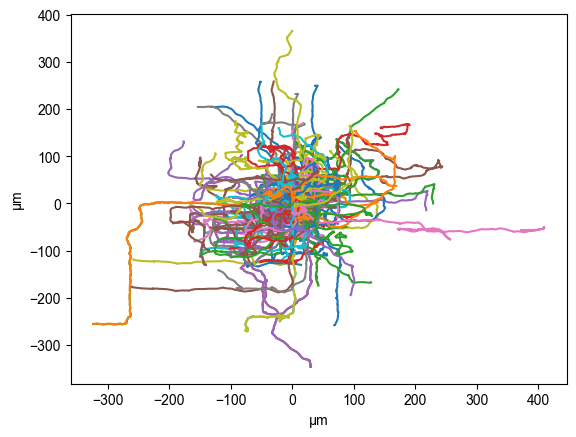

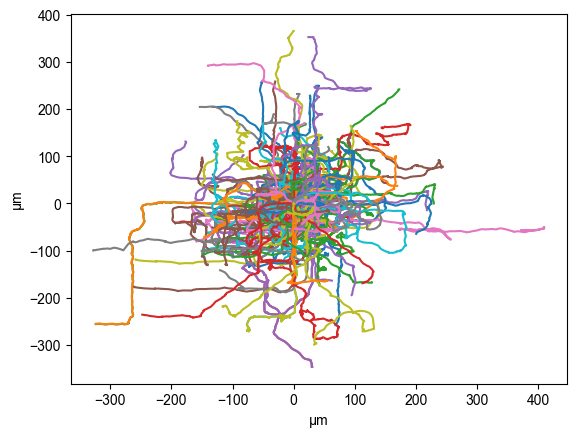

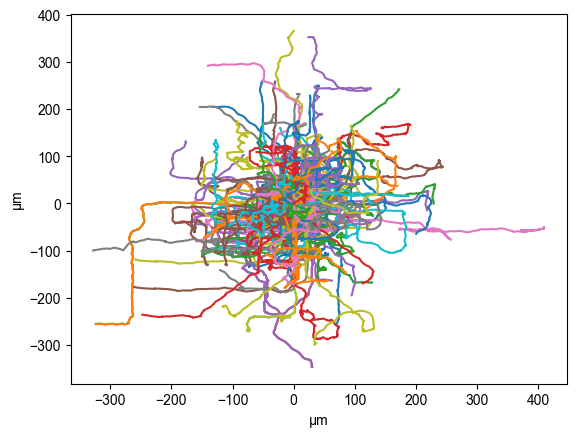

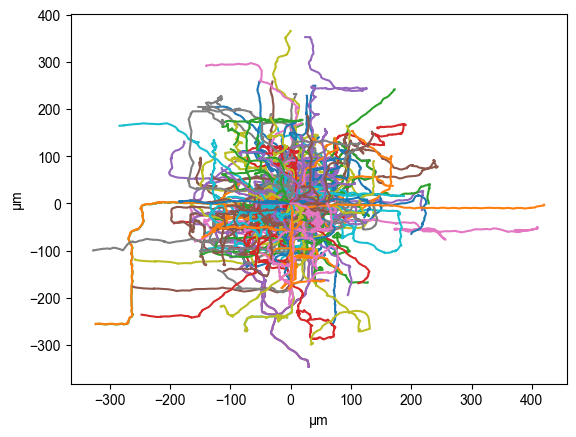

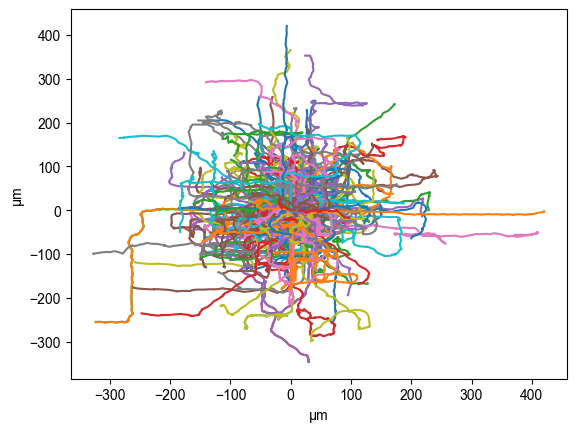

In [165]:
### Every 20 frames
#1.Construct a dictionary for data storage and analysis
datadic = {} #set up a data directory
dev = [] #number of device
pil= [] #number of confinement
dis = [] #number of disorders
rep = [] #number of repititions 
pixel_to_micron = 0.656 #pixel to micron (from Miles)
fps = 20 #frames per second
skip = 20

for file in files:
    
    curr_data = pd.read_csv(file)
    data = curr_data[['TRACK_ID','POSITION_X','POSITION_Y','POSITION_T']]
    grouped_df = data.groupby('TRACK_ID')
    # Filter out data with less spots
    minimum_spots = 160  # Replace this with a desired "minimum_spots" value
    filtered_df = grouped_df.filter(lambda group: len(group) >= minimum_spots)
    # Reindex the track IDs starting from 1
    filtered_df.reset_index(drop=True, inplace=True) #reindex the column starting from 0
    df = filtered_df.groupby('TRACK_ID', group_keys=True, as_index=False).apply(lambda x: x) #group the dataframe by TRACK_ID
    df.reset_index(level=0, inplace=True) #move the first level to a separate column
    df.rename(columns={'level_0': 'ID'}, inplace=True) #rename new level  
    track_names = df['ID'].unique().tolist()
    #print(df)
    
    device = file.split('-')[-5] #retrieve the strains used in each microfluidic device 
    pillar = file.split('-')[-4] #retrieve the specific confinement 
    disorder = file.split('-')[-3] #retrieve the specific disorder degree
    #repetition = file.split('-')[-1][:4] #the first four letter
    if device not in datadic:
        dev.extend([device])
        datadic[device] = {} 
    if pillar not in datadic[device]:
        if pillar not in pil:
            pil.extend([pillar])
        datadic[device][pillar] = {}
    if disorder not in datadic[device][pillar]:
        if disorder not in dis:
            dis.extend([disorder])
        datadic[device][pillar][disorder] = {}
        datadic[device][pillar][disorder]['time'] = []
        datadic[device][pillar][disorder]['rescaled_time'] = [] #Create a list to store all 'rescaled' time info
        datadic[device][pillar][disorder]['pos'] = []
        datadic[device][pillar][disorder]['rescaled_pos'] = [] #Create a list to store all 'rescaled' x and y info
        #datadic[device][pillar][disorder]['MSD'] = [[]]
        datadic[device][pillar][disorder]['reposition'] = []
        datadic[device][pillar][disorder]['angle_start'] = []
        
    for i in range(len(track_names)):
        time = np.array(df[df['ID']==track_names[i]]['POSITION_T'].tolist())
        time_start = time[0]        
       
        datadic[device][pillar][disorder]['time'].append(time)
        
        datadic[device][pillar][disorder]['rescaled_time'].append([(time[i]-time_start)/fps for i in range(len(time))]) #rescale the time as well based on fps
        x_pos = np.array(df[df['ID']==track_names[i]]['POSITION_X'].tolist())
        y_pos = np.array(df[df['ID']==track_names[i]]['POSITION_Y'].tolist())
        x_start = x_pos[0]
        y_start = y_pos[0] 
        datadic[device][pillar][disorder]['pos'].append([(x_pos[t]-x_start,y_pos[t]-y_start) for t in range(len(x_pos))])
        datadic[device][pillar][disorder]['rescaled_pos'].append([(pixel_to_micron*x_pos[t], pixel_to_micron*y_pos[t]) for t in range(len(x_pos))]) 
        datadic[device][pillar][disorder]['reposition'].append([(pixel_to_micron*(x_pos[t]-x_start), pixel_to_micron*(y_pos[t]-y_start)) for t in range(len(x_pos))])
        
        #compute the angles with respect to the same origin (0,0)
        angles = anglestart(x_pos,y_pos,x_start,y_start,pixel_to_micron,skip)
        datadic[device][pillar][disorder]['angle_start'].append(angles)
        
    #     Test whether the trajecories are stored properly           
    if device == 'dev1' and pillar == 'pil1' and disorder == 'dis1':
         for i in range(len(datadic[device][pillar][disorder]['reposition'])):
            path = np.array(datadic[device][pillar][disorder]['reposition'][i])
            plt.plot(*path.T) # ".T" attribute is used to transpose the array, swapping its rows and columns. # "*" unpacks the rows of the transposed array
            plt.xlabel('µm')
            plt.ylabel('µm')

    plt.show()
       

In [170]:
alpha = []

for dev in list(datadic):
    for pil in list(datadic[dev]):
        for dis in list(datadic[dev][pil]):
            alpha.extend([(pil, dis, angle) for angle in datadic[dev][pil][dis]['angle_start']])

df = pd.DataFrame(alpha,columns=['confinement', 'disorder', 'alpha'])

pillar_mapping = {'pil0': 'Unc', 'pil1': '6 µm', 'pil2': '2.6 µm', 'pil3': '1.3 µm'}
disorder_mapping = {'dis0': '0x', 'dis1': '0x', 'dis2': '1x', 
                    'dis3': '2x', 'dis4':'3x'}

# Replace the category names in the DataFrame
df['confinement'] = df['confinement'].replace(pillar_mapping)
df['disorder'] = df['disorder'].replace(disorder_mapping) 


#Merge the two columns to one 'condition' column
df['condition'] = df['confinement'] + '; ' + df['disorder']

df_exploded = df.explode('alpha')
df_exploded

In [172]:
df

,confinement,disorder,alpha,condition
0,Unc,0x,"[nan, 2.5934902057260474, 2.5622697501352234, ...",Unc; 0x
1,Unc,0x,"[nan, 0.0, 0.0, 6.088770014430803, 5.910085054...",Unc; 0x
2,Unc,0x,"[nan, 1.5630790583406275, 2.00438813274753, 2....",Unc; 0x
3,Unc,0x,"[nan, 5.369221549856759, 5.302436915633407, 5....",Unc; 0x
4,Unc,0x,"[nan, 4.842828560408935, 4.7466182189922, 4.15...",Unc; 0x
...,...,...,...,...
4096,1.3 µm,3x,"[nan, 3.36426945953026, 2.714618780273717, 2.8...",1.3 µm; 3x
4097,1.3 µm,3x,"[nan, 5.8980745124680025, 5.283041861581032, 5...",1.3 µm; 3x
4098,1.3 µm,3x,"[nan, 2.0584576841290114, 2.2161892210773932, ...",1.3 µm; 3x
4099,1.3 µm,3x,"[nan, 3.3932631481172484, 3.361812970707909, 3...",1.3 µm; 3x


In [175]:
df_exploded = df.explode('alpha')
df_exploded

,confinement,disorder,alpha,condition
0,Unc,0x,NaN,Unc; 0x
0,Unc,0x,2.59349,Unc; 0x
0,Unc,0x,2.56227,Unc; 0x
0,Unc,0x,2.770207,Unc; 0x
0,Unc,0x,2.89106,Unc; 0x
...,...,...,...,...
4100,1.3 µm,3x,2.083259,1.3 µm; 3x
4100,1.3 µm,3x,2.530234,1.3 µm; 3x
4100,1.3 µm,3x,2.477234,1.3 µm; 3x
4100,1.3 µm,3x,2.481418,1.3 µm; 3x


In [307]:
subset_df = df_exploded[df_exploded['condition'] == '6 µm; 3x']['alpha']
subset_df

1505         NaN
1505    2.510896
1505    1.864211
1505     6.06858
1505     5.48653
          ...   
2065    4.575481
2065     4.60033
2065    4.263516
2065    3.714342
2065     3.53364
Name: alpha, Length: 12696, dtype: object

In [220]:
# Assume subset_alpha is the filtered DataFrame column with angles
theta = np.random.uniform(0, 2*np.pi, 50)
theta

array([4.33261252, 1.47227829, 2.806437  , 1.17977397, 2.36679875,
       3.44340334, 6.07780537, 5.12162425, 1.12438833, 3.67942732,
       1.515112  , 1.97470621, 1.45688551, 0.87425156, 0.65804024,
       6.10051122, 2.90085195, 4.00955596, 4.5416753 , 1.91250719,
       3.54731078, 3.37878909, 3.1948297 , 5.54648845, 5.03281872,
       5.47638728, 2.32347058, 0.05852421, 0.45195609, 0.35188646,
       0.23051619, 5.81881014, 6.1707202 , 5.6892853 , 4.63748893,
       4.10975013, 2.02443618, 0.63619186, 3.38389024, 3.41810167,
       3.98984676, 2.44112942, 1.17303071, 3.02076981, 0.56444136,
       4.82444389, 0.11926357, 4.15584759, 1.87882212, 3.99876565])

In [196]:
hist= np.histogram(theta, bins=abins)
hist

(array([1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1,
        0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]),
 array([0.        , 0.17951958, 0.35903916, 0.53855874, 0.71807832,
        0.8975979 , 1.07711748, 1.25663706, 1.43615664, 1.61567622,
        1.7951958 , 1.97471538, 2.15423496, 2.33375454, 2.51327412,
        2.6927937 , 2.87231328, 3.05183286, 3.23135244, 3.41087202,
        3.5903916 , 3.76991118, 3.94943076, 4.12895034, 4.30846992,
        4.48798951, 4.66750909, 4.84702867, 5.02654825, 5.20606783,
        5.38558741, 5.56510699, 5.74462657, 5.92414615, 6.10366573,
        6.28318531]))

In [211]:
np.linspace(0.0,10,11)

array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10.])

In [212]:
abins = np.linspace(0, 2*np.pi,37)
abins

array([0.        , 0.17453293, 0.34906585, 0.52359878, 0.6981317 ,
       0.87266463, 1.04719755, 1.22173048, 1.3962634 , 1.57079633,
       1.74532925, 1.91986218, 2.0943951 , 2.26892803, 2.44346095,
       2.61799388, 2.7925268 , 2.96705973, 3.14159265, 3.31612558,
       3.4906585 , 3.66519143, 3.83972435, 4.01425728, 4.1887902 ,
       4.36332313, 4.53785606, 4.71238898, 4.88692191, 5.06145483,
       5.23598776, 5.41052068, 5.58505361, 5.75958653, 5.93411946,
       6.10865238, 6.28318531])

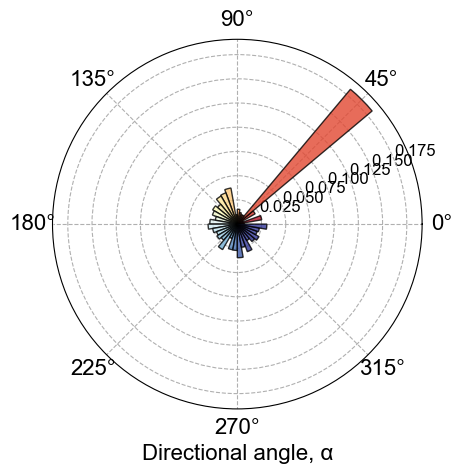

In [365]:
subset_df = df_exploded[df_exploded['condition'] == '2.6 µm; 3x']['alpha']

# define binning
abins = np.linspace(0, 2*np.pi,37)
#bottom = 0.1
# Calculate histogram
hist, bin_edges = np.histogram(subset_df, bins=abins)
# Normalize histogram
hist = hist / (len(subset_df))# * np.diff(abins))

# Plot
fig, ax = plt.subplots(subplot_kw=dict(projection="polar"))

# Create the bar plot on the polar axis
bars = ax.bar(bin_edges[:-1], hist, width=(2*np.pi)/36,align='edge')

# Use custom colors and opacity
for r, bar in zip(bin_edges[:-1], bars):
    bar.set_facecolor(plt.cm.RdYlBu(r /5.))
    bar.set_edgecolor('black')
    bar.set_alpha(0.8)
    bar.set_zorder(2)
# Change the size of the degree labels
ax.tick_params(axis='x', labelsize=16)
ax.tick_params(axis='y', labelsize=12)

#ax.set_yticks([0.2,0.3,0.4,0.5])  # Example values; change as needed
ax.set_xlabel('Directional angle, α',fontsize=16)
# Set grid style
ax.grid(True, linestyle='dashed',zorder=1)

# Show plot
plt.show()

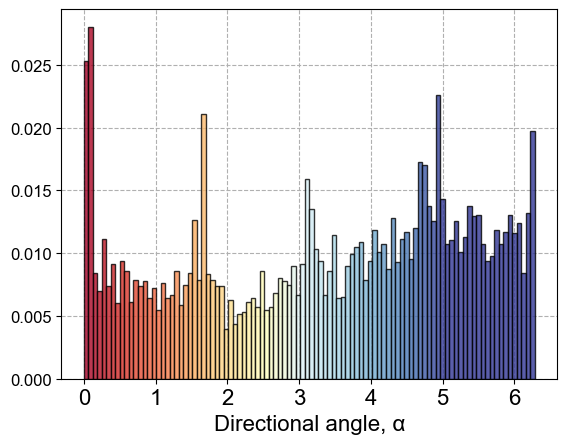

In [373]:
subset_df = df_exploded[df_exploded['condition'] == '2.6 µm; 3x']['alpha']

# define binning
abins = np.linspace(0, 2*np.pi,101)
#bottom = 0.1
# Calculate histogram
hist, bin_edges = np.histogram(subset_df, bins=abins)
# Normalize histogram
hist = hist / (len(subset_df))# * np.diff(abins))

# Plot
fig, ax = plt.subplots()

# Create the bar plot on the polar axis
bars = ax.bar(bin_edges[:-1], hist, width=(2*np.pi)/100,align='edge')

# Use custom colors and opacity
for r, bar in zip(bin_edges[:-1], bars):
    bar.set_facecolor(plt.cm.RdYlBu(r /5.))
    bar.set_edgecolor('black')
    bar.set_alpha(0.8)
    bar.set_zorder(2)
# Change the size of the degree labels
ax.tick_params(axis='x', labelsize=16)
ax.tick_params(axis='y', labelsize=12)

#ax.set_yticks([0.2,0.3,0.4,0.5])  # Example values; change as needed
ax.set_xlabel('Directional angle, α',fontsize=16)
# Set grid style
ax.grid(True, linestyle='dashed',zorder=1)

# Show plot
plt.show()

In [330]:
from scipy import stats as st

In [339]:
subset_df = df_exploded[df_exploded['condition'] == '2.6 µm; 3x']['alpha']

#sns.histplot(data=subset_df,x='alpha',binwidth=1)

2992         NaN
2992    4.842679
2992    5.503885
2992    5.039813
2992    4.790279
          ...   
2996    3.586008
2996    3.762931
2996    3.688977
2996    3.686741
2996    3.776976
Name: alpha, Length: 100, dtype: object

In [342]:
np.diff(abins)

array([0.17453293, 0.17453293, 0.17453293, 0.17453293, 0.17453293,
       0.17453293, 0.17453293, 0.17453293, 0.17453293, 0.17453293,
       0.17453293, 0.17453293, 0.17453293, 0.17453293, 0.17453293,
       0.17453293, 0.17453293, 0.17453293, 0.17453293, 0.17453293,
       0.17453293, 0.17453293, 0.17453293, 0.17453293, 0.17453293,
       0.17453293, 0.17453293, 0.17453293, 0.17453293, 0.17453293,
       0.17453293, 0.17453293, 0.17453293, 0.17453293, 0.17453293,
       0.17453293])

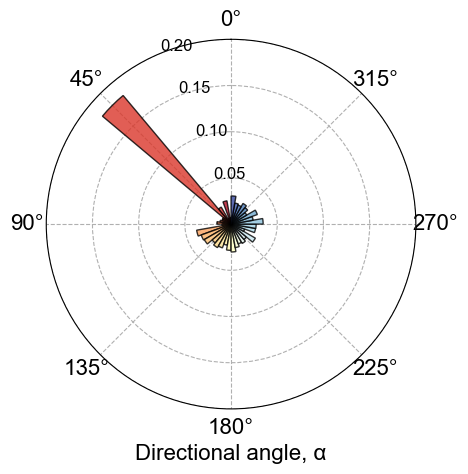

In [349]:
subset_df = df_exploded[df_exploded['condition'] == '2.6 µm; 3x']['alpha']

# define binning
abins = np.linspace(0, 2*np.pi,37)
#bottom = 0.1
# Calculate histogram
hist, bin_edges = np.histogram(subset_df, bins=abins)
# Normalize histogram
hist = hist / len(subset_df) #* np.diff(abins)

# Plot
fig, ax = plt.subplots(subplot_kw=dict(projection="polar"))

# Create the bar plot on the polar axis
bars = ax.bar(bin_edges[:-1], hist, width=(2*np.pi)/36,align='edge')

# Use custom colors and opacity
for r, bar in zip(bin_edges[:-1], bars):
    bar.set_facecolor(plt.cm.RdYlBu(r /(2*np.pi)))
    bar.set_edgecolor('black')
    bar.set_alpha(0.8)
    bar.set_zorder(2)
# Change the size of the degree labels
ax.tick_params(axis='x', labelsize=16)
ax.tick_params(axis='y', labelsize=12)
ax.set_theta_zero_location("N")
ax.set_yticks([0.05,0.10,0.15,0.2])  # Example values; change as needed
ax.set_xlabel('Directional angle, α',fontsize=16)
# Set grid style
ax.grid(True, linestyle='dashed',zorder=1)

# Show plot
plt.show()

In [306]:
df_exploded[df_exploded['condition'] == condition[i]]

,confinement,disorder,alpha,condition
0,Unc,0x,NaN,Unc; 0x
0,Unc,0x,2.59349,Unc; 0x
0,Unc,0x,2.56227,Unc; 0x
0,Unc,0x,2.770207,Unc; 0x
0,Unc,0x,2.89106,Unc; 0x
...,...,...,...,...
109,Unc,0x,4.033728,Unc; 0x
109,Unc,0x,4.207665,Unc; 0x
109,Unc,0x,4.238724,Unc; 0x
109,Unc,0x,4.22324,Unc; 0x


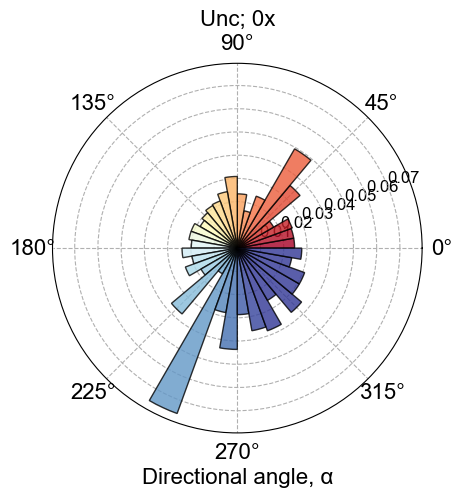

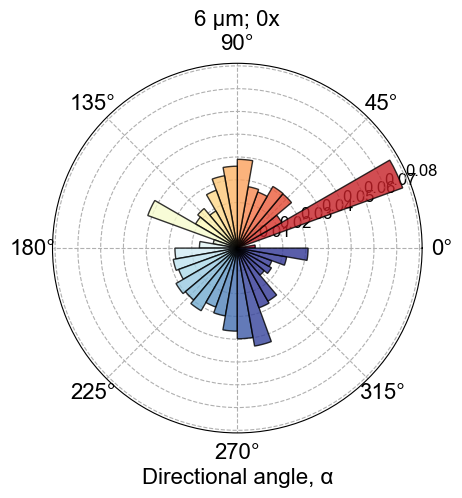

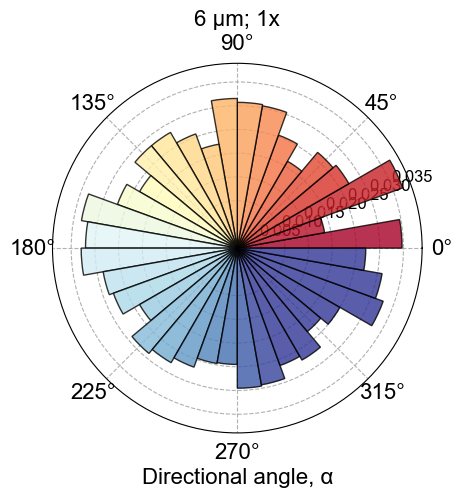

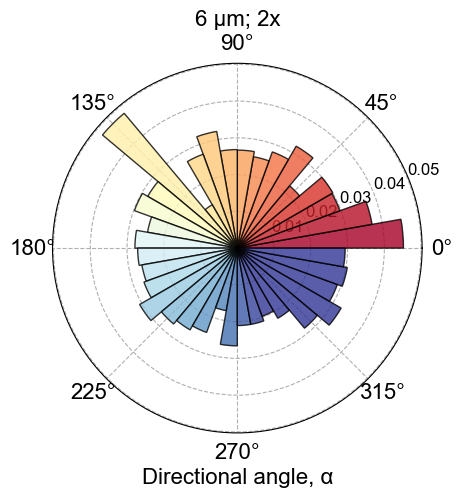

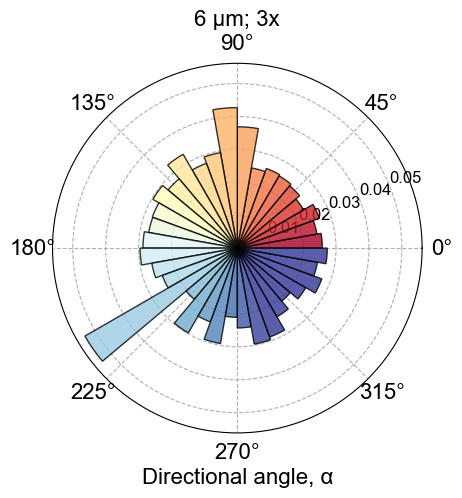

...

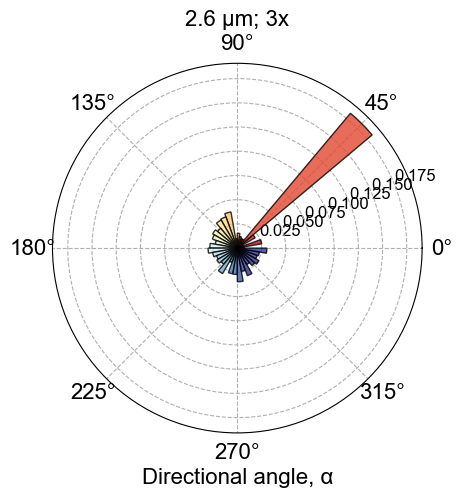

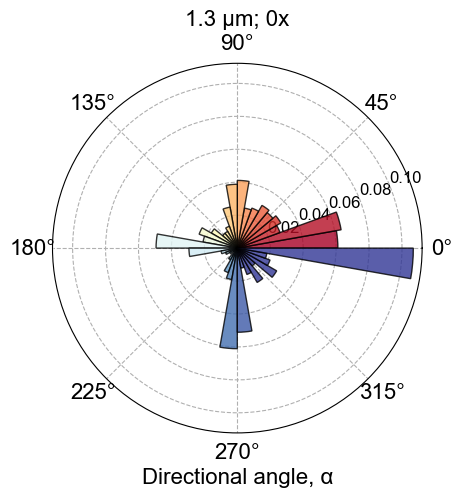

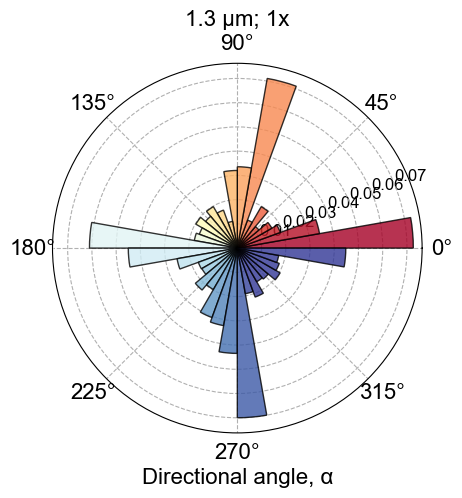

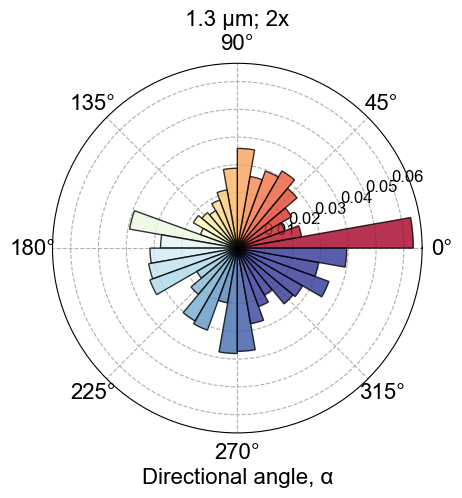

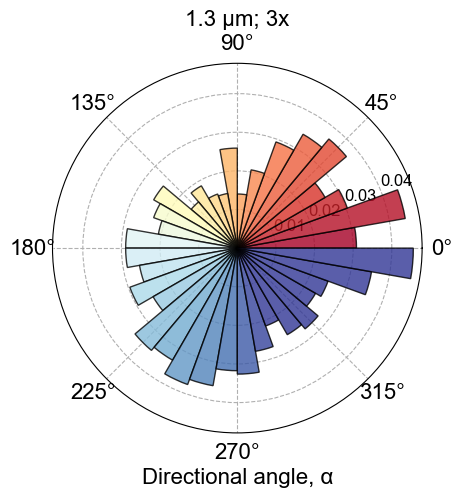

In [352]:
condition = ['Unc; 0x', '6 µm; 0x', '6 µm; 1x', '6 µm; 2x', '6 µm; 3x',
       '2.6 µm; 0x', '2.6 µm; 1x', '2.6 µm; 2x', '2.6 µm; 3x', 
        '1.3 µm; 0x', '1.3 µm; 1x', '1.3 µm; 2x', '1.3 µm; 3x']

for i in range(len(condition)):
    
    subset_df = df_exploded[df_exploded['condition'] == condition[i]]['alpha']
    
    # define binning
    abins = np.linspace(0, 2*np.pi,37)
    #bottom = 0.1
    # Calculate histogram
    hist, bin_edges = np.histogram(subset_df, bins=abins)
    # Normalize histogram
    hist = hist / len(subset_df)

    # Plot
    fig, ax = plt.subplots(subplot_kw=dict(projection="polar"))

    # Create the bar plot on the polar axis
    bars = ax.bar(bin_edges[:-1], hist, width=(2*np.pi)/36,align='edge')
    ax.set_theta_zero_location("E")
    # Use custom colors and opacity
    for r, bar in zip(bin_edges[:-1], bars):
        bar.set_facecolor(plt.cm.RdYlBu(r /5.))
        bar.set_edgecolor('black')
        bar.set_alpha(0.8)
        bar.set_zorder(2)
    # Change the size of the degree labels
    ax.tick_params(axis='x', labelsize=16)
    ax.tick_params(axis='y', labelsize=12)

    #ax.set_yticks([0.05,0.10,0.15,0.2])  # Example values; change as needed
    ax.set_xlabel('Directional angle, α',fontsize=16)
    # Set grid style
    ax.grid(True, linestyle='dashed',zorder=1)
    ax.set_title(condition[i],fontsize=16)
    # Show plot
    plt.show()
    

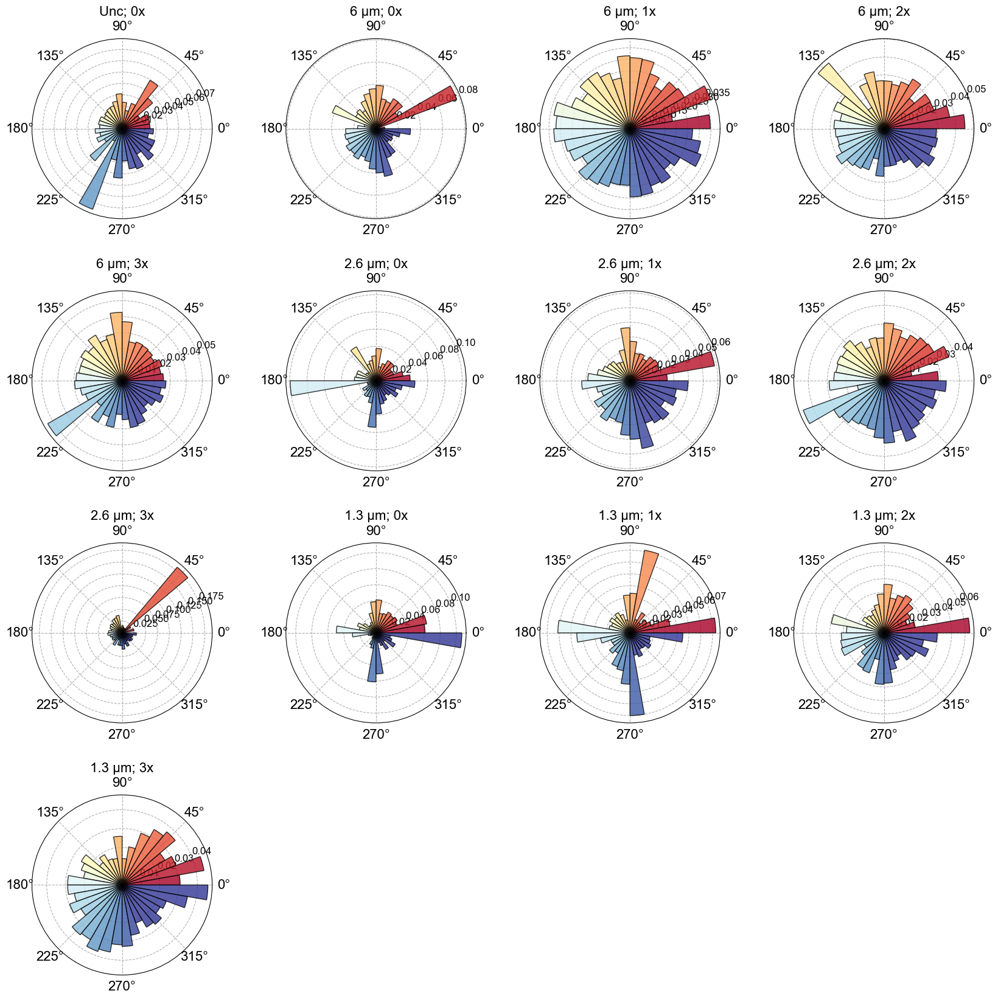

In [353]:
#Every 20 frames

fig, axes = plt.subplots(nrows=4, ncols=4, subplot_kw=dict(projection="polar"), figsize=(20, 20))
fig.subplots_adjust(hspace=0.4, wspace=0.4)

for i, ax in enumerate(axes.flat):
    if i < len(condition):
        subset_df = df_exploded[df_exploded['condition'] == condition[i]]['alpha']
        
        # Define binning
        abins = np.linspace(0, 2*np.pi, 37)
        
        # Calculate histogram
        hist, bin_edges = np.histogram(subset_df, bins=abins)
        
        # Normalize histogram
        hist = hist / len(subset_df)
        
        # Create the bar plot on the polar axis
        bars = ax.bar(bin_edges[:-1], hist, width=(2*np.pi)/36, align='edge')
        ax.set_theta_zero_location("E")
        
        # Use custom colors and opacity
        for r, bar in zip(bin_edges[:-1], bars):
            bar.set_facecolor(plt.cm.RdYlBu(r / 5.))
            bar.set_edgecolor('black')
            bar.set_alpha(0.8)
            bar.set_zorder(2)
        
        # Change the size of the degree labels
        ax.tick_params(axis='x', labelsize=16)
        ax.tick_params(axis='y', labelsize=12)
        
        # Set grid style
        ax.grid(True, linestyle='dashed', zorder=1)
        ax.set_title(condition[i], fontsize=16)
    else:
        # Hide any extra subplots if the number of conditions is less than 16
        ax.axis('off')

plt.show()

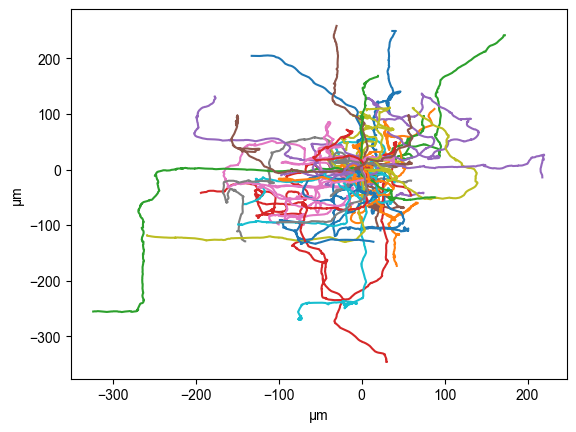

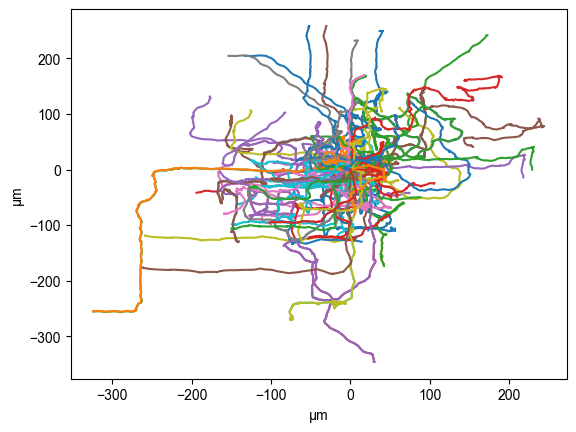

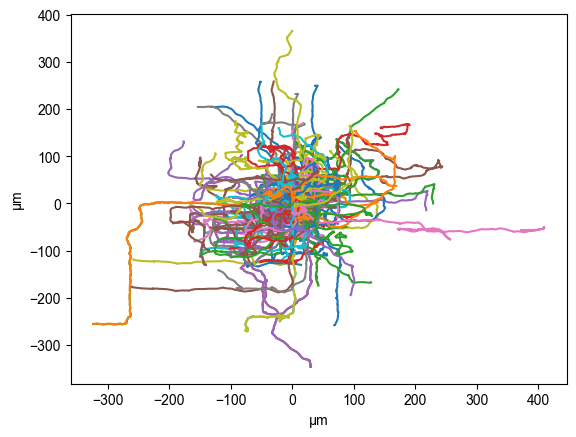

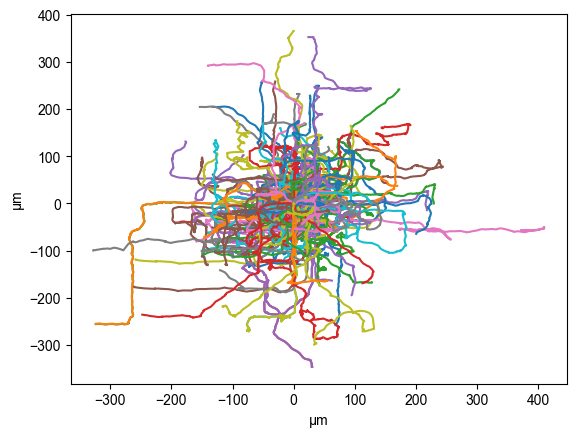

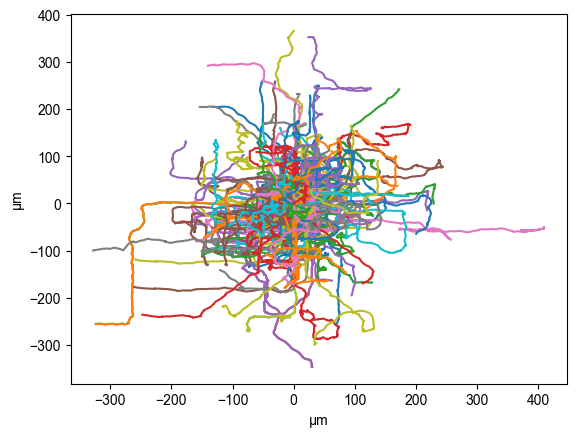

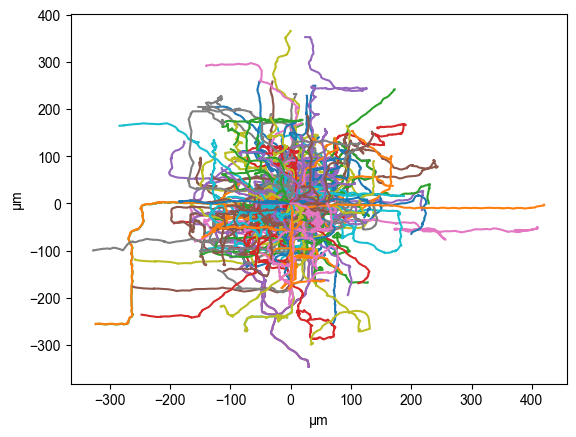

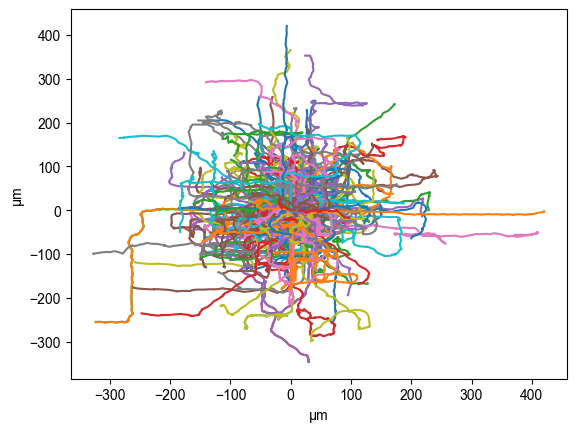

In [392]:
### Every 15 frames 

#Reference
#1.Construct a dictionary for data storage and analysis
datadic = {} #set up a data directory
dev = [] #number of device
pil= [] #number of confinement
dis = [] #number of disorders
rep = [] #number of repititions 
pixel_to_micron = 0.656 #pixel to micron (from Miles)
fps = 20 #frames per second
skip = 15

for file in files:
    
    curr_data = pd.read_csv(file)
    data = curr_data[['TRACK_ID','POSITION_X','POSITION_Y','POSITION_T']]
    grouped_df = data.groupby('TRACK_ID')
    # Filter out data with less spots
    minimum_spots = 160  # Replace this with a desired "minimum_spots" value
    filtered_df = grouped_df.filter(lambda group: len(group) >= minimum_spots)
    # Reindex the track IDs starting from 1
    filtered_df.reset_index(drop=True, inplace=True) #reindex the column starting from 0
    df = filtered_df.groupby('TRACK_ID', group_keys=True, as_index=False).apply(lambda x: x) #group the dataframe by TRACK_ID
    df.reset_index(level=0, inplace=True) #move the first level to a separate column
    df.rename(columns={'level_0': 'ID'}, inplace=True) #rename new level  
    track_names = df['ID'].unique().tolist()
    #print(df)
    
    device = file.split('-')[-5] #retrieve the strains used in each microfluidic device 
    pillar = file.split('-')[-4] #retrieve the specific confinement 
    disorder = file.split('-')[-3] #retrieve the specific disorder degree
    #repetition = file.split('-')[-1][:4] #the first four letter
    if device not in datadic:
        dev.extend([device])
        datadic[device] = {} 
    if pillar not in datadic[device]:
        if pillar not in pil:
            pil.extend([pillar])
        datadic[device][pillar] = {}
    if disorder not in datadic[device][pillar]:
        if disorder not in dis:
            dis.extend([disorder])
        datadic[device][pillar][disorder] = {}
        datadic[device][pillar][disorder]['time'] = []
        datadic[device][pillar][disorder]['rescaled_time'] = [] #Create a list to store all 'rescaled' time info
        datadic[device][pillar][disorder]['pos'] = []
        datadic[device][pillar][disorder]['rescaled_pos'] = [] #Create a list to store all 'rescaled' x and y info
        #datadic[device][pillar][disorder]['MSD'] = [[]]
        datadic[device][pillar][disorder]['reposition'] = []
        datadic[device][pillar][disorder]['angle_start'] = []
        
    for i in range(len(track_names)):
        time = np.array(df[df['ID']==track_names[i]]['POSITION_T'].tolist())
        time_start = time[0]        
       
        datadic[device][pillar][disorder]['time'].append(time)
        
        datadic[device][pillar][disorder]['rescaled_time'].append([(time[i]-time_start)/fps for i in range(len(time))]) #rescale the time as well based on fps
        x_pos = np.array(df[df['ID']==track_names[i]]['POSITION_X'].tolist())
        y_pos = np.array(df[df['ID']==track_names[i]]['POSITION_Y'].tolist())
        x_start = x_pos[0]
        y_start = y_pos[0] 
        datadic[device][pillar][disorder]['pos'].append([(x_pos[t]-x_start,y_pos[t]-y_start) for t in range(len(x_pos))])
        datadic[device][pillar][disorder]['rescaled_pos'].append([(pixel_to_micron*x_pos[t], pixel_to_micron*y_pos[t]) for t in range(len(x_pos))]) 
        datadic[device][pillar][disorder]['reposition'].append([(pixel_to_micron*(x_pos[t]-x_start), pixel_to_micron*(y_pos[t]-y_start)) for t in range(len(x_pos))])
        
        #compute the angles with respect to the same origin (0,0)
        angles = anglestart(x_pos,y_pos,x_start,y_start,pixel_to_micron,skip)
        datadic[device][pillar][disorder]['angle_start'].append(angles)
        
    #     Test whether the trajecories are stored properly           
    if device == 'dev1' and pillar == 'pil1' and disorder == 'dis1':
         for i in range(len(datadic[device][pillar][disorder]['reposition'])):
            path = np.array(datadic[device][pillar][disorder]['reposition'][i])
            plt.plot(*path.T) # ".T" attribute is used to transpose the array, swapping its rows and columns. # "*" unpacks the rows of the transposed array
            plt.xlabel('µm')
            plt.ylabel('µm')

    plt.show()
       

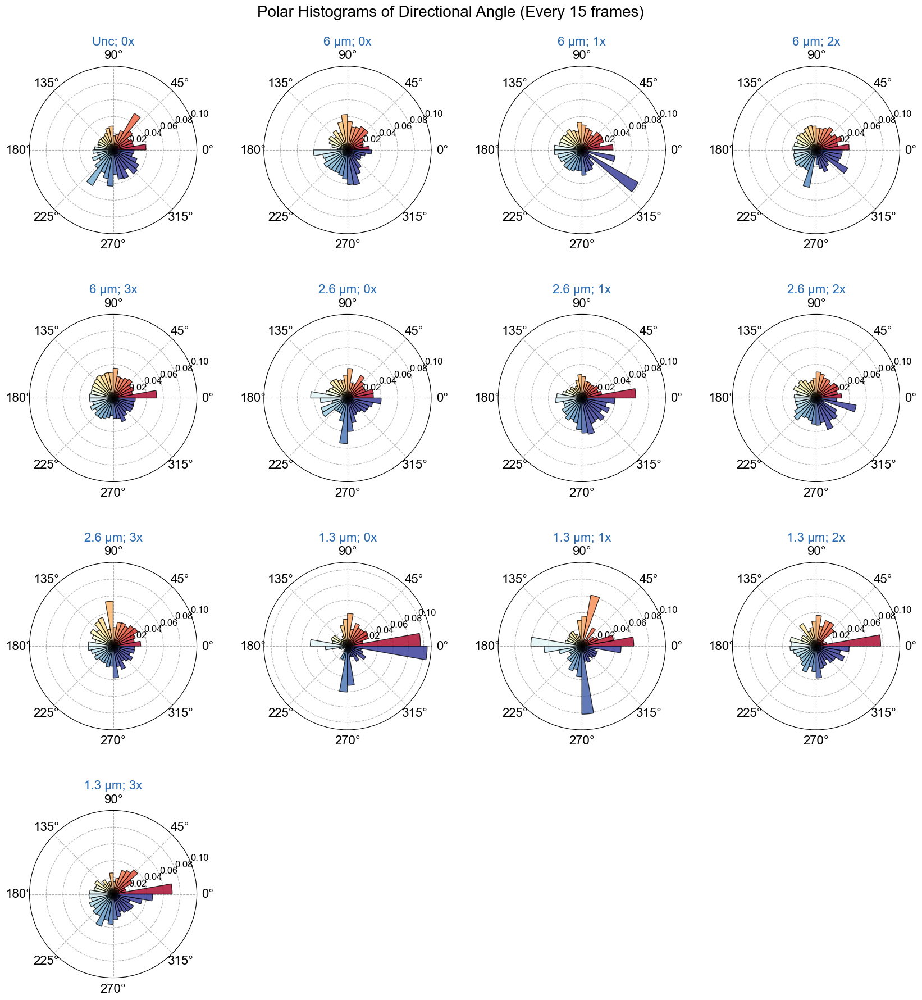

In [409]:
alpha = []

for dev in list(datadic):
    for pil in list(datadic[dev]):
        for dis in list(datadic[dev][pil]):
            alpha.extend([(pil, dis, angle) for angle in datadic[dev][pil][dis]['angle_start']])

df = pd.DataFrame(alpha,columns=['confinement', 'disorder', 'alpha'])

pillar_mapping = {'pil0': 'Unc', 'pil1': '6 µm', 'pil2': '2.6 µm', 'pil3': '1.3 µm'}
disorder_mapping = {'dis0': '0x', 'dis1': '0x', 'dis2': '1x', 
                    'dis3': '2x', 'dis4':'3x'}

# Replace the category names in the DataFrame
df['confinement'] = df['confinement'].replace(pillar_mapping)
df['disorder'] = df['disorder'].replace(disorder_mapping) 


#Merge the two columns to one 'condition' column
df['condition'] = df['confinement'] + '; ' + df['disorder']

df_exploded = df.explode('alpha')

#Every 15 frames

fig, axes = plt.subplots(nrows=4, ncols=4, subplot_kw=dict(projection="polar"), figsize=(20, 20))
fig.subplots_adjust(hspace=0.4, wspace=0.4)

for i, ax in enumerate(axes.flat):
    if i < len(condition):
        subset_df = df_exploded[df_exploded['condition'] == condition[i]]['alpha']
        
        # Define binning
        abins = np.linspace(0, 2*np.pi, 37)
        
        # Calculate histogram
        hist, bin_edges = np.histogram(subset_df, bins=abins)
        
        # Normalize histogram
        hist = hist / len(subset_df)
        
        # Create the bar plot on the polar axis
        bars = ax.bar(bin_edges[:-1], hist, width=(2*np.pi)/36, align='edge')
        ax.set_theta_zero_location("E")
        
        # Use custom colors and opacity
        for r, bar in zip(bin_edges[:-1], bars):
            bar.set_facecolor(plt.cm.RdYlBu(r / 5.))
            bar.set_edgecolor('black')
            bar.set_alpha(0.8)
            bar.set_zorder(2)
        
        # Change the size of the degree labels
        ax.tick_params(axis='x', labelsize=16)
        ax.tick_params(axis='y', labelsize=12)
        ax.set_yticks([0.02, 0.04,0.06,0.08,0.1])
        # Set grid style
        ax.grid(True, linestyle='dashed', zorder=1)
        ax.set_title(condition[i], color='xkcd:mid blue',fontsize=16)
    else:
        # Hide any extra subplots if the number of conditions is less than 16
        ax.axis('off')
fig.suptitle('Polar Histograms of Directional Angle (Every 15 frames)',fontsize=20)
fig.subplots_adjust(top=0.93)
plt.show()

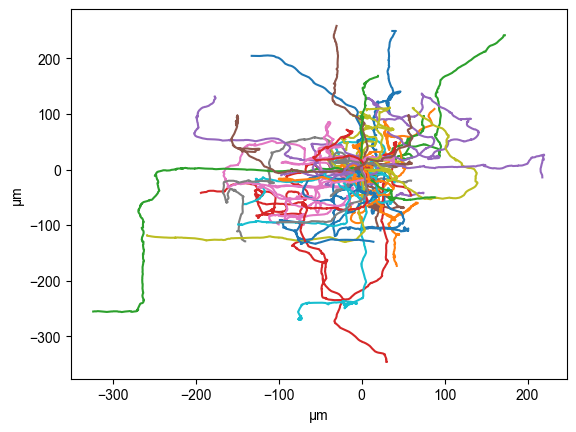

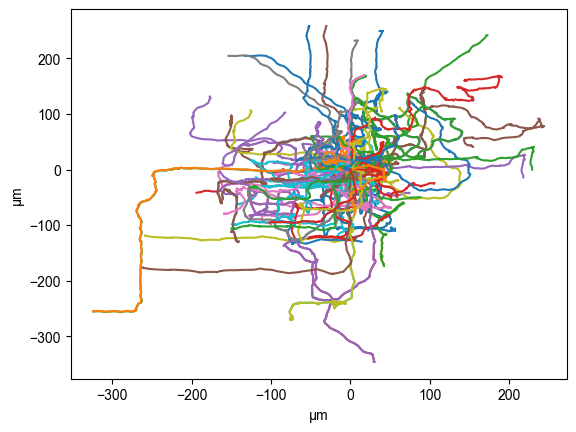

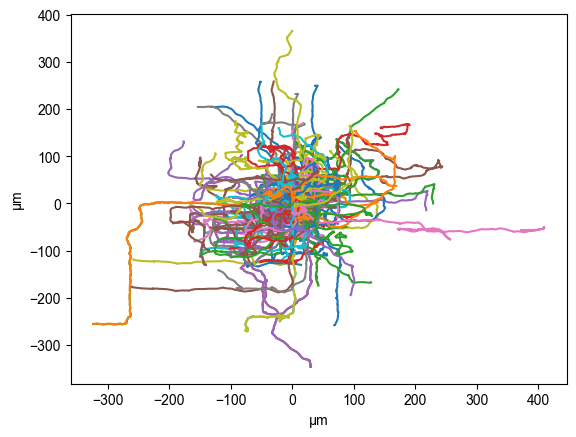

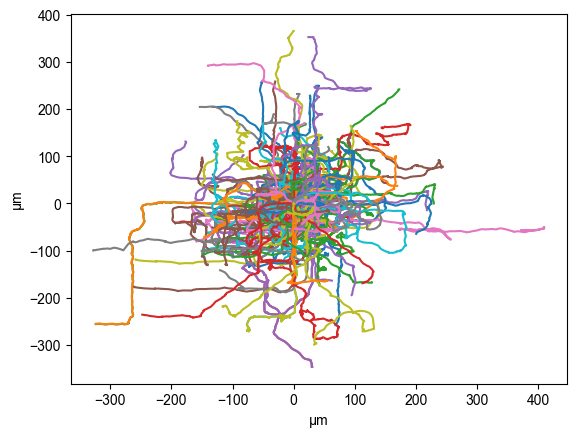

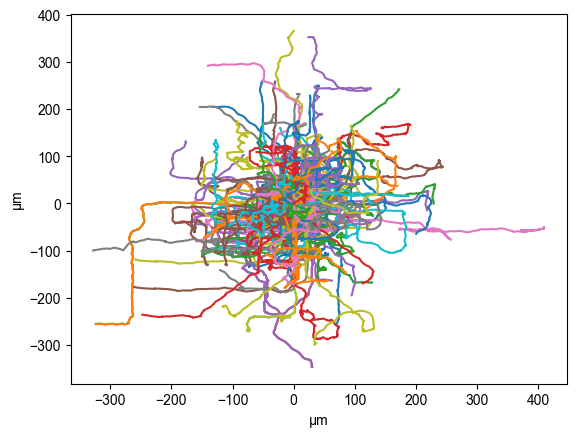

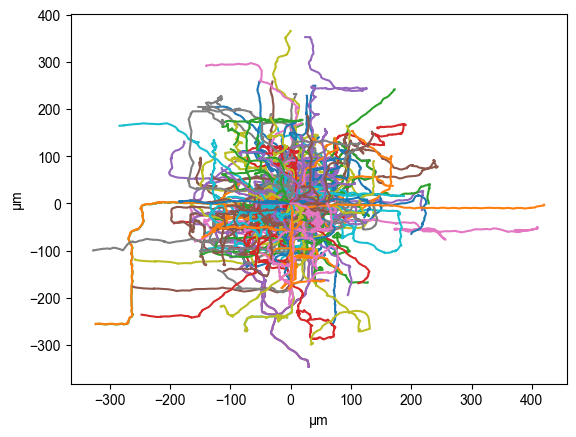

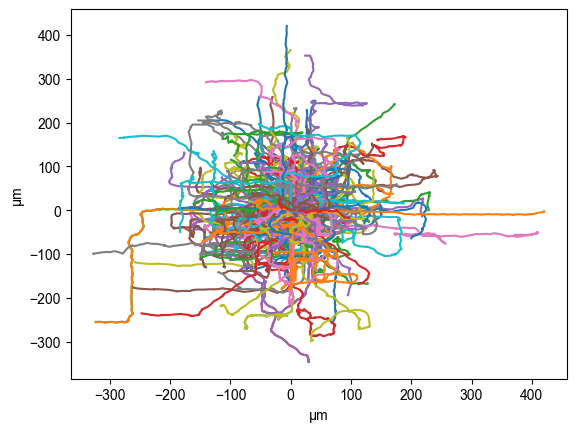

In [376]:
### Every 10 frames 

#Reference
#1.Construct a dictionary for data storage and analysis
datadic = {} #set up a data directory
dev = [] #number of device
pil= [] #number of confinement
dis = [] #number of disorders
rep = [] #number of repititions 
pixel_to_micron = 0.656 #pixel to micron (from Miles)
fps = 20 #frames per second
skip = 10

for file in files:
    
    curr_data = pd.read_csv(file)
    data = curr_data[['TRACK_ID','POSITION_X','POSITION_Y','POSITION_T']]
    grouped_df = data.groupby('TRACK_ID')
    # Filter out data with less spots
    minimum_spots = 160  # Replace this with a desired "minimum_spots" value
    filtered_df = grouped_df.filter(lambda group: len(group) >= minimum_spots)
    # Reindex the track IDs starting from 1
    filtered_df.reset_index(drop=True, inplace=True) #reindex the column starting from 0
    df = filtered_df.groupby('TRACK_ID', group_keys=True, as_index=False).apply(lambda x: x) #group the dataframe by TRACK_ID
    df.reset_index(level=0, inplace=True) #move the first level to a separate column
    df.rename(columns={'level_0': 'ID'}, inplace=True) #rename new level  
    track_names = df['ID'].unique().tolist()
    #print(df)
    
    device = file.split('-')[-5] #retrieve the strains used in each microfluidic device 
    pillar = file.split('-')[-4] #retrieve the specific confinement 
    disorder = file.split('-')[-3] #retrieve the specific disorder degree
    #repetition = file.split('-')[-1][:4] #the first four letter
    if device not in datadic:
        dev.extend([device])
        datadic[device] = {} 
    if pillar not in datadic[device]:
        if pillar not in pil:
            pil.extend([pillar])
        datadic[device][pillar] = {}
    if disorder not in datadic[device][pillar]:
        if disorder not in dis:
            dis.extend([disorder])
        datadic[device][pillar][disorder] = {}
        datadic[device][pillar][disorder]['time'] = []
        datadic[device][pillar][disorder]['rescaled_time'] = [] #Create a list to store all 'rescaled' time info
        datadic[device][pillar][disorder]['pos'] = []
        datadic[device][pillar][disorder]['rescaled_pos'] = [] #Create a list to store all 'rescaled' x and y info
        #datadic[device][pillar][disorder]['MSD'] = [[]]
        datadic[device][pillar][disorder]['reposition'] = []
        datadic[device][pillar][disorder]['angle_start'] = []
        
    for i in range(len(track_names)):
        time = np.array(df[df['ID']==track_names[i]]['POSITION_T'].tolist())
        time_start = time[0]        
       
        datadic[device][pillar][disorder]['time'].append(time)
        
        datadic[device][pillar][disorder]['rescaled_time'].append([(time[i]-time_start)/fps for i in range(len(time))]) #rescale the time as well based on fps
        x_pos = np.array(df[df['ID']==track_names[i]]['POSITION_X'].tolist())
        y_pos = np.array(df[df['ID']==track_names[i]]['POSITION_Y'].tolist())
        x_start = x_pos[0]
        y_start = y_pos[0] 
        datadic[device][pillar][disorder]['pos'].append([(x_pos[t]-x_start,y_pos[t]-y_start) for t in range(len(x_pos))])
        datadic[device][pillar][disorder]['rescaled_pos'].append([(pixel_to_micron*x_pos[t], pixel_to_micron*y_pos[t]) for t in range(len(x_pos))]) 
        datadic[device][pillar][disorder]['reposition'].append([(pixel_to_micron*(x_pos[t]-x_start), pixel_to_micron*(y_pos[t]-y_start)) for t in range(len(x_pos))])
        
        #compute the angles with respect to the same origin (0,0)
        angles = anglestart(x_pos,y_pos,x_start,y_start,pixel_to_micron,skip)
        datadic[device][pillar][disorder]['angle_start'].append(angles)
        
    #     Test whether the trajecories are stored properly           
    if device == 'dev1' and pillar == 'pil1' and disorder == 'dis1':
         for i in range(len(datadic[device][pillar][disorder]['reposition'])):
            path = np.array(datadic[device][pillar][disorder]['reposition'][i])
            plt.plot(*path.T) # ".T" attribute is used to transpose the array, swapping its rows and columns. # "*" unpacks the rows of the transposed array
            plt.xlabel('µm')
            plt.ylabel('µm')

    plt.show()
       

In [377]:
alpha = []

for dev in list(datadic):
    for pil in list(datadic[dev]):
        for dis in list(datadic[dev][pil]):
            alpha.extend([(pil, dis, angle) for angle in datadic[dev][pil][dis]['angle_start']])

df = pd.DataFrame(alpha,columns=['confinement', 'disorder', 'alpha'])

pillar_mapping = {'pil0': 'Unc', 'pil1': '6 µm', 'pil2': '2.6 µm', 'pil3': '1.3 µm'}
disorder_mapping = {'dis0': '0x', 'dis1': '0x', 'dis2': '1x', 
                    'dis3': '2x', 'dis4':'3x'}

# Replace the category names in the DataFrame
df['confinement'] = df['confinement'].replace(pillar_mapping)
df['disorder'] = df['disorder'].replace(disorder_mapping) 


#Merge the two columns to one 'condition' column
df['condition'] = df['confinement'] + '; ' + df['disorder']

df_exploded = df.explode('alpha')
df_exploded

,confinement,disorder,alpha,condition
0,Unc,0x,NaN,Unc; 0x
0,Unc,0x,3.141593,Unc; 0x
0,Unc,0x,2.59349,Unc; 0x
0,Unc,0x,2.52882,Unc; 0x
0,Unc,0x,2.56227,Unc; 0x
...,...,...,...,...
4100,1.3 µm,3x,2.477234,1.3 µm; 3x
4100,1.3 µm,3x,2.531625,1.3 µm; 3x
4100,1.3 µm,3x,2.481418,1.3 µm; 3x
4100,1.3 µm,3x,2.50025,1.3 µm; 3x


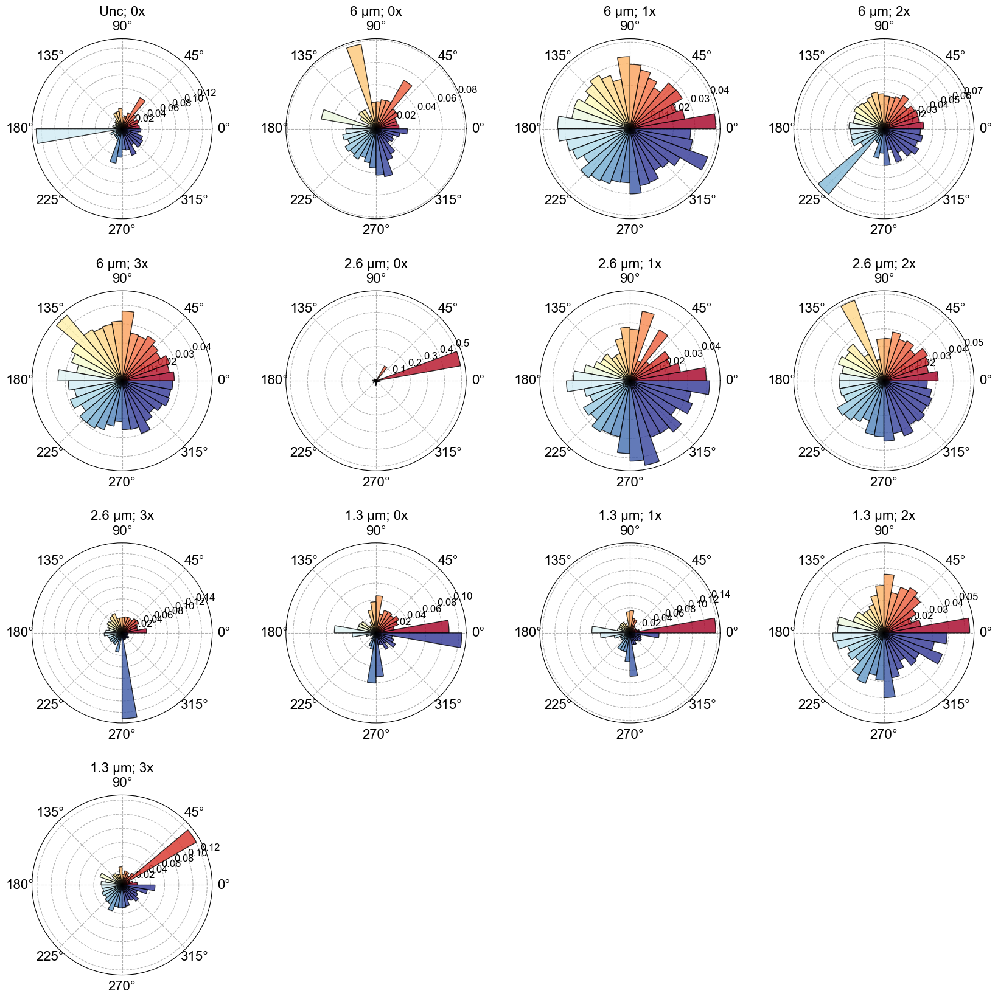

In [378]:
#Every 10 frames

fig, axes = plt.subplots(nrows=4, ncols=4, subplot_kw=dict(projection="polar"), figsize=(20, 20))
fig.subplots_adjust(hspace=0.4, wspace=0.4)

for i, ax in enumerate(axes.flat):
    if i < len(condition):
        subset_df = df_exploded[df_exploded['condition'] == condition[i]]['alpha']
        
        # Define binning
        abins = np.linspace(0, 2*np.pi, 37)
        
        # Calculate histogram
        hist, bin_edges = np.histogram(subset_df, bins=abins)
        
        # Normalize histogram
        hist = hist / len(subset_df)
        
        # Create the bar plot on the polar axis
        bars = ax.bar(bin_edges[:-1], hist, width=(2*np.pi)/36, align='edge')
        ax.set_theta_zero_location("E")
        
        # Use custom colors and opacity
        for r, bar in zip(bin_edges[:-1], bars):
            bar.set_facecolor(plt.cm.RdYlBu(r / 5.))
            bar.set_edgecolor('black')
            bar.set_alpha(0.8)
            bar.set_zorder(2)
        
        # Change the size of the degree labels
        ax.tick_params(axis='x', labelsize=16)
        ax.tick_params(axis='y', labelsize=12)
        
        # Set grid style
        ax.grid(True, linestyle='dashed', zorder=1)
        ax.set_title(condition[i], fontsize=16)
    else:
        # Hide any extra subplots if the number of conditions is less than 16
        ax.axis('off')

plt.show()

In [ ]:
### Every 5 frames

#Reference
#1.Construct a dictionary for data storage and analysis
datadic = {} #set up a data directory
dev = [] #number of device
pil= [] #number of confinement
dis = [] #number of disorders
rep = [] #number of repititions 
pixel_to_micron = 0.656 #pixel to micron (from Miles)
fps = 20 #frames per second
skip = 5

for file in files:
    
    curr_data = pd.read_csv(file)
    data = curr_data[['TRACK_ID','POSITION_X','POSITION_Y','POSITION_T']]
    grouped_df = data.groupby('TRACK_ID')
    # Filter out data with less spots
    minimum_spots = 160  # Replace this with a desired "minimum_spots" value
    filtered_df = grouped_df.filter(lambda group: len(group) >= minimum_spots)
    # Reindex the track IDs starting from 1
    filtered_df.reset_index(drop=True, inplace=True) #reindex the column starting from 0
    df = filtered_df.groupby('TRACK_ID', group_keys=True, as_index=False).apply(lambda x: x) #group the dataframe by TRACK_ID
    df.reset_index(level=0, inplace=True) #move the first level to a separate column
    df.rename(columns={'level_0': 'ID'}, inplace=True) #rename new level  
    track_names = df['ID'].unique().tolist()
    #print(df)
    
    device = file.split('-')[-5] #retrieve the strains used in each microfluidic device 
    pillar = file.split('-')[-4] #retrieve the specific confinement 
    disorder = file.split('-')[-3] #retrieve the specific disorder degree
    #repetition = file.split('-')[-1][:4] #the first four letter
    if device not in datadic:
        dev.extend([device])
        datadic[device] = {} 
    if pillar not in datadic[device]:
        if pillar not in pil:
            pil.extend([pillar])
        datadic[device][pillar] = {}
    if disorder not in datadic[device][pillar]:
        if disorder not in dis:
            dis.extend([disorder])
        datadic[device][pillar][disorder] = {}
        datadic[device][pillar][disorder]['time'] = []
        datadic[device][pillar][disorder]['rescaled_time'] = [] #Create a list to store all 'rescaled' time info
        datadic[device][pillar][disorder]['pos'] = []
        datadic[device][pillar][disorder]['rescaled_pos'] = [] #Create a list to store all 'rescaled' x and y info
        #datadic[device][pillar][disorder]['MSD'] = [[]]
        datadic[device][pillar][disorder]['reposition'] = []
        datadic[device][pillar][disorder]['angle_start'] = []
        
    for i in range(len(track_names)):
        time = np.array(df[df['ID']==track_names[i]]['POSITION_T'].tolist())
        time_start = time[0]        
       
        datadic[device][pillar][disorder]['time'].append(time)
        
        datadic[device][pillar][disorder]['rescaled_time'].append([(time[i]-time_start)/fps for i in range(len(time))]) #rescale the time as well based on fps
        x_pos = np.array(df[df['ID']==track_names[i]]['POSITION_X'].tolist())
        y_pos = np.array(df[df['ID']==track_names[i]]['POSITION_Y'].tolist())
        x_start = x_pos[0]
        y_start = y_pos[0] 
        datadic[device][pillar][disorder]['pos'].append([(x_pos[t]-x_start,y_pos[t]-y_start) for t in range(len(x_pos))])
        datadic[device][pillar][disorder]['rescaled_pos'].append([(pixel_to_micron*x_pos[t], pixel_to_micron*y_pos[t]) for t in range(len(x_pos))]) 
        datadic[device][pillar][disorder]['reposition'].append([(pixel_to_micron*(x_pos[t]-x_start), pixel_to_micron*(y_pos[t]-y_start)) for t in range(len(x_pos))])
        
        #compute the angles with respect to the same origin (0,0)
        angles = anglestart(x_pos,y_pos,x_start,y_start,pixel_to_micron,skip)
        datadic[device][pillar][disorder]['angle_start'].append(angles)
        
    #     Test whether the trajecories are stored properly           
    if device == 'dev1' and pillar == 'pil1' and disorder == 'dis1':
         for i in range(len(datadic[device][pillar][disorder]['reposition'])):
            path = np.array(datadic[device][pillar][disorder]['reposition'][i])
            plt.plot(*path.T) # ".T" attribute is used to transpose the array, swapping its rows and columns. # "*" unpacks the rows of the transposed array
            plt.xlabel('µm')
            plt.ylabel('µm')

    plt.show()
       

In [382]:
alpha = []

for dev in list(datadic):
    for pil in list(datadic[dev]):
        for dis in list(datadic[dev][pil]):
            alpha.extend([(pil, dis, angle) for angle in datadic[dev][pil][dis]['angle_start']])

df = pd.DataFrame(alpha,columns=['confinement', 'disorder', 'alpha'])

pillar_mapping = {'pil0': 'Unc', 'pil1': '6 µm', 'pil2': '2.6 µm', 'pil3': '1.3 µm'}
disorder_mapping = {'dis0': '0x', 'dis1': '0x', 'dis2': '1x', 
                    'dis3': '2x', 'dis4':'3x'}

# Replace the category names in the DataFrame
df['confinement'] = df['confinement'].replace(pillar_mapping)
df['disorder'] = df['disorder'].replace(disorder_mapping) 


#Merge the two columns to one 'condition' column
df['condition'] = df['confinement'] + '; ' + df['disorder']

df_exploded = df.explode('alpha')
df_exploded

,confinement,disorder,alpha,condition
0,Unc,0x,NaN,Unc; 0x
0,Unc,0x,3.141593,Unc; 0x
0,Unc,0x,3.141593,Unc; 0x
0,Unc,0x,2.681665,Unc; 0x
0,Unc,0x,2.59349,Unc; 0x
...,...,...,...,...
4100,1.3 µm,3x,2.481418,1.3 µm; 3x
4100,1.3 µm,3x,2.525844,1.3 µm; 3x
4100,1.3 µm,3x,2.50025,1.3 µm; 3x
4100,1.3 µm,3x,2.467836,1.3 µm; 3x


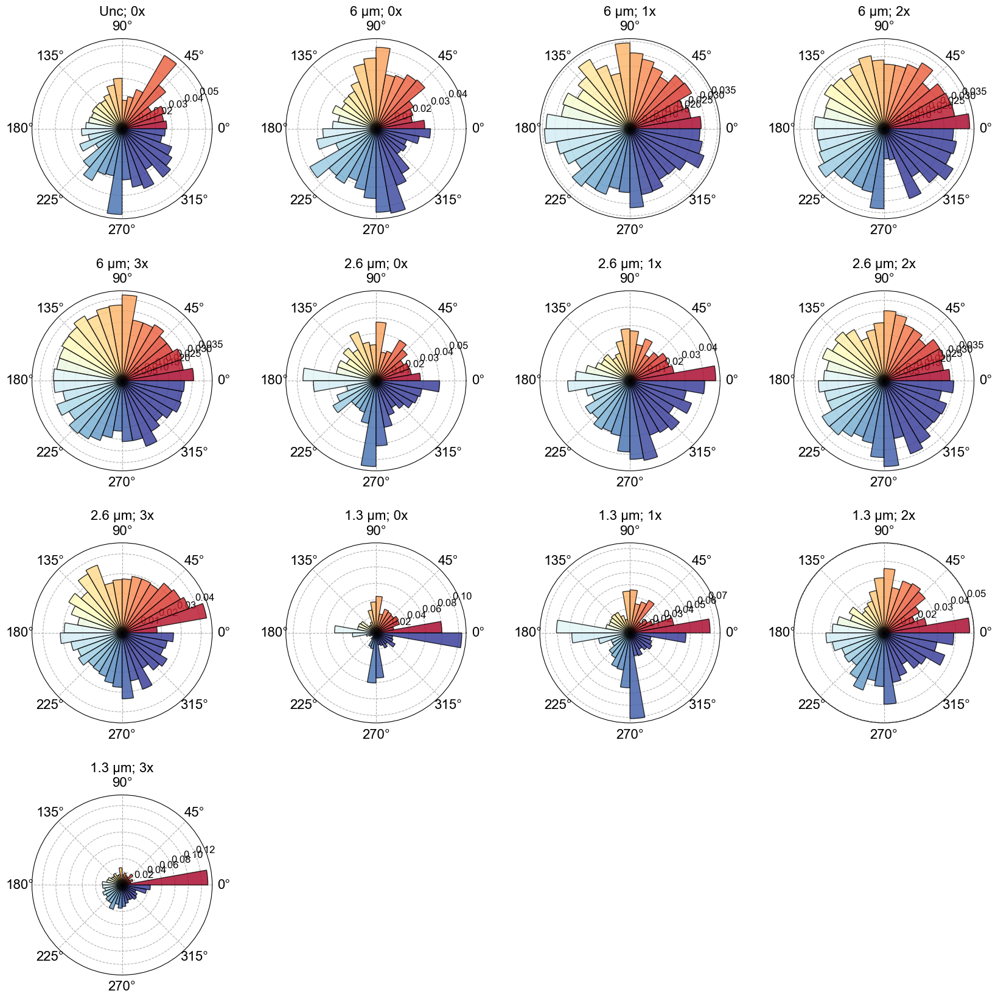

In [383]:
#Every 5 frames

fig, axes = plt.subplots(nrows=4, ncols=4, subplot_kw=dict(projection="polar"), figsize=(20, 20))
fig.subplots_adjust(hspace=0.4, wspace=0.4)

for i, ax in enumerate(axes.flat):
    if i < len(condition):
        subset_df = df_exploded[df_exploded['condition'] == condition[i]]['alpha']
        
        # Define binning
        abins = np.linspace(0, 2*np.pi, 37)
        
        # Calculate histogram
        hist, bin_edges = np.histogram(subset_df, bins=abins)
        
        # Normalize histogram
        hist = hist / len(subset_df)
        
        # Create the bar plot on the polar axis
        bars = ax.bar(bin_edges[:-1], hist, width=(2*np.pi)/36, align='edge')
        ax.set_theta_zero_location("E")
        
        # Use custom colors and opacity
        for r, bar in zip(bin_edges[:-1], bars):
            bar.set_facecolor(plt.cm.RdYlBu(r / 5.))
            bar.set_edgecolor('black')
            bar.set_alpha(0.8)
            bar.set_zorder(2)
        
        # Change the size of the degree labels
        ax.tick_params(axis='x', labelsize=16)
        ax.tick_params(axis='y', labelsize=12)
        
        # Set grid style
        ax.grid(True, linestyle='dashed', zorder=1)
        ax.set_title(condition[i], fontsize=16)
    else:
        # Hide any extra subplots if the number of conditions is less than 16
        ax.axis('off')

plt.show()

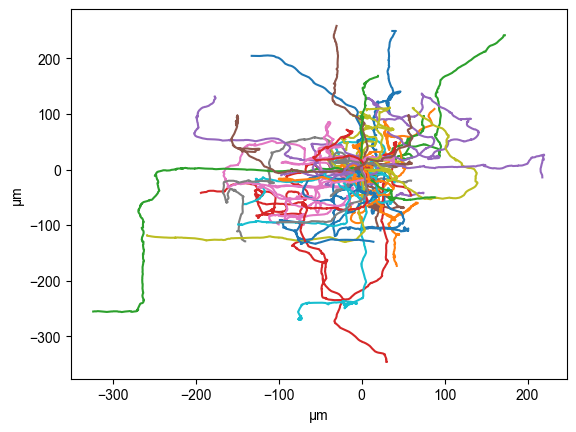

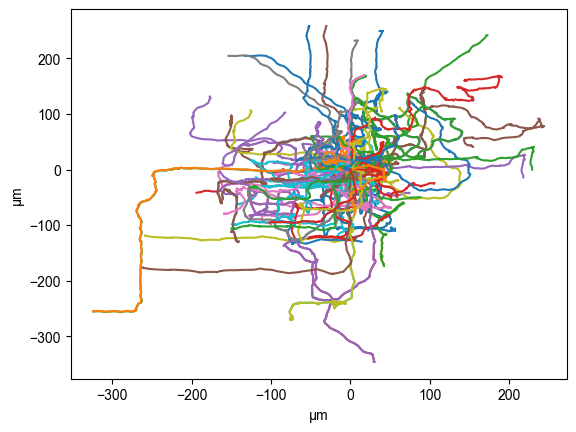

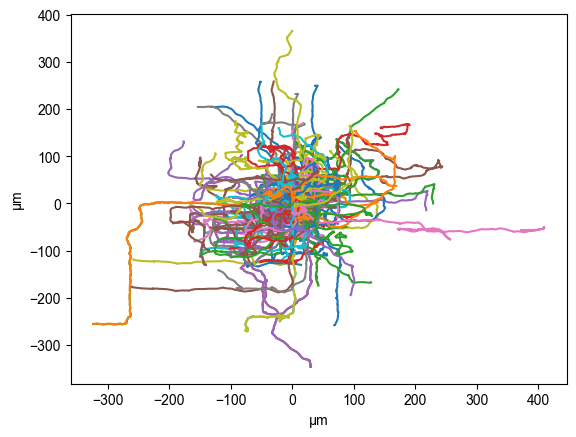

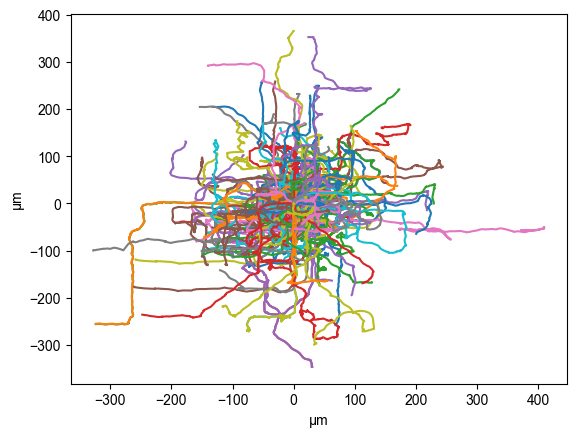

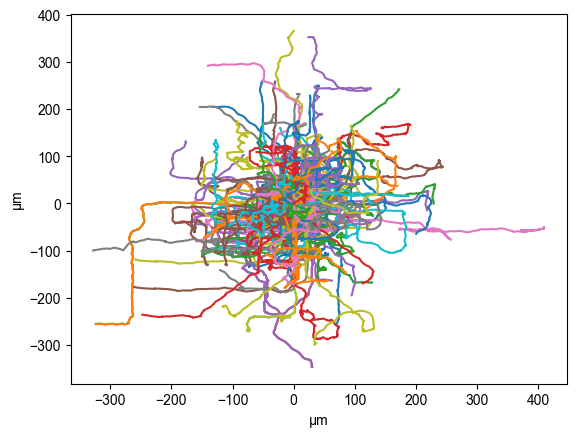

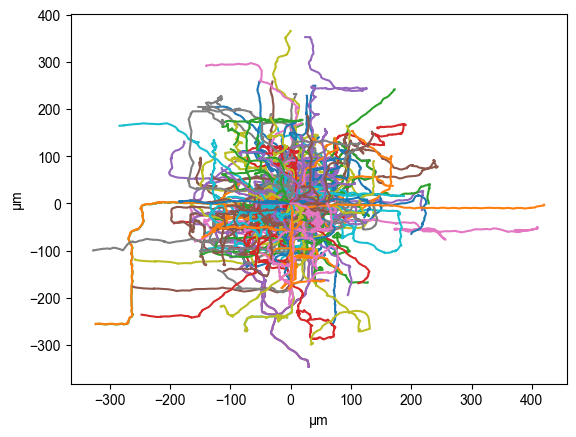

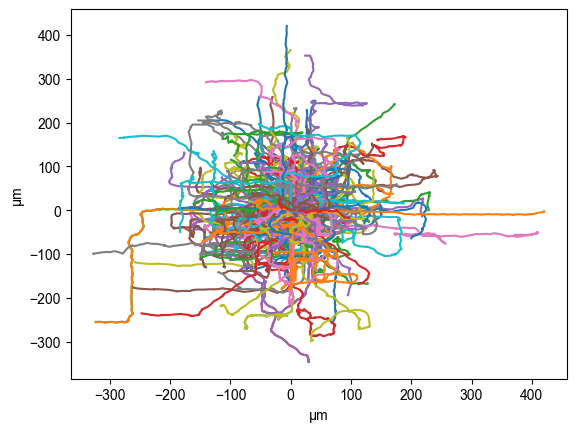

In [384]:
### Every 3 frames

#Reference
#1.Construct a dictionary for data storage and analysis
datadic = {} #set up a data directory
dev = [] #number of device
pil= [] #number of confinement
dis = [] #number of disorders
rep = [] #number of repititions 
pixel_to_micron = 0.656 #pixel to micron (from Miles)
fps = 20 #frames per second
skip = 3

for file in files:
    
    curr_data = pd.read_csv(file)
    data = curr_data[['TRACK_ID','POSITION_X','POSITION_Y','POSITION_T']]
    grouped_df = data.groupby('TRACK_ID')
    # Filter out data with less spots
    minimum_spots = 160  # Replace this with a desired "minimum_spots" value
    filtered_df = grouped_df.filter(lambda group: len(group) >= minimum_spots)
    # Reindex the track IDs starting from 1
    filtered_df.reset_index(drop=True, inplace=True) #reindex the column starting from 0
    df = filtered_df.groupby('TRACK_ID', group_keys=True, as_index=False).apply(lambda x: x) #group the dataframe by TRACK_ID
    df.reset_index(level=0, inplace=True) #move the first level to a separate column
    df.rename(columns={'level_0': 'ID'}, inplace=True) #rename new level  
    track_names = df['ID'].unique().tolist()
    #print(df)
    
    device = file.split('-')[-5] #retrieve the strains used in each microfluidic device 
    pillar = file.split('-')[-4] #retrieve the specific confinement 
    disorder = file.split('-')[-3] #retrieve the specific disorder degree
    #repetition = file.split('-')[-1][:4] #the first four letter
    if device not in datadic:
        dev.extend([device])
        datadic[device] = {} 
    if pillar not in datadic[device]:
        if pillar not in pil:
            pil.extend([pillar])
        datadic[device][pillar] = {}
    if disorder not in datadic[device][pillar]:
        if disorder not in dis:
            dis.extend([disorder])
        datadic[device][pillar][disorder] = {}
        datadic[device][pillar][disorder]['time'] = []
        datadic[device][pillar][disorder]['rescaled_time'] = [] #Create a list to store all 'rescaled' time info
        datadic[device][pillar][disorder]['pos'] = []
        datadic[device][pillar][disorder]['rescaled_pos'] = [] #Create a list to store all 'rescaled' x and y info
        #datadic[device][pillar][disorder]['MSD'] = [[]]
        datadic[device][pillar][disorder]['reposition'] = []
        datadic[device][pillar][disorder]['angle_start'] = []
        
    for i in range(len(track_names)):
        time = np.array(df[df['ID']==track_names[i]]['POSITION_T'].tolist())
        time_start = time[0]        
       
        datadic[device][pillar][disorder]['time'].append(time)
        
        datadic[device][pillar][disorder]['rescaled_time'].append([(time[i]-time_start)/fps for i in range(len(time))]) #rescale the time as well based on fps
        x_pos = np.array(df[df['ID']==track_names[i]]['POSITION_X'].tolist())
        y_pos = np.array(df[df['ID']==track_names[i]]['POSITION_Y'].tolist())
        x_start = x_pos[0]
        y_start = y_pos[0] 
        datadic[device][pillar][disorder]['pos'].append([(x_pos[t]-x_start,y_pos[t]-y_start) for t in range(len(x_pos))])
        datadic[device][pillar][disorder]['rescaled_pos'].append([(pixel_to_micron*x_pos[t], pixel_to_micron*y_pos[t]) for t in range(len(x_pos))]) 
        datadic[device][pillar][disorder]['reposition'].append([(pixel_to_micron*(x_pos[t]-x_start), pixel_to_micron*(y_pos[t]-y_start)) for t in range(len(x_pos))])
        
        #compute the angles with respect to the same origin (0,0)
        angles = anglestart(x_pos,y_pos,x_start,y_start,pixel_to_micron,skip)
        datadic[device][pillar][disorder]['angle_start'].append(angles)
        
    #     Test whether the trajecories are stored properly           
    if device == 'dev1' and pillar == 'pil1' and disorder == 'dis1':
         for i in range(len(datadic[device][pillar][disorder]['reposition'])):
            path = np.array(datadic[device][pillar][disorder]['reposition'][i])
            plt.plot(*path.T) # ".T" attribute is used to transpose the array, swapping its rows and columns. # "*" unpacks the rows of the transposed array
            plt.xlabel('µm')
            plt.ylabel('µm')

    plt.show()
       

In [385]:
alpha = []

for dev in list(datadic):
    for pil in list(datadic[dev]):
        for dis in list(datadic[dev][pil]):
            alpha.extend([(pil, dis, angle) for angle in datadic[dev][pil][dis]['angle_start']])

df = pd.DataFrame(alpha,columns=['confinement', 'disorder', 'alpha'])

pillar_mapping = {'pil0': 'Unc', 'pil1': '6 µm', 'pil2': '2.6 µm', 'pil3': '1.3 µm'}
disorder_mapping = {'dis0': '0x', 'dis1': '0x', 'dis2': '1x', 
                    'dis3': '2x', 'dis4':'3x'}

# Replace the category names in the DataFrame
df['confinement'] = df['confinement'].replace(pillar_mapping)
df['disorder'] = df['disorder'].replace(disorder_mapping) 


#Merge the two columns to one 'condition' column
df['condition'] = df['confinement'] + '; ' + df['disorder']

df_exploded = df.explode('alpha')
df_exploded

,confinement,disorder,alpha,condition
0,Unc,0x,NaN,Unc; 0x
0,Unc,0x,3.141593,Unc; 0x
0,Unc,0x,3.141593,Unc; 0x
0,Unc,0x,3.141593,Unc; 0x
0,Unc,0x,3.141593,Unc; 0x
...,...,...,...,...
4100,1.3 µm,3x,2.50025,1.3 µm; 3x
4100,1.3 µm,3x,2.476572,1.3 µm; 3x
4100,1.3 µm,3x,2.480102,1.3 µm; 3x
4100,1.3 µm,3x,2.474892,1.3 µm; 3x


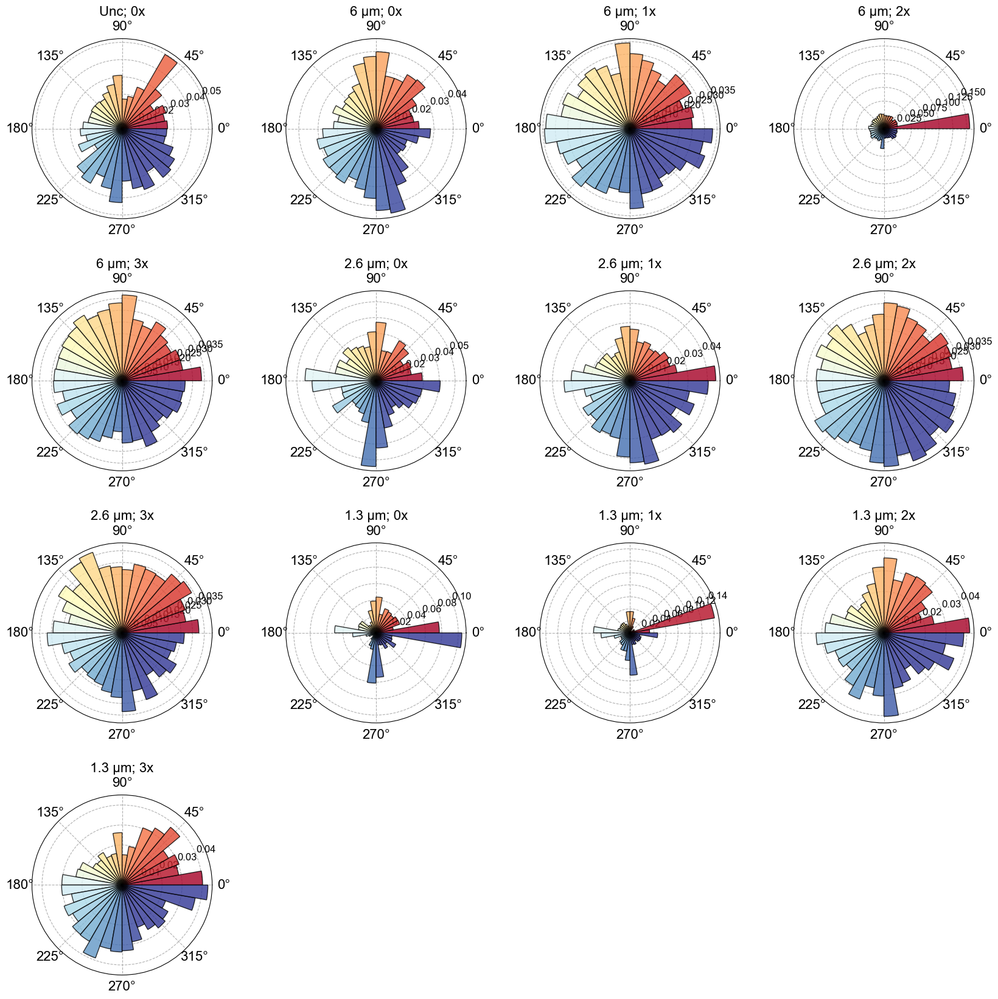

In [388]:
#Every 3 frames

fig, axes = plt.subplots(nrows=4, ncols=4, subplot_kw=dict(projection="polar"), figsize=(20, 20))
fig.subplots_adjust(hspace=0.4, wspace=0.4)

for i, ax in enumerate(axes.flat):
    if i < len(condition):
        subset_df = df_exploded[df_exploded['condition'] == condition[i]]['alpha']
        
        # Define binning
        abins = np.linspace(0, 2*np.pi, 37)
        
        # Calculate histogram
        hist, bin_edges = np.histogram(subset_df, bins=abins)
        
        # Normalize histogram
        hist = hist / (len(subset_df))
        
        # Create the bar plot on the polar axis
        bars = ax.bar(bin_edges[:-1], hist, width=(2*np.pi)/36, align='edge')
        ax.set_theta_zero_location("E")
        
        # Use custom colors and opacity
        for r, bar in zip(bin_edges[:-1], bars):
            bar.set_facecolor(plt.cm.RdYlBu(r / 5.))
            bar.set_edgecolor('black')
            bar.set_alpha(0.8)
            bar.set_zorder(2)
        
        # Change the size of the degree labels
        ax.tick_params(axis='x', labelsize=16)
        ax.tick_params(axis='y', labelsize=12)
        
        # Set grid style
        ax.grid(True, linestyle='dashed', zorder=1)
        ax.set_title(condition[i], fontsize=16)
    else:
        # Hide any extra subplots if the number of conditions is less than 16
        ax.axis('off')

plt.show()

### Sliding window = 10 (overlap 50%)

In [530]:
#1.Construct a dictionary for data storage and analysis
datadic = {} #set up a data directory
dev = [] #number of device
pil= [] #number of confinement
dis = [] #number of disorders
rep = [] #number of repititions 
pixel_to_micron = 0.656 #pixel to micron (from Miles)
fps = 20 #frames per second
skip = 1
window_size =5
overlap = 4

for file in files:
    
    curr_data = pd.read_csv(file)
    data = curr_data[['TRACK_ID','POSITION_X','POSITION_Y','POSITION_T']]
    grouped_df = data.groupby('TRACK_ID')
    # Filter out data with less spots
    minimum_spots = 160  # Replace this with a desired "minimum_spots" value
    filtered_df = grouped_df.filter(lambda group: len(group) >= minimum_spots)
    # Reindex the track IDs starting from 1
    filtered_df.reset_index(drop=True, inplace=True) #reindex the column starting from 0
    df = filtered_df.groupby('TRACK_ID', group_keys=True, as_index=False).apply(lambda x: x) #group the dataframe by TRACK_ID
    df.reset_index(level=0, inplace=True) #move the first level to a separate column
    df.rename(columns={'level_0': 'ID'}, inplace=True) #rename new level  
    track_names = df['ID'].unique().tolist()
    #print(df)
    
    device = file.split('-')[-5] #retrieve the strains used in each microfluidic device 
    pillar = file.split('-')[-4] #retrieve the specific confinement 
    disorder = file.split('-')[-3] #retrieve the specific disorder degree
    #repetition = file.split('-')[-1][:4] #the first four letter
    if device not in datadic:
        dev.extend([device])
        datadic[device] = {} 
    if pillar not in datadic[device]:
        if pillar not in pil:
            pil.extend([pillar])
        datadic[device][pillar] = {}
    if disorder not in datadic[device][pillar]:
        if disorder not in dis:
            dis.extend([disorder])
        datadic[device][pillar][disorder] = {}
        datadic[device][pillar][disorder]['time'] = []
        datadic[device][pillar][disorder]['rescaled_time'] = [] #Create a list to store all 'rescaled' time info
        datadic[device][pillar][disorder]['pos'] = []
        datadic[device][pillar][disorder]['rescaled_pos'] = [] #Create a list to store all 'rescaled' x and y info
        #datadic[device][pillar][disorder]['MSD'] = [[]]
        datadic[device][pillar][disorder]['reposition'] = []
        datadic[device][pillar][disorder]['angle_start'] = []
        
    for i in range(len(track_names)):
        time = np.array(df[df['ID']==track_names[i]]['POSITION_T'].tolist())
        time_start = time[0]        
       
        datadic[device][pillar][disorder]['time'].append(time)
        
        datadic[device][pillar][disorder]['rescaled_time'].append([(time[i]-time_start)/fps for i in range(len(time))]) #rescale the time as well based on fps
        x_pos = np.array(df[df['ID']==track_names[i]]['POSITION_X'].tolist())
        y_pos = np.array(df[df['ID']==track_names[i]]['POSITION_Y'].tolist())
        x_start = x_pos[0]
        y_start = y_pos[0] 
        datadic[device][pillar][disorder]['pos'].append([(x_pos[t]-x_start,y_pos[t]-y_start) for t in range(len(x_pos))])
        datadic[device][pillar][disorder]['rescaled_pos'].append([(pixel_to_micron*x_pos[t], pixel_to_micron*y_pos[t]) for t in range(len(x_pos))]) 
        datadic[device][pillar][disorder]['reposition'].append([(pixel_to_micron*(x_pos[t]-x_start), pixel_to_micron*(y_pos[t]-y_start)) for t in range(len(x_pos))])
        
        #compute the angles with respect to the same origin (0,0)
        angles = anglestart(x_pos,y_pos,x_start,y_start,pixel_to_micron,skip)[1:]
        angle_sl = sliding_window(angles,window_size,overlap)
        datadic[device][pillar][disorder]['angle_start'].append(angle_sl)
        
    #     Test whether the trajecories are stored properly           
#     if device == 'dev1' and pillar == 'pil1' and disorder == 'dis1':
#          for i in range(len(datadic[device][pillar][disorder]['reposition'])):
#             path = np.array(datadic[device][pillar][disorder]['reposition'][i])
#             plt.plot(*path.T) # ".T" attribute is used to transpose the array, swapping its rows and columns. # "*" unpacks the rows of the transposed array
#             plt.xlabel('µm')
#             plt.ylabel('µm')

#     plt.show()

36
37
36
37
36
37
36
37
36
37
36
37
36
37
36
37
36
37
36
37
36
37
36
37
36
37


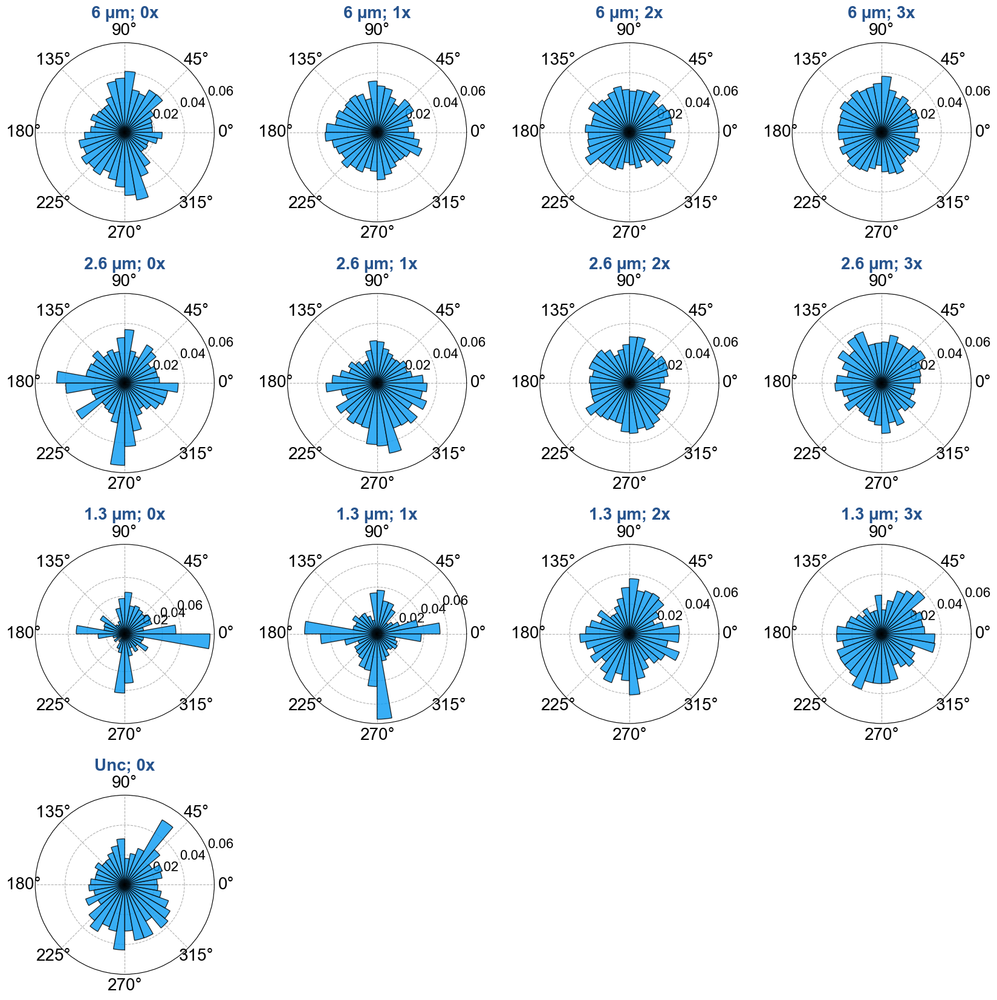

In [577]:
alpha = []

for dev in datadic.keys():
    for pil in datadic[dev].keys():
        for dis in datadic[dev][pil].keys():
            alpha.extend([(pil, dis, angle) for angle in datadic[dev][pil][dis]['angle_start']])

df = pd.DataFrame(alpha,columns=['confinement', 'disorder', 'alpha'])

pillar_mapping = {'pil0': 'Unc', 'pil1': '6 µm', 'pil2': '2.6 µm', 'pil3': '1.3 µm'}
disorder_mapping = {'dis0': '0x', 'dis1': '0x', 'dis2': '1x', 
                    'dis3': '2x', 'dis4':'3x'}

# Replace the category names in the DataFrame
df['confinement'] = df['confinement'].replace(pillar_mapping)
df['disorder'] = df['disorder'].replace(disorder_mapping) 


#Merge the two columns to one 'condition' column
df['condition'] = df['confinement'] + '; ' + df['disorder']

df_exploded = df.explode('alpha')


fig, axes = plt.subplots(nrows=4, ncols=4, subplot_kw=dict(projection="polar"), figsize=(20, 20))
fig.subplots_adjust(hspace=0.4, wspace=0.4)

for i, ax in enumerate(axes.flat):
    if i < len(condition):
        subset_df = df_exploded[df_exploded['condition'] == condition[i]]['alpha']
        
        # Define binning
        abins = np.linspace(0, 2*np.pi, 37)
        
        # Calculate histogram
        hist, bin_edges = np.histogram(subset_df, bins=abins)
        
        # Normalize histogram
        hist = hist / (len(subset_df))
        
        # Create the bar plot on the polar axis
        bars = ax.bar(bin_edges[:-1], hist, width=(2*np.pi)/36, align='edge')
        ax.set_theta_zero_location("E")
        
        # Use custom colors and opacity
        for r, bar in zip(bin_edges[:-1], bars):
            bar.set_facecolor('xkcd:azure')
            bar.set_edgecolor('black')
            bar.set_alpha(0.8)
            bar.set_zorder(2)
        
        # Change the size of the degree labels
        ax.tick_params(axis='x', labelsize=20)
        ax.tick_params(axis='y', labelsize=16)
        ax.set_yticks([0.02,0.04,0.06])
        #ax.set_ylim(0,0.09)
        # Set grid style
        ax.grid(True, linestyle='dashed', zorder=1)
        ax.set_title(condition[i], fontsize=20,color='xkcd:dusk blue',weight='bold')
    else:
        # Hide any extra subplots if the number of conditions is less than 16
        ax.axis('off')
#fig.suptitle('Polar Histograms of Directional Angle (Sliding window: 5 frames with 80% overlap)',fontsize=20)
#fig.subplots_adjust(top=0.93)
plt.rcParams['font.family'] = 'Arial'
plt.savefig('Polar_Angle_sl5_80%.pdf',dpi=300,transparent=True)
plt.show()

### Wrap around the bins at the start (0) and end ($2\pi$)

115200
212137
260206
245969
92908
142294
179348
174743
33246
88911
122666
109932
43851


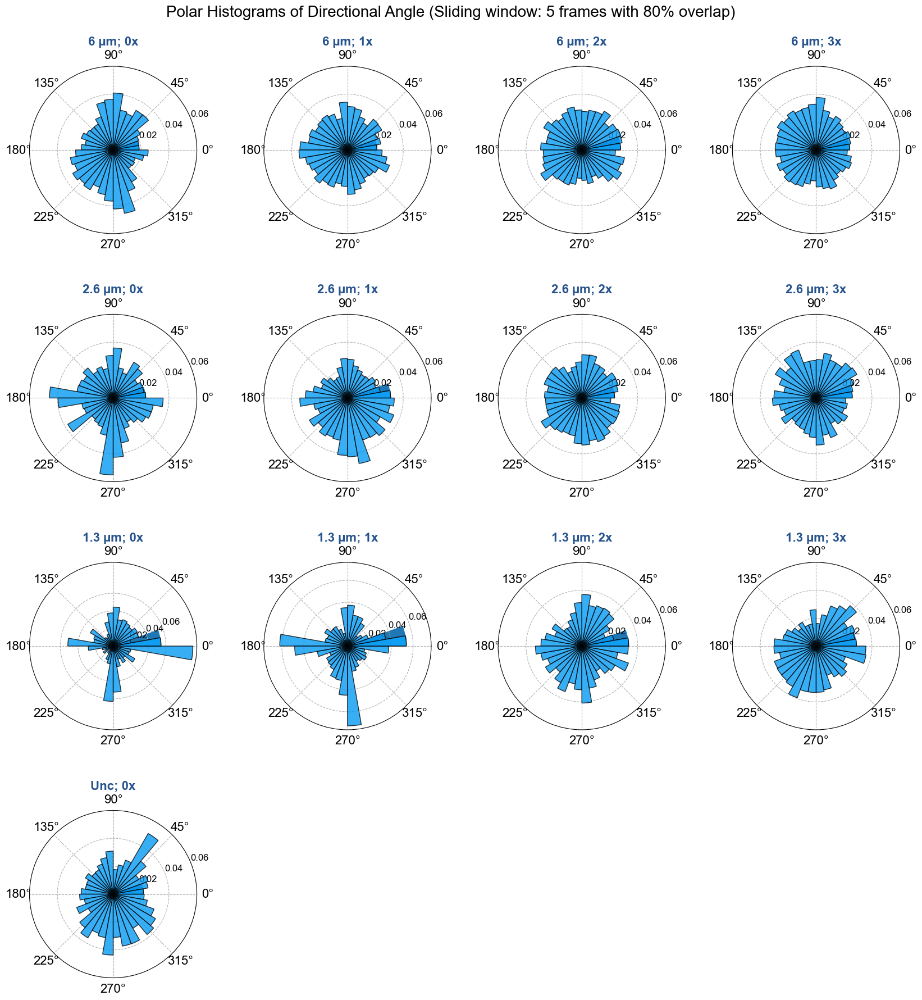

In [578]:
alpha = []

for dev in datadic.keys():
    for pil in datadic[dev].keys():
        for dis in datadic[dev][pil].keys():
            alpha.extend([(pil, dis, angle) for angle in datadic[dev][pil][dis]['angle_start']])

df = pd.DataFrame(alpha,columns=['confinement', 'disorder', 'alpha'])

pillar_mapping = {'pil0': 'Unc', 'pil1': '6 µm', 'pil2': '2.6 µm', 'pil3': '1.3 µm'}
disorder_mapping = {'dis0': '0x', 'dis1': '0x', 'dis2': '1x', 
                    'dis3': '2x', 'dis4':'3x'}

# Replace the category names in the DataFrame
df['confinement'] = df['confinement'].replace(pillar_mapping)
df['disorder'] = df['disorder'].replace(disorder_mapping) 


#Merge the two columns to one 'condition' column
df['condition'] = df['confinement'] + '; ' + df['disorder']

df_exploded = df.explode('alpha')


fig, axes = plt.subplots(nrows=4, ncols=4, subplot_kw=dict(projection="polar"), figsize=(20, 20))
fig.subplots_adjust(hspace=0.4, wspace=0.4)

for i, ax in enumerate(axes.flat):
    if i < len(condition):
        subset_df = df_exploded[df_exploded['condition'] == condition[i]]['alpha']
        print(len(subset_df))
        # Define binning
        bins = np.linspace(0, 2*np.pi, 37)
        
        # Calculate histogram
        hist, bin_edges = np.histogram(subset_df, bins=bins)
        
        # Normalize histogram
        hist = hist / (len(subset_df))
        
        # Wrap around the histogram
        hist = np.concatenate((hist, [hist[0]]))
        bin_edges = np.concatenate((bin_edges, [bin_edges[-1] + (bin_edges[1] - bin_edges[0])]))
        
        #ax.plot(bin_edges, np.concatenate((hist, [hist[0]])), color='blue', zorder=2)
        
        # Create the bar plot on the polar axis
        bars = ax.bar(bin_edges, np.concatenate((hist, [hist[0]])), width=(2*np.pi)/36, align='edge')
        ax.set_theta_zero_location("E")
        
        # Use custom colors and opacity
        for r, bar in zip(bin_edges[:-1], bars):
            bar.set_facecolor('xkcd:azure')
            bar.set_edgecolor('black')
            bar.set_alpha(0.8)
            bar.set_zorder(2)
        
        # Change the size of the degree labels
        ax.tick_params(axis='x', labelsize=16)
        ax.tick_params(axis='y', labelsize=12)
        ax.set_yticks([0.02,0.04,0.06])
        # Set grid style
        ax.grid(True, linestyle='dashed', zorder=1)
        ax.set_title(condition[i], fontsize=16,color='xkcd:dusk blue',weight='bold')
    else:
        # Hide any extra subplots if the number of conditions is less than 16
        ax.axis('off')
fig.suptitle('Polar Histograms of Directional Angle (Sliding window: 5 frames with 80% overlap)',fontsize=20)
fig.subplots_adjust(top=0.93)
plt.rcParams['font.family'] = 'Arial'
#plt.savefig('Polar_Angle_sl5_80%.pdf',dpi=300,transparent=True)
plt.show()

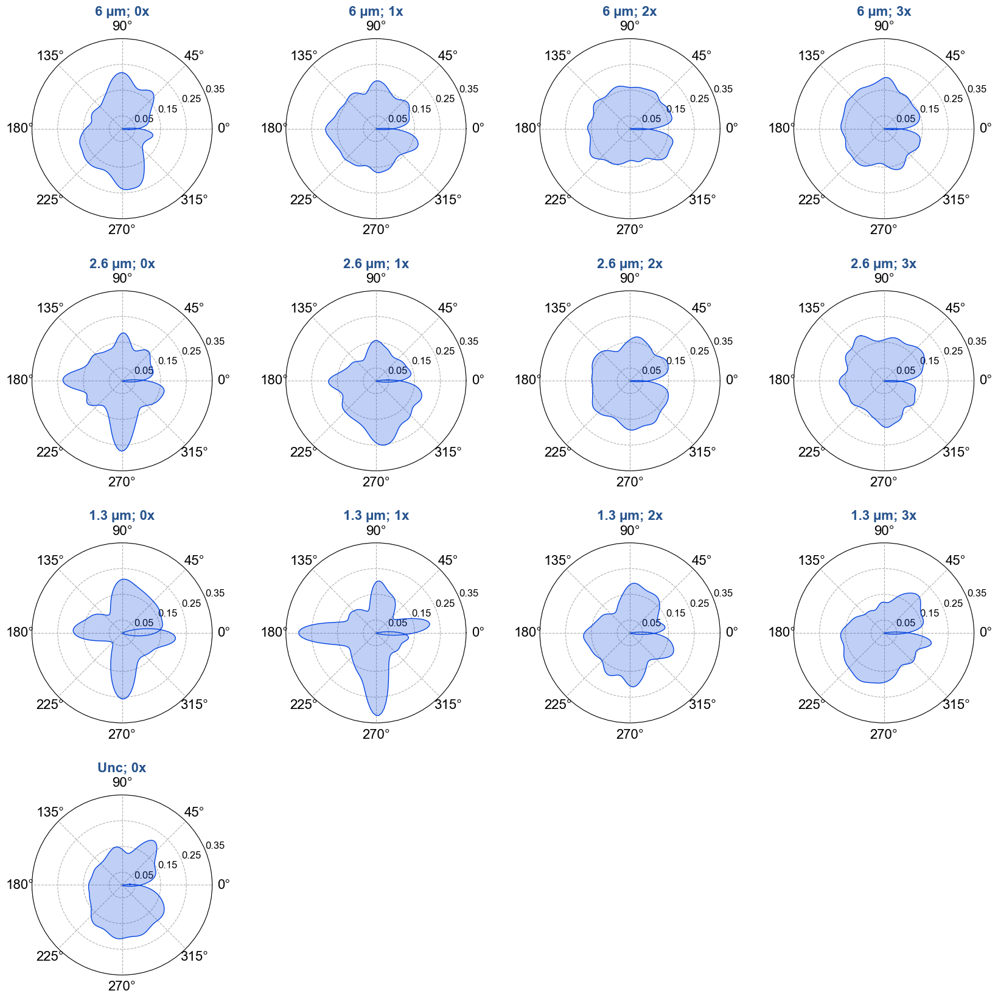

In [549]:
fig, axes = plt.subplots(nrows=4, ncols=4, subplot_kw=dict(projection="polar"), figsize=(20, 20))
fig.subplots_adjust(hspace=0.4, wspace=0.4)

for i, ax in enumerate(axes.flat):
    if i < len(condition):
        subset_df = df_exploded[df_exploded['condition'] == condition[i]]['alpha']
    
        # Define binning (for plotting purposes)
        abins = np.linspace(0, 2*np.pi, 360)  # Fine-grained bins for smooth density plot
        
         # Plot density estimation
        sns.kdeplot(data=subset_df, ax=ax, bw_adjust=0.8, color='xkcd:blue', fill=True, linewidth=1,zorder=2)
        
        ax.grid(True, linestyle='dashed', zorder=0)
    
        ax.set_title(condition[i], fontsize=16,color='xkcd:dusk blue',weight='bold')
        
        # Change the size of the degree labels
        ax.tick_params(axis='x', labelsize=16)
        ax.tick_params(axis='y', labelsize=12)

        ax.set_yticks([0.05 ,0.15, 0.25,0.35])
        ax.set_ylim(0,0.35)
    
        ax.set_ylabel(None)
        ax.set_xlabel(None)
        
        
    else:
        # Hide any extra subplots if the number of conditions is less than 16
        ax.axis('off')
# Show plot
plt.show()

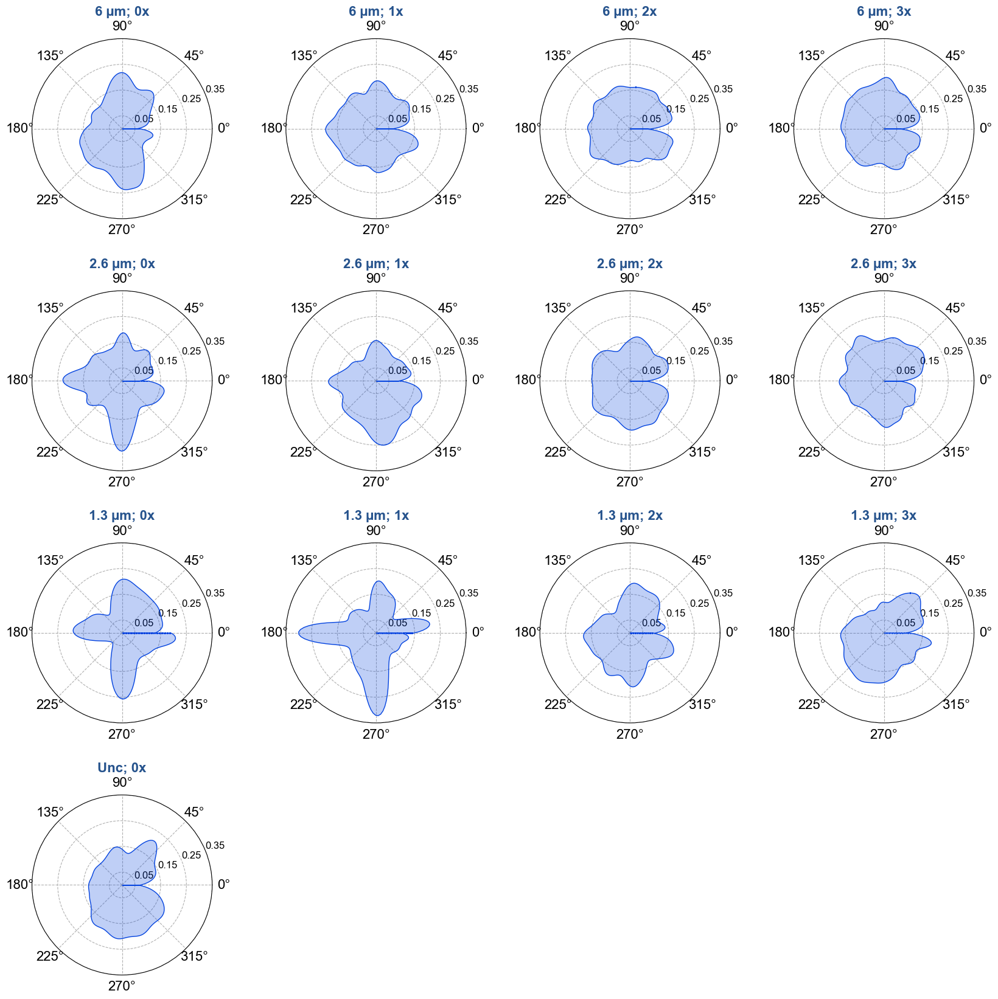

In [552]:
fig, axes = plt.subplots(nrows=4, ncols=4, subplot_kw=dict(projection="polar"), figsize=(20, 20))
fig.subplots_adjust(hspace=0.4, wspace=0.4)

for i, ax in enumerate(axes.flat):
    if i < len(condition):
        subset_df = df_exploded[df_exploded['condition'] == condition[i]]['alpha']
    
        # Define binning (for plotting purposes)
        abins = np.linspace(0, 2*np.pi, 360)  # Fine-grained bins for smooth density plot
        
         # Plot density estimation
        sns.kdeplot(data=subset_df, ax=ax, cut=0, bw_adjust=0.8, color='xkcd:blue', fill=True, linewidth=1,zorder=2)
        
        ax.grid(True, linestyle='dashed', zorder=0)

        ax.set_title(condition[i], fontsize=16,color='xkcd:dusk blue',weight='bold')
        
        # Change the size of the degree labels
        ax.tick_params(axis='x', labelsize=16)
        ax.tick_params(axis='y', labelsize=12)

        ax.set_yticks([0.05 ,0.15, 0.25,0.35])
        ax.set_ylim(0,0.35)
    
        ax.set_ylabel(None)
        ax.set_xlabel(None)
        
        
    else:
        # Hide any extra subplots if the number of conditions is less than 16
        ax.axis('off')
# Show plot
plt.show()

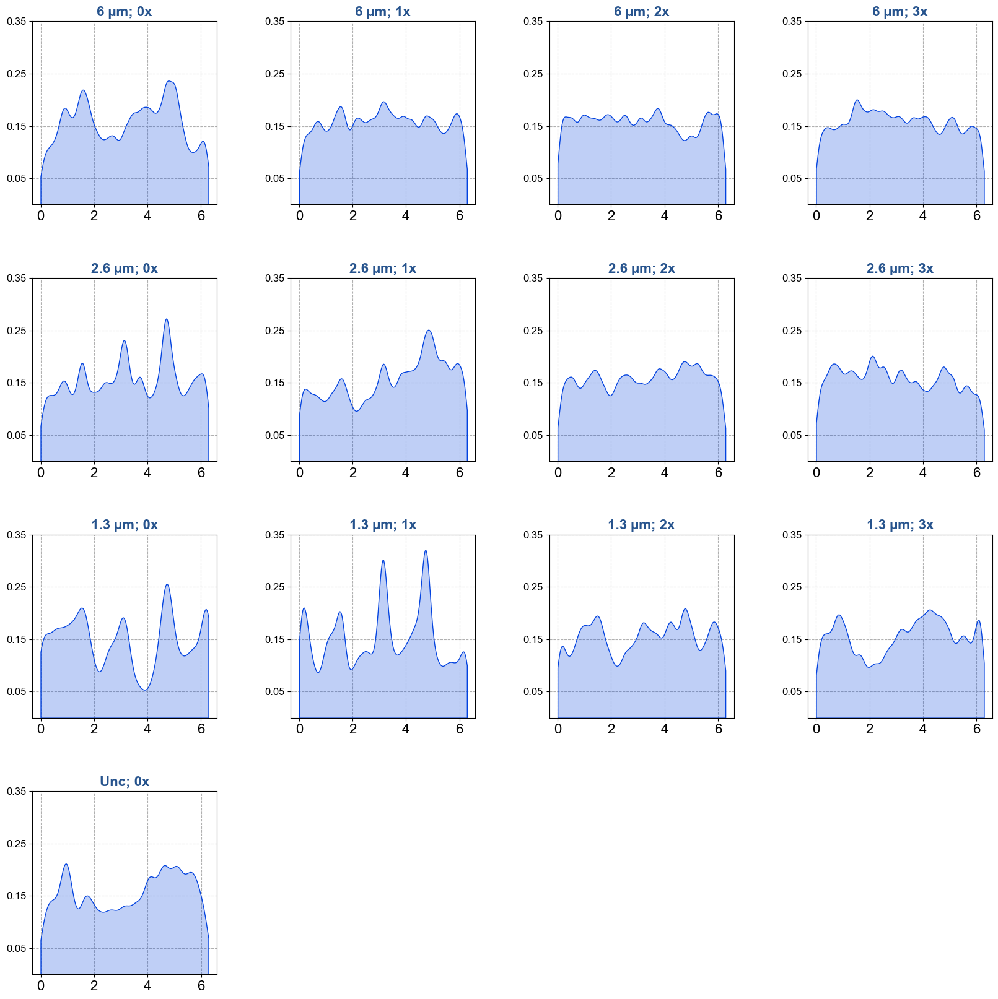

In [551]:
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(20, 20))
fig.subplots_adjust(hspace=0.4, wspace=0.4)

for i, ax in enumerate(axes.flat):
    if i < len(condition):
        subset_df = df_exploded[df_exploded['condition'] == condition[i]]['alpha']
    
        # Define binning (for plotting purposes)
        abins = np.linspace(0, 2*np.pi, 360)  # Fine-grained bins for smooth density plot
        
         # Plot density estimation
        sns.kdeplot(data=subset_df, ax=ax, cut=0, bw_adjust=0.8, color='xkcd:blue', fill=True, linewidth=1,zorder=2)
        
        ax.grid(True, linestyle='dashed', zorder=0)

        ax.set_title(condition[i], fontsize=16,color='xkcd:dusk blue',weight='bold')
        
        # Change the size of the degree labels
        ax.tick_params(axis='x', labelsize=16)
        ax.tick_params(axis='y', labelsize=12)

        ax.set_yticks([0.05 ,0.15, 0.25,0.35])
        ax.set_ylim(0,0.35)
    
        ax.set_ylabel(None)
        ax.set_xlabel(None)
        
        
    else:
        # Hide any extra subplots if the number of conditions is less than 16
        ax.axis('off')
# Show plot
plt.show()

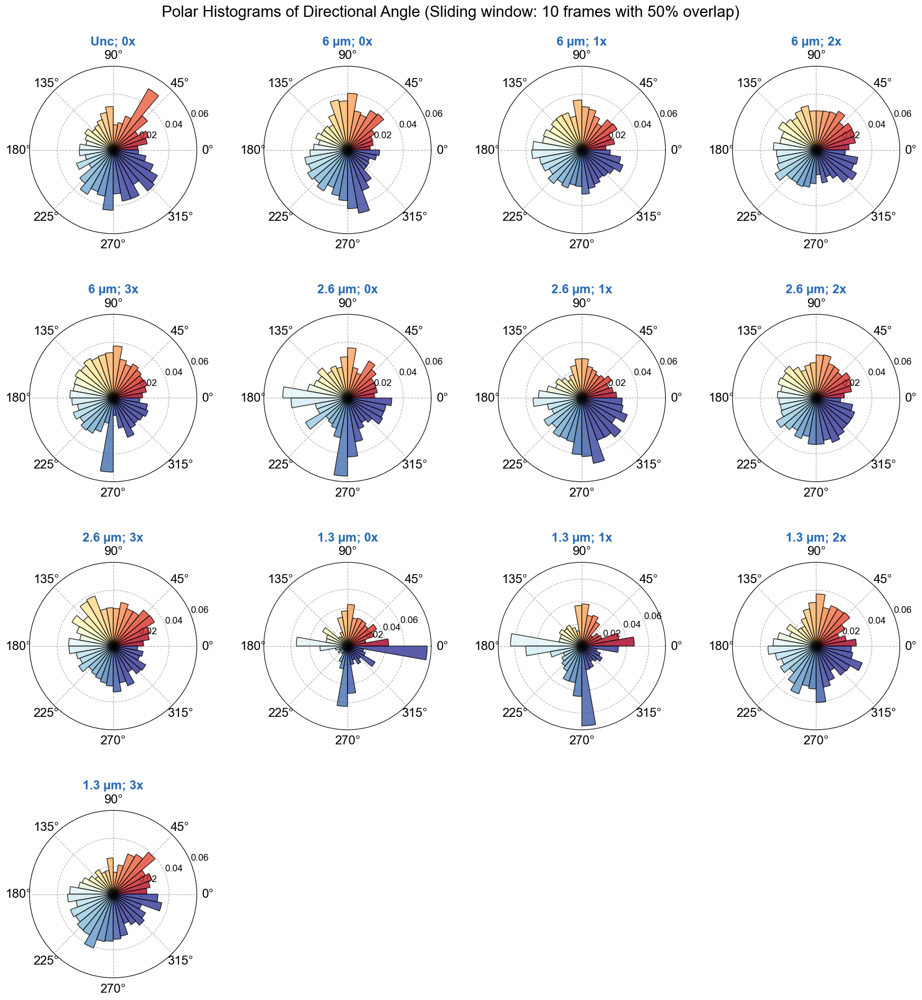

In [493]:
alpha = []

for dev in datadic.keys():
    for pil in datadic[dev].keys():
        for dis in datadic[dev][pil].keys():
            alpha.extend([(pil, dis, angle) for angle in datadic[dev][pil][dis]['angle_start']])

df = pd.DataFrame(alpha,columns=['confinement', 'disorder', 'alpha'])

pillar_mapping = {'pil0': 'Unc', 'pil1': '6 µm', 'pil2': '2.6 µm', 'pil3': '1.3 µm'}
disorder_mapping = {'dis0': '0x', 'dis1': '0x', 'dis2': '1x', 
                    'dis3': '2x', 'dis4':'3x'}

# Replace the category names in the DataFrame
df['confinement'] = df['confinement'].replace(pillar_mapping)
df['disorder'] = df['disorder'].replace(disorder_mapping) 


#Merge the two columns to one 'condition' column
df['condition'] = df['confinement'] + '; ' + df['disorder']

df_exploded = df.explode('alpha')


fig, axes = plt.subplots(nrows=4, ncols=4, subplot_kw=dict(projection="polar"), figsize=(20, 20))
fig.subplots_adjust(hspace=0.4, wspace=0.4)

for i, ax in enumerate(axes.flat):
    if i < len(condition):
        subset_df = df_exploded[df_exploded['condition'] == condition[i]]['alpha']
        
        # Define binning
        abins = np.linspace(0, 2*np.pi, 37)
        
        # Calculate histogram
        hist, bin_edges = np.histogram(subset_df, bins=abins)
        
        # Normalize histogram
        hist = hist / (len(subset_df))
        
        # Create the bar plot on the polar axis
        bars = ax.bar(bin_edges[:-1], hist, width=(2*np.pi)/36, align='edge')
        ax.set_theta_zero_location("E")
        
        # Use custom colors and opacity
        for r, bar in zip(bin_edges[:-1], bars):
            bar.set_facecolor(plt.cm.RdYlBu(r / 5.))
            bar.set_edgecolor('black')
            bar.set_alpha(0.8)
            bar.set_zorder(2)
        
        # Change the size of the degree labels
        ax.tick_params(axis='x', labelsize=16)
        ax.tick_params(axis='y', labelsize=12)
        ax.set_yticks([0.02,0.04,0.06])
        # Set grid style
        ax.grid(True, linestyle='dashed', zorder=1)
        ax.set_title(condition[i], fontsize=16,color='xkcd:mid blue',weight='bold')
    else:
        # Hide any extra subplots if the number of conditions is less than 16
        ax.axis('off')
fig.suptitle('Polar Histograms of Directional Angle (Sliding window: 10 frames with 50% overlap)',fontsize=20)
fig.subplots_adjust(top=0.93)
plt.show()

### Sliding window = 10 with 80% overlap

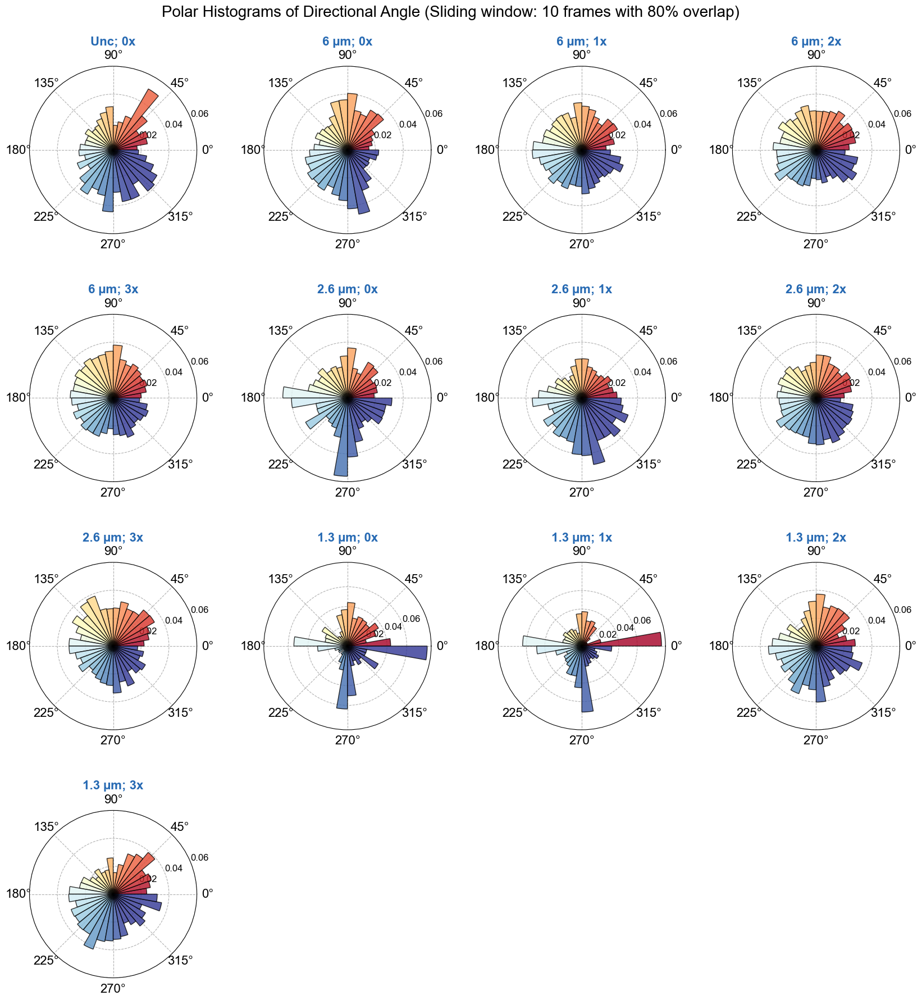

In [494]:
#1.Construct a dictionary for data storage and analysis
datadic = {} #set up a data directory
dev = [] #number of device
pil= [] #number of confinement
dis = [] #number of disorders
rep = [] #number of repititions 
pixel_to_micron = 0.656 #pixel to micron (from Miles)
fps = 20 #frames per second
skip = 1
window_size = 10
overlap = 8

for file in files:
    
    curr_data = pd.read_csv(file)
    data = curr_data[['TRACK_ID','POSITION_X','POSITION_Y','POSITION_T']]
    grouped_df = data.groupby('TRACK_ID')
    # Filter out data with less spots
    minimum_spots = 160  # Replace this with a desired "minimum_spots" value
    filtered_df = grouped_df.filter(lambda group: len(group) >= minimum_spots)
    # Reindex the track IDs starting from 1
    filtered_df.reset_index(drop=True, inplace=True) #reindex the column starting from 0
    df = filtered_df.groupby('TRACK_ID', group_keys=True, as_index=False).apply(lambda x: x) #group the dataframe by TRACK_ID
    df.reset_index(level=0, inplace=True) #move the first level to a separate column
    df.rename(columns={'level_0': 'ID'}, inplace=True) #rename new level  
    track_names = df['ID'].unique().tolist()
    #print(df)
    
    device = file.split('-')[-5] #retrieve the strains used in each microfluidic device 
    pillar = file.split('-')[-4] #retrieve the specific confinement 
    disorder = file.split('-')[-3] #retrieve the specific disorder degree
    #repetition = file.split('-')[-1][:4] #the first four letter
    if device not in datadic:
        dev.extend([device])
        datadic[device] = {} 
    if pillar not in datadic[device]:
        if pillar not in pil:
            pil.extend([pillar])
        datadic[device][pillar] = {}
    if disorder not in datadic[device][pillar]:
        if disorder not in dis:
            dis.extend([disorder])
        datadic[device][pillar][disorder] = {}
        datadic[device][pillar][disorder]['time'] = []
        datadic[device][pillar][disorder]['rescaled_time'] = [] #Create a list to store all 'rescaled' time info
        datadic[device][pillar][disorder]['pos'] = []
        datadic[device][pillar][disorder]['rescaled_pos'] = [] #Create a list to store all 'rescaled' x and y info
        #datadic[device][pillar][disorder]['MSD'] = [[]]
        datadic[device][pillar][disorder]['reposition'] = []
        datadic[device][pillar][disorder]['angle_start'] = []
        
    for i in range(len(track_names)):
        time = np.array(df[df['ID']==track_names[i]]['POSITION_T'].tolist())
        time_start = time[0]        
       
        datadic[device][pillar][disorder]['time'].append(time)
        
        datadic[device][pillar][disorder]['rescaled_time'].append([(time[i]-time_start)/fps for i in range(len(time))]) #rescale the time as well based on fps
        x_pos = np.array(df[df['ID']==track_names[i]]['POSITION_X'].tolist())
        y_pos = np.array(df[df['ID']==track_names[i]]['POSITION_Y'].tolist())
        x_start = x_pos[0]
        y_start = y_pos[0] 
        datadic[device][pillar][disorder]['pos'].append([(x_pos[t]-x_start,y_pos[t]-y_start) for t in range(len(x_pos))])
        datadic[device][pillar][disorder]['rescaled_pos'].append([(pixel_to_micron*x_pos[t], pixel_to_micron*y_pos[t]) for t in range(len(x_pos))]) 
        datadic[device][pillar][disorder]['reposition'].append([(pixel_to_micron*(x_pos[t]-x_start), pixel_to_micron*(y_pos[t]-y_start)) for t in range(len(x_pos))])
        
        #compute the angles with respect to the same origin (0,0)
        angles = anglestart(x_pos,y_pos,x_start,y_start,pixel_to_micron,skip)[1:]
        angle_sl = sliding_window(angles,window_size,overlap)
        datadic[device][pillar][disorder]['angle_start'].append(angle_sl)
        
alpha = []

for dev in datadic.keys():
    for pil in datadic[dev].keys():
        for dis in datadic[dev][pil].keys():
            alpha.extend([(pil, dis, angle) for angle in datadic[dev][pil][dis]['angle_start']])

df = pd.DataFrame(alpha,columns=['confinement', 'disorder', 'alpha'])

pillar_mapping = {'pil0': 'Unc', 'pil1': '6 µm', 'pil2': '2.6 µm', 'pil3': '1.3 µm'}
disorder_mapping = {'dis0': '0x', 'dis1': '0x', 'dis2': '1x', 
                    'dis3': '2x', 'dis4':'3x'}

# Replace the category names in the DataFrame
df['confinement'] = df['confinement'].replace(pillar_mapping)
df['disorder'] = df['disorder'].replace(disorder_mapping) 


#Merge the two columns to one 'condition' column
df['condition'] = df['confinement'] + '; ' + df['disorder']

df_exploded = df.explode('alpha')


fig, axes = plt.subplots(nrows=4, ncols=4, subplot_kw=dict(projection="polar"), figsize=(20, 20))
fig.subplots_adjust(hspace=0.4, wspace=0.4)

for i, ax in enumerate(axes.flat):
    if i < len(condition):
        subset_df = df_exploded[df_exploded['condition'] == condition[i]]['alpha']
        
        # Define binning
        abins = np.linspace(0, 2*np.pi, 37)
        
        # Calculate histogram
        hist, bin_edges = np.histogram(subset_df, bins=abins)
        
        # Normalize histogram
        hist = hist / (len(subset_df))
        
        # Create the bar plot on the polar axis
        bars = ax.bar(bin_edges[:-1], hist, width=(2*np.pi)/36, align='edge')
        ax.set_theta_zero_location("E")
        
        # Use custom colors and opacity
        for r, bar in zip(bin_edges[:-1], bars):
            bar.set_facecolor(plt.cm.RdYlBu(r / 5.))
            bar.set_edgecolor('black')
            bar.set_alpha(0.8)
            bar.set_zorder(2)
        
        # Change the size of the degree labels
        ax.tick_params(axis='x', labelsize=16)
        ax.tick_params(axis='y', labelsize=12)
        ax.set_yticks([0.02,0.04,0.06])
        # Set grid style
        ax.grid(True, linestyle='dashed', zorder=1)
        ax.set_title(condition[i], fontsize=16,color='xkcd:mid blue',weight='bold')
    else:
        # Hide any extra subplots if the number of conditions is less than 16
        ax.axis('off')
fig.suptitle('Polar Histograms of Directional Angle (Sliding window: 10 frames with 80% overlap)',fontsize=20)
fig.subplots_adjust(top=0.93)
plt.show()

### Sliding window = 20 (overlap 50%)

In [495]:
#1.Construct a dictionary for data storage and analysis
datadic = {} #set up a data directory
dev = [] #number of device
pil= [] #number of confinement
dis = [] #number of disorders
rep = [] #number of repititions 
pixel_to_micron = 0.656 #pixel to micron (from Miles)
fps = 20 #frames per second
skip = 1
window_size = 20
overlap = 10

for file in files:
    
    curr_data = pd.read_csv(file)
    data = curr_data[['TRACK_ID','POSITION_X','POSITION_Y','POSITION_T']]
    grouped_df = data.groupby('TRACK_ID')
    # Filter out data with less spots
    minimum_spots = 160  # Replace this with a desired "minimum_spots" value
    filtered_df = grouped_df.filter(lambda group: len(group) >= minimum_spots)
    # Reindex the track IDs starting from 1
    filtered_df.reset_index(drop=True, inplace=True) #reindex the column starting from 0
    df = filtered_df.groupby('TRACK_ID', group_keys=True, as_index=False).apply(lambda x: x) #group the dataframe by TRACK_ID
    df.reset_index(level=0, inplace=True) #move the first level to a separate column
    df.rename(columns={'level_0': 'ID'}, inplace=True) #rename new level  
    track_names = df['ID'].unique().tolist()
    #print(df)
    
    device = file.split('-')[-5] #retrieve the strains used in each microfluidic device 
    pillar = file.split('-')[-4] #retrieve the specific confinement 
    disorder = file.split('-')[-3] #retrieve the specific disorder degree
    #repetition = file.split('-')[-1][:4] #the first four letter
    if device not in datadic:
        dev.extend([device])
        datadic[device] = {} 
    if pillar not in datadic[device]:
        if pillar not in pil:
            pil.extend([pillar])
        datadic[device][pillar] = {}
    if disorder not in datadic[device][pillar]:
        if disorder not in dis:
            dis.extend([disorder])
        datadic[device][pillar][disorder] = {}
        datadic[device][pillar][disorder]['time'] = []
        datadic[device][pillar][disorder]['rescaled_time'] = [] #Create a list to store all 'rescaled' time info
        datadic[device][pillar][disorder]['pos'] = []
        datadic[device][pillar][disorder]['rescaled_pos'] = [] #Create a list to store all 'rescaled' x and y info
        #datadic[device][pillar][disorder]['MSD'] = [[]]
        datadic[device][pillar][disorder]['reposition'] = []
        datadic[device][pillar][disorder]['angle_start'] = []
        
    for i in range(len(track_names)):
        time = np.array(df[df['ID']==track_names[i]]['POSITION_T'].tolist())
        time_start = time[0]        
       
        datadic[device][pillar][disorder]['time'].append(time)
        
        datadic[device][pillar][disorder]['rescaled_time'].append([(time[i]-time_start)/fps for i in range(len(time))]) #rescale the time as well based on fps
        x_pos = np.array(df[df['ID']==track_names[i]]['POSITION_X'].tolist())
        y_pos = np.array(df[df['ID']==track_names[i]]['POSITION_Y'].tolist())
        x_start = x_pos[0]
        y_start = y_pos[0] 
        datadic[device][pillar][disorder]['pos'].append([(x_pos[t]-x_start,y_pos[t]-y_start) for t in range(len(x_pos))])
        datadic[device][pillar][disorder]['rescaled_pos'].append([(pixel_to_micron*x_pos[t], pixel_to_micron*y_pos[t]) for t in range(len(x_pos))]) 
        datadic[device][pillar][disorder]['reposition'].append([(pixel_to_micron*(x_pos[t]-x_start), pixel_to_micron*(y_pos[t]-y_start)) for t in range(len(x_pos))])
        
        #compute the angles with respect to the same origin (0,0)
        angles = anglestart(x_pos,y_pos,x_start,y_start,pixel_to_micron,skip)[1:]
        angle_sl = sliding_window(angles,window_size,overlap)
        datadic[device][pillar][disorder]['angle_start'].append(angle_sl)

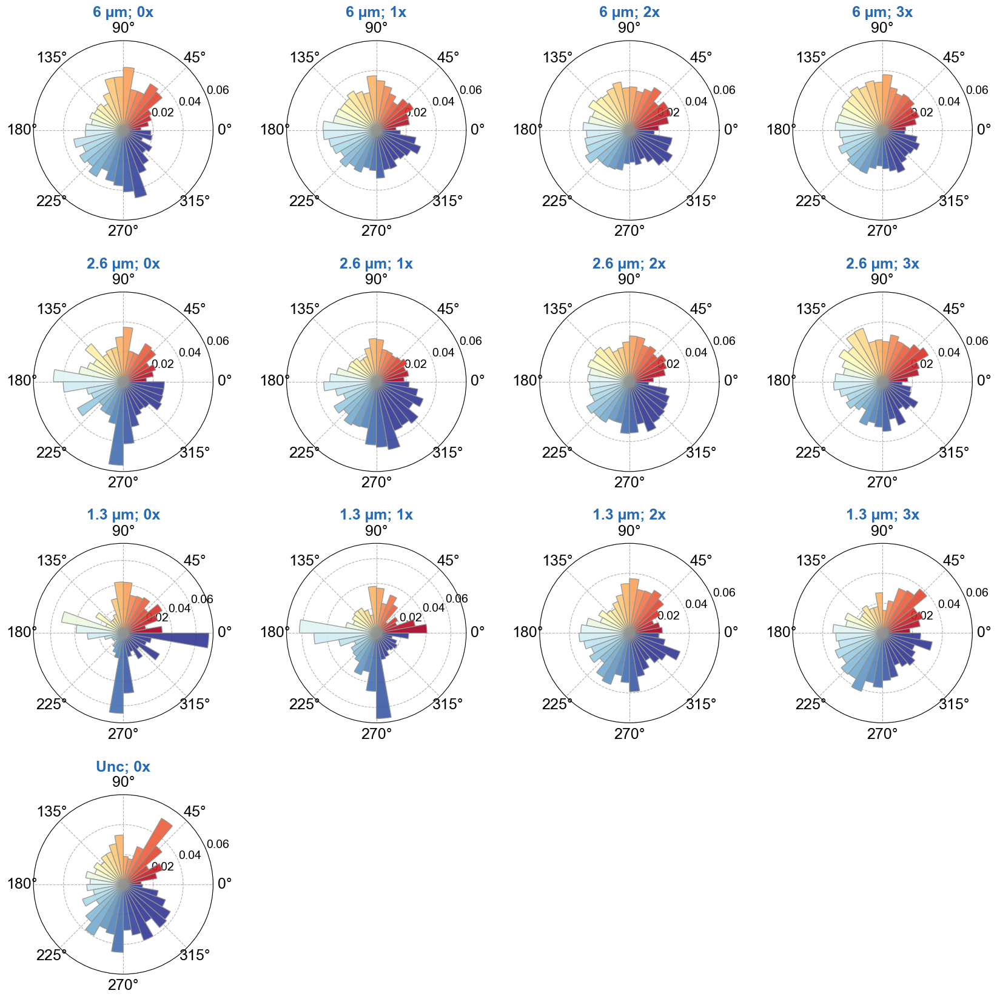

In [513]:
alpha = []

for dev in datadic.keys():
    for pil in datadic[dev].keys():
        for dis in datadic[dev][pil].keys():
            alpha.extend([(pil, dis, angle) for angle in datadic[dev][pil][dis]['angle_start']])

df = pd.DataFrame(alpha,columns=['confinement', 'disorder', 'alpha'])

pillar_mapping = {'pil0': 'Unc', 'pil1': '6 µm', 'pil2': '2.6 µm', 'pil3': '1.3 µm'}
disorder_mapping = {'dis0': '0x', 'dis1': '0x', 'dis2': '1x', 
                    'dis3': '2x', 'dis4':'3x'}

# Replace the category names in the DataFrame
df['confinement'] = df['confinement'].replace(pillar_mapping)
df['disorder'] = df['disorder'].replace(disorder_mapping) 


#Merge the two columns to one 'condition' column
df['condition'] = df['confinement'] + '; ' + df['disorder']

df_exploded = df.explode('alpha')

condition = ['6 µm; 0x', '6 µm; 1x', '6 µm; 2x', '6 µm; 3x',
       '2.6 µm; 0x', '2.6 µm; 1x', '2.6 µm; 2x', '2.6 µm; 3x', 
        '1.3 µm; 0x', '1.3 µm; 1x', '1.3 µm; 2x', '1.3 µm; 3x','Unc; 0x']

fig, axes = plt.subplots(nrows=4, ncols=4, subplot_kw=dict(projection="polar"), figsize=(20, 20))
fig.subplots_adjust(hspace=0.4, wspace=0.4)

for i, ax in enumerate(axes.flat):
    if i < len(condition):
        subset_df = df_exploded[df_exploded['condition'] == condition[i]]['alpha']
        
        # Define binning
        abins = np.linspace(0, 2*np.pi, 37)
        
        # Calculate histogram
        hist, bin_edges = np.histogram(subset_df, bins=abins)
        
        # Normalize histogram
        hist = hist / (len(subset_df))
        
        # Create the bar plot on the polar axis
        bars = ax.bar(bin_edges[:-1], hist, width=(2*np.pi)/36, align='edge')
        ax.set_theta_zero_location("E")
        
        # Use custom colors and opacity
        for r, bar in zip(bin_edges[:-1], bars):
            bar.set_facecolor(plt.cm.RdYlBu(r / 5.))
            bar.set_edgecolor('xkcd:grey')
            bar.set_alpha(0.9)
            bar.set_zorder(2)
        
        # Change the size of the degree labels
        ax.tick_params(axis='x', labelsize=18)
        ax.tick_params(axis='y', labelsize=14)
        ax.set_yticks([0.02,0.04,0.06])
        # Set grid style
        ax.grid(True, linestyle='dashed', zorder=1)
        ax.set_title(condition[i], fontsize=18,color='xkcd:mid blue',weight='bold')
    else:
        # Hide any extra subplots if the number of conditions is less than 16
        ax.axis('off')
#fig.suptitle('Polar Histograms of Directional Angle (Sliding window: 20 frames with 50% overlap)',fontsize=20)
#fig.subplots_adjust(top=0.93)
plt.rcParams['font.family'] = 'Arial'
plt.savefig('Polar_Angle_sl20_50%_grey.pdf',dpi=300,transparent=True)
plt.show()

TypeError: FigureCanvasPdf.print_pdf() got an unexpected keyword argument 'transparency'

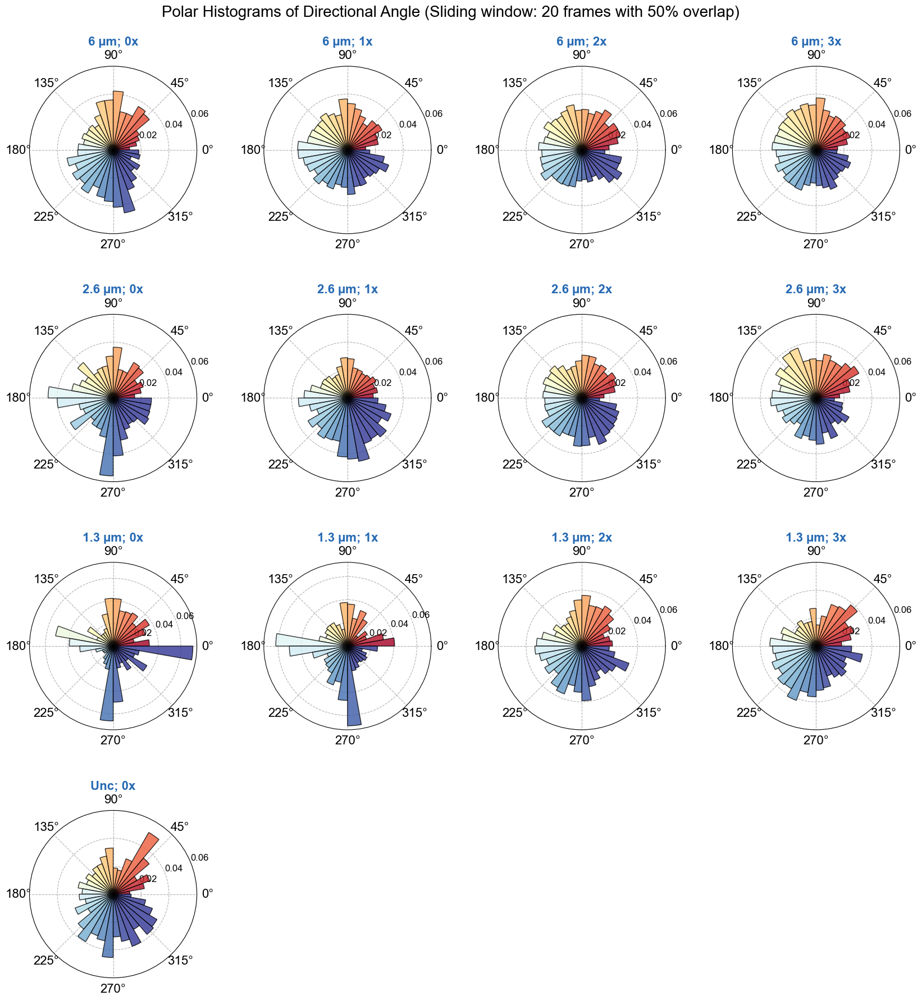

In [498]:

alpha = []

for dev in datadic.keys():
    for pil in datadic[dev].keys():
        for dis in datadic[dev][pil].keys():
            alpha.extend([(pil, dis, angle) for angle in datadic[dev][pil][dis]['angle_start']])

df = pd.DataFrame(alpha,columns=['confinement', 'disorder', 'alpha'])

pillar_mapping = {'pil0': 'Unc', 'pil1': '6 µm', 'pil2': '2.6 µm', 'pil3': '1.3 µm'}
disorder_mapping = {'dis0': '0x', 'dis1': '0x', 'dis2': '1x', 
                    'dis3': '2x', 'dis4':'3x'}

# Replace the category names in the DataFrame
df['confinement'] = df['confinement'].replace(pillar_mapping)
df['disorder'] = df['disorder'].replace(disorder_mapping) 


#Merge the two columns to one 'condition' column
df['condition'] = df['confinement'] + '; ' + df['disorder']

df_exploded = df.explode('alpha')


fig, axes = plt.subplots(nrows=4, ncols=4, subplot_kw=dict(projection="polar"), figsize=(20, 20))
fig.subplots_adjust(hspace=0.4, wspace=0.4)

for i, ax in enumerate(axes.flat):
    if i < len(condition):
        subset_df = df_exploded[df_exploded['condition'] == condition[i]]['alpha']
        
        # Define binning
        abins = np.linspace(0, 2*np.pi, 37)
        
        # Calculate histogram
        hist, bin_edges = np.histogram(subset_df, bins=abins)
        
        # Normalize histogram
        hist = hist / (len(subset_df))
        
        # Create the bar plot on the polar axis
        bars = ax.bar(bin_edges[:-1], hist, width=(2*np.pi)/36, align='edge')
        ax.set_theta_zero_location("E")
        
        # Use custom colors and opacity
        for r, bar in zip(bin_edges[:-1], bars):
            bar.set_facecolor(plt.cm.RdYlBu(r / 5.))
            bar.set_edgecolor('black')
            bar.set_alpha(0.8)
            bar.set_zorder(2)
        
        # Change the size of the degree labels
        ax.tick_params(axis='x', labelsize=16)
        ax.tick_params(axis='y', labelsize=12)
        ax.set_yticks([0.02,0.04,0.06])
        # Set grid style
        ax.grid(True, linestyle='dashed', zorder=1)
        ax.set_title(condition[i], fontsize=16,color='xkcd:mid blue',weight='bold')
    else:
        # Hide any extra subplots if the number of conditions is less than 16
        ax.axis('off')
fig.suptitle('Polar Histograms of Directional Angle (Sliding window: 20 frames with 50% overlap)',fontsize=20)
fig.subplots_adjust(top=0.93)

plt.savefig('Polar_Angle_sl20_50%.pdf',dpi=300,transparency=True)
plt.show()

### Sliding window = 20 (overlap 75%)

In [490]:
#1.Construct a dictionary for data storage and analysis
datadic = {} #set up a data directory
dev = [] #number of device
pil= [] #number of confinement
dis = [] #number of disorders
rep = [] #number of repititions 
pixel_to_micron = 0.656 #pixel to micron (from Miles)
fps = 20 #frames per second
skip = 1
window_size = 20
overlap = 15

for file in files:
    
    curr_data = pd.read_csv(file)
    data = curr_data[['TRACK_ID','POSITION_X','POSITION_Y','POSITION_T']]
    grouped_df = data.groupby('TRACK_ID')
    # Filter out data with less spots
    minimum_spots = 160  # Replace this with a desired "minimum_spots" value
    filtered_df = grouped_df.filter(lambda group: len(group) >= minimum_spots)
    # Reindex the track IDs starting from 1
    filtered_df.reset_index(drop=True, inplace=True) #reindex the column starting from 0
    df = filtered_df.groupby('TRACK_ID', group_keys=True, as_index=False).apply(lambda x: x) #group the dataframe by TRACK_ID
    df.reset_index(level=0, inplace=True) #move the first level to a separate column
    df.rename(columns={'level_0': 'ID'}, inplace=True) #rename new level  
    track_names = df['ID'].unique().tolist()
    #print(df)
    
    device = file.split('-')[-5] #retrieve the strains used in each microfluidic device 
    pillar = file.split('-')[-4] #retrieve the specific confinement 
    disorder = file.split('-')[-3] #retrieve the specific disorder degree
    #repetition = file.split('-')[-1][:4] #the first four letter
    if device not in datadic:
        dev.extend([device])
        datadic[device] = {} 
    if pillar not in datadic[device]:
        if pillar not in pil:
            pil.extend([pillar])
        datadic[device][pillar] = {}
    if disorder not in datadic[device][pillar]:
        if disorder not in dis:
            dis.extend([disorder])
        datadic[device][pillar][disorder] = {}
        datadic[device][pillar][disorder]['time'] = []
        datadic[device][pillar][disorder]['rescaled_time'] = [] #Create a list to store all 'rescaled' time info
        datadic[device][pillar][disorder]['pos'] = []
        datadic[device][pillar][disorder]['rescaled_pos'] = [] #Create a list to store all 'rescaled' x and y info
        #datadic[device][pillar][disorder]['MSD'] = [[]]
        datadic[device][pillar][disorder]['reposition'] = []
        datadic[device][pillar][disorder]['angle_start'] = []
        
    for i in range(len(track_names)):
        time = np.array(df[df['ID']==track_names[i]]['POSITION_T'].tolist())
        time_start = time[0]        
       
        datadic[device][pillar][disorder]['time'].append(time)
        
        datadic[device][pillar][disorder]['rescaled_time'].append([(time[i]-time_start)/fps for i in range(len(time))]) #rescale the time as well based on fps
        x_pos = np.array(df[df['ID']==track_names[i]]['POSITION_X'].tolist())
        y_pos = np.array(df[df['ID']==track_names[i]]['POSITION_Y'].tolist())
        x_start = x_pos[0]
        y_start = y_pos[0] 
        datadic[device][pillar][disorder]['pos'].append([(x_pos[t]-x_start,y_pos[t]-y_start) for t in range(len(x_pos))])
        datadic[device][pillar][disorder]['rescaled_pos'].append([(pixel_to_micron*x_pos[t], pixel_to_micron*y_pos[t]) for t in range(len(x_pos))]) 
        datadic[device][pillar][disorder]['reposition'].append([(pixel_to_micron*(x_pos[t]-x_start), pixel_to_micron*(y_pos[t]-y_start)) for t in range(len(x_pos))])
        
        #compute the angles with respect to the same origin (0,0)
        angles = anglestart(x_pos,y_pos,x_start,y_start,pixel_to_micron,skip)[1:]
        angle_sl = sliding_window(angles,window_size,overlap)
        datadic[device][pillar][disorder]['angle_start'].append(angle_sl)

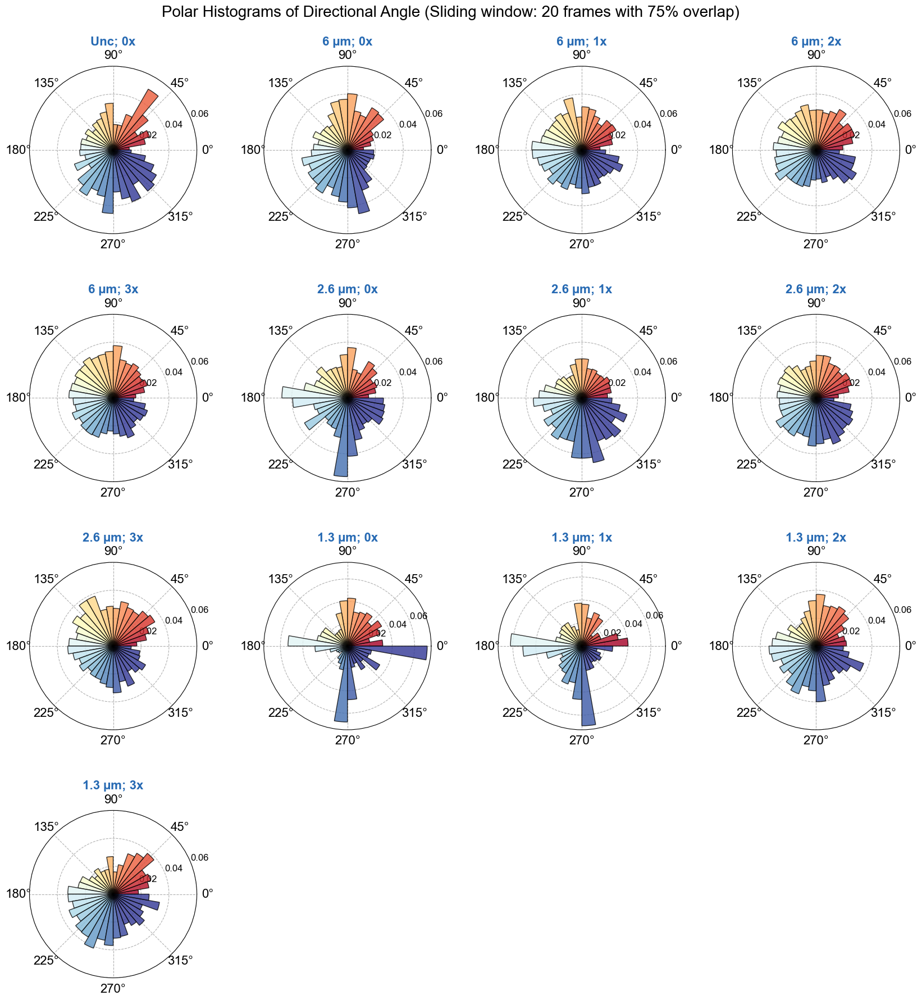

In [491]:
alpha = []

for dev in datadic.keys():
    for pil in datadic[dev].keys():
        for dis in datadic[dev][pil].keys():
            alpha.extend([(pil, dis, angle) for angle in datadic[dev][pil][dis]['angle_start']])

df = pd.DataFrame(alpha,columns=['confinement', 'disorder', 'alpha'])

pillar_mapping = {'pil0': 'Unc', 'pil1': '6 µm', 'pil2': '2.6 µm', 'pil3': '1.3 µm'}
disorder_mapping = {'dis0': '0x', 'dis1': '0x', 'dis2': '1x', 
                    'dis3': '2x', 'dis4':'3x'}

# Replace the category names in the DataFrame
df['confinement'] = df['confinement'].replace(pillar_mapping)
df['disorder'] = df['disorder'].replace(disorder_mapping) 


#Merge the two columns to one 'condition' column
df['condition'] = df['confinement'] + '; ' + df['disorder']

df_exploded = df.explode('alpha')


fig, axes = plt.subplots(nrows=4, ncols=4, subplot_kw=dict(projection="polar"), figsize=(20, 20))
fig.subplots_adjust(hspace=0.4, wspace=0.4)

for i, ax in enumerate(axes.flat):
    if i < len(condition):
        subset_df = df_exploded[df_exploded['condition'] == condition[i]]['alpha']
        
        # Define binning
        abins = np.linspace(0, 2*np.pi, 37)
        
        # Calculate histogram
        hist, bin_edges = np.histogram(subset_df, bins=abins)
        
        # Normalize histogram
        hist = hist / (len(subset_df))
        
        # Create the bar plot on the polar axis
        bars = ax.bar(bin_edges[:-1], hist, width=(2*np.pi)/36, align='edge')
        ax.set_theta_zero_location("E")
        
        # Use custom colors and opacity
        for r, bar in zip(bin_edges[:-1], bars):
            bar.set_facecolor(plt.cm.RdYlBu(r / 5.))
            bar.set_edgecolor('black')
            bar.set_alpha(0.8)
            bar.set_zorder(2)
        
        # Change the size of the degree labels
        ax.tick_params(axis='x', labelsize=16)
        ax.tick_params(axis='y', labelsize=12)
        ax.set_yticks([0.02,0.04,0.06])
        # Set grid style
        ax.grid(True, linestyle='dashed', zorder=1)
        ax.set_title(condition[i], fontsize=16,color='xkcd:mid blue',weight='bold')
    else:
        # Hide any extra subplots if the number of conditions is less than 16
        ax.axis('off')
fig.suptitle('Polar Histograms of Directional Angle (Sliding window: 20 frames with 75% overlap)',fontsize=20)
fig.subplots_adjust(top=0.93)
plt.show()

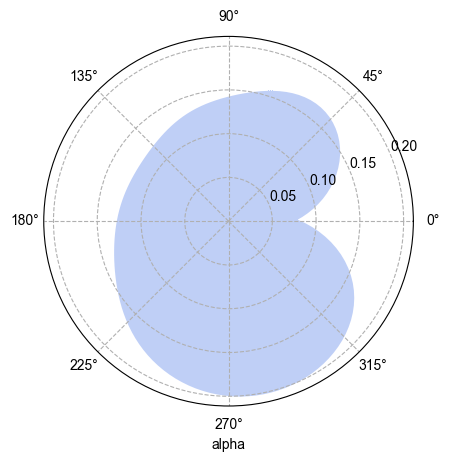

In [251]:
# Define binning (for plotting purposes)
abins = np.linspace(0, 2*np.pi, 360)  # Fine-grained bins for smooth density plot

# Plot
fig, ax = plt.subplots(subplot_kw=dict(projection="polar"))

# Plot density estimation
sns.kdeplot(data=unc_df_alpha, ax=ax, color='xkcd:blue', fill=True, linewidth=0, levels=100)
ax.set_yticks([0.05, 0.10,0.15,0.20])
# Set grid style
ax.grid(True, linestyle='dashed')
ax.set_ylabel(None)
# Show plot
plt.show()

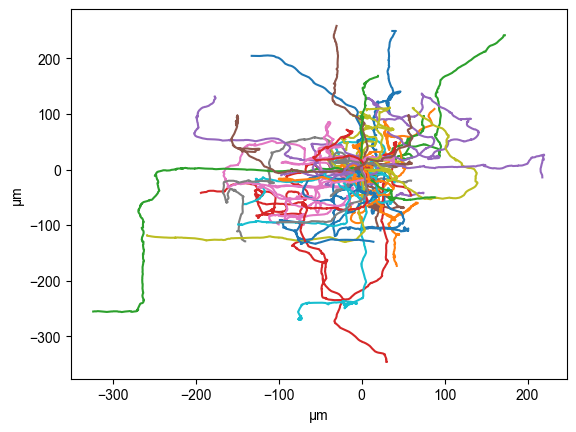

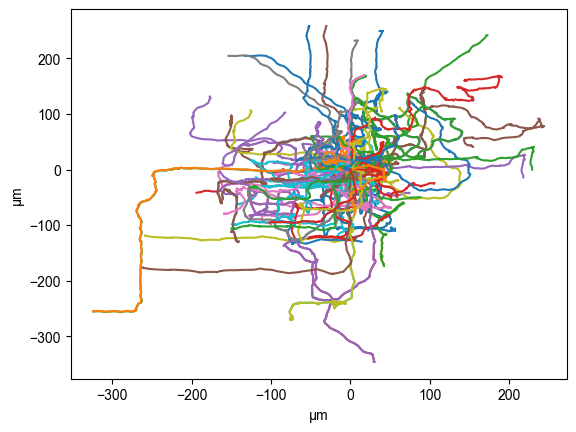

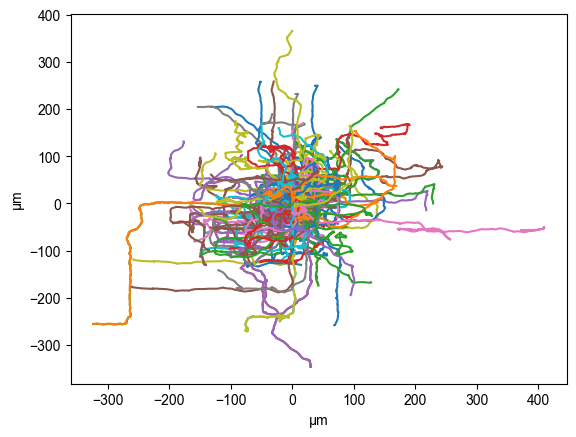

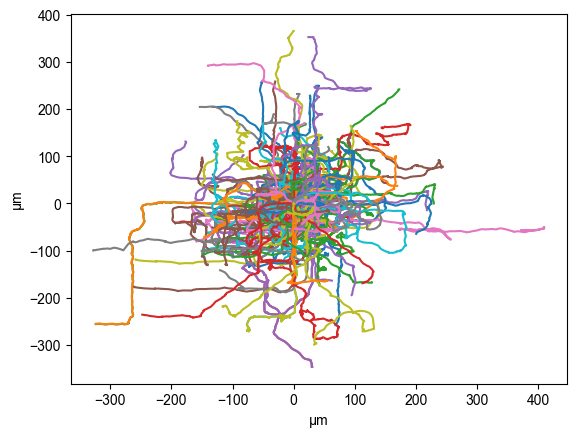

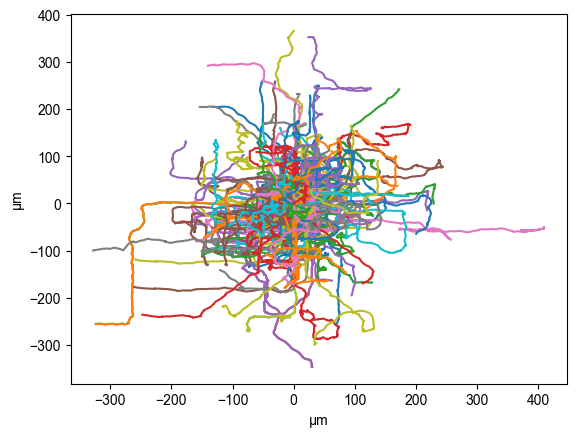

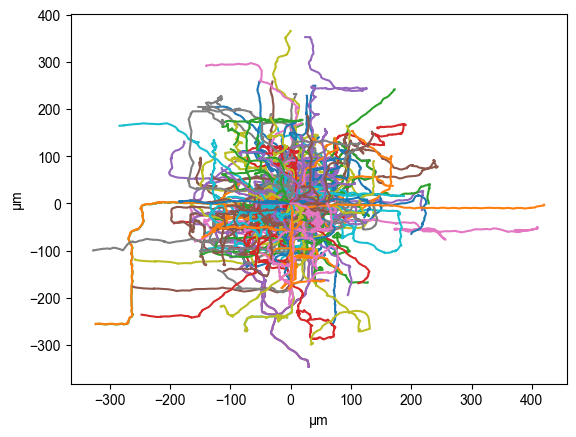

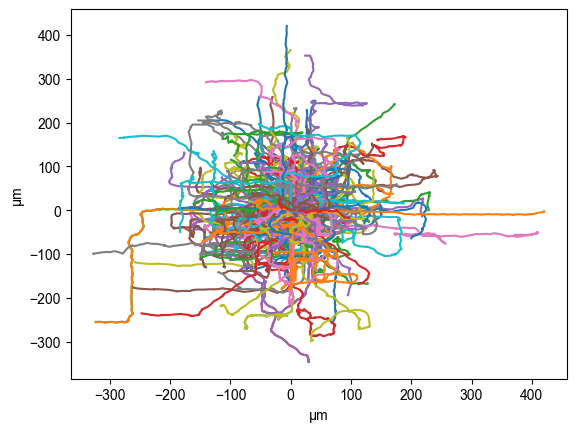

In [381]:
### Every 10 frames 

#Reference
#1.Construct a dictionary for data storage and analysis
datadic = {} #set up a data directory
dev = [] #number of device
pil= [] #number of confinement
dis = [] #number of disorders
rep = [] #number of repititions 
pixel_to_micron = 0.656 #pixel to micron (from Miles)
fps = 20 #frames per second
skip = 5

for file in files:
    
    curr_data = pd.read_csv(file)
    data = curr_data[['TRACK_ID','POSITION_X','POSITION_Y','POSITION_T']]
    grouped_df = data.groupby('TRACK_ID')
    # Filter out data with less spots
    minimum_spots = 160  # Replace this with a desired "minimum_spots" value
    filtered_df = grouped_df.filter(lambda group: len(group) >= minimum_spots)
    # Reindex the track IDs starting from 1
    filtered_df.reset_index(drop=True, inplace=True) #reindex the column starting from 0
    df = filtered_df.groupby('TRACK_ID', group_keys=True, as_index=False).apply(lambda x: x) #group the dataframe by TRACK_ID
    df.reset_index(level=0, inplace=True) #move the first level to a separate column
    df.rename(columns={'level_0': 'ID'}, inplace=True) #rename new level  
    track_names = df['ID'].unique().tolist()
    #print(df)
    
    device = file.split('-')[-5] #retrieve the strains used in each microfluidic device 
    pillar = file.split('-')[-4] #retrieve the specific confinement 
    disorder = file.split('-')[-3] #retrieve the specific disorder degree
    #repetition = file.split('-')[-1][:4] #the first four letter
    if device not in datadic:
        dev.extend([device])
        datadic[device] = {} 
    if pillar not in datadic[device]:
        if pillar not in pil:
            pil.extend([pillar])
        datadic[device][pillar] = {}
    if disorder not in datadic[device][pillar]:
        if disorder not in dis:
            dis.extend([disorder])
        datadic[device][pillar][disorder] = {}
        datadic[device][pillar][disorder]['time'] = []
        datadic[device][pillar][disorder]['rescaled_time'] = [] #Create a list to store all 'rescaled' time info
        datadic[device][pillar][disorder]['pos'] = []
        datadic[device][pillar][disorder]['rescaled_pos'] = [] #Create a list to store all 'rescaled' x and y info
        #datadic[device][pillar][disorder]['MSD'] = [[]]
        datadic[device][pillar][disorder]['reposition'] = []
        datadic[device][pillar][disorder]['angle_start'] = []
        
    for i in range(len(track_names)):
        time = np.array(df[df['ID']==track_names[i]]['POSITION_T'].tolist())
        time_start = time[0]        
       
        datadic[device][pillar][disorder]['time'].append(time)
        
        datadic[device][pillar][disorder]['rescaled_time'].append([(time[i]-time_start)/fps for i in range(len(time))]) #rescale the time as well based on fps
        x_pos = np.array(df[df['ID']==track_names[i]]['POSITION_X'].tolist())
        y_pos = np.array(df[df['ID']==track_names[i]]['POSITION_Y'].tolist())
        x_start = x_pos[0]
        y_start = y_pos[0] 
        datadic[device][pillar][disorder]['pos'].append([(x_pos[t]-x_start,y_pos[t]-y_start) for t in range(len(x_pos))])
        datadic[device][pillar][disorder]['rescaled_pos'].append([(pixel_to_micron*x_pos[t], pixel_to_micron*y_pos[t]) for t in range(len(x_pos))]) 
        datadic[device][pillar][disorder]['reposition'].append([(pixel_to_micron*(x_pos[t]-x_start), pixel_to_micron*(y_pos[t]-y_start)) for t in range(len(x_pos))])
        
        #compute the angles with respect to the same origin (0,0)
        angles = anglestart(x_pos,y_pos,x_start,y_start,pixel_to_micron,skip)
        datadic[device][pillar][disorder]['angle_start'].append(angles)
        
    #     Test whether the trajecories are stored properly           
    if device == 'dev1' and pillar == 'pil1' and disorder == 'dis1':
         for i in range(len(datadic[device][pillar][disorder]['reposition'])):
            path = np.array(datadic[device][pillar][disorder]['reposition'][i])
            plt.plot(*path.T) # ".T" attribute is used to transpose the array, swapping its rows and columns. # "*" unpacks the rows of the transposed array
            plt.xlabel('µm')
            plt.ylabel('µm')

    plt.show()
       

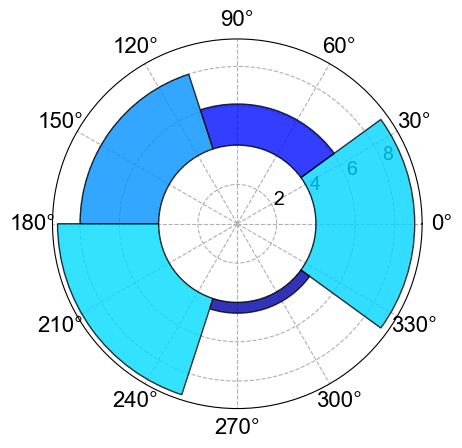

In [185]:
N = 5 #division, every 10 degrees
bottom = 4
max_height = 6

theta = np.linspace(0.0, 2 * np.pi, N, endpoint=False)
radii = max_height*np.random.rand(N)
width = (2*np.pi) / N

ax = plt.subplot(111, polar=True)
bars = ax.bar(theta, radii, width=width,bottom = bottom)
ax.set_theta_zero_location("E")

# Use custom colors and opacity
for r, bar in zip(radii, bars):
    bar.set_facecolor(plt.cm.jet(r /15.))
    bar.set_edgecolor('black')
    bar.set_alpha(0.8)
    bar.set_zorder(3)

# Change the size of the degree labels
ax.tick_params(axis='x', labelsize=16)
ax.tick_params(axis='y', labelsize=14)


# Change x-ticks (angle labels)
ax.set_xticks(np.pi/180. * np.linspace(0,  360, 12, endpoint=False))
ax.set_xticklabels(['0°', '30°', '60°', '90°', '120°', '150°', '180°', '210°','240°','270°','300°','330°'])

# Change y-ticks (radial labels)
# ax.set_yticks([1, 2, 3, 4, 5, 6])  # Example values; change as needed
# ax.set_yticklabels(['1', '2', '3', '4', '5', '6'], fontsize=12)  # Set the font size for y-ticks

# Make the polar grid dashed
ax.grid(True, linestyle='--',zorder=1)  # Set the linestyle to dashed

plt.show()

In [514]:
26.677/7

3.811

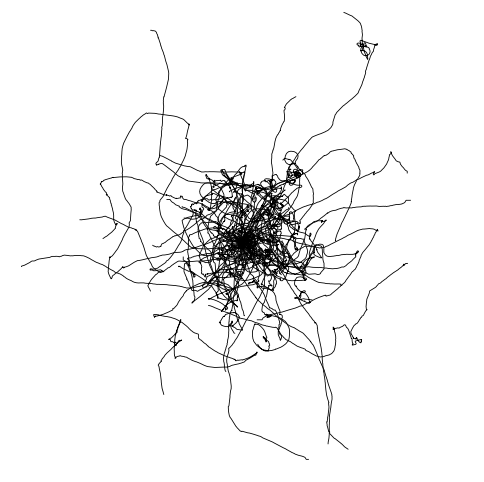

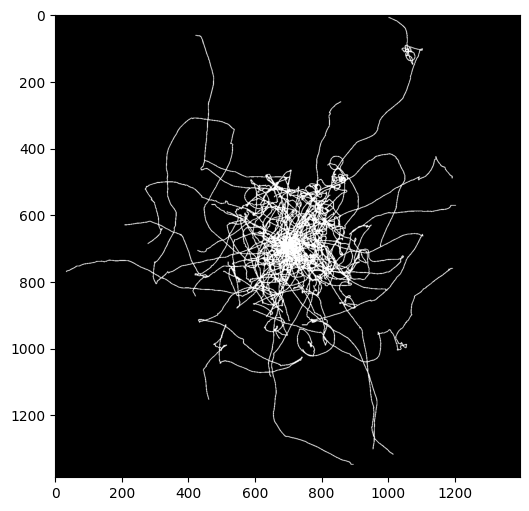

In [78]:
# Assuming datadic is already defined and contains the trajectory data
fig, ax = plt.subplots(figsize=(6,6))

device = 'dev1'
pillar = 'pil0'
disorder = 'dis0'

# Get the total number of trajectories available
total_trajectories = len(datadic[device][pillar][disorder]['reposition'])

random.seed(2020)
# Randomly select 50 unique indices
random_indices = random.sample(range(total_trajectories), 60)

# Plot the selected trajectories
for i in random_indices:
    path = np.array(datadic[device][pillar][disorder]['reposition'][i])
    ax.plot(*path.T, linewidth=0.6, c='k') # ".T" transposes the array, "*" unpacks the rows of the transposed array

plt.xlim(-350, 350)
plt.ylim(-350, 350)
plt.axis('off')

# Save the plot
plt.savefig('unc-repos-0709-.png', dpi=300, bbox_inches='tight', pad_inches=0)

# Convert the saved image to grayscale and inverse binarize it
# Open the saved image
img = Image.open('unc-repos-0709-.png').convert('L')

# Define a threshold value for inverse binarization
threshold = 128

# Apply the inverse binarization
inversely_binarized_img = img.point(lambda p: p > threshold and 0)  # Set pixels above threshold to 0 (black)
inversely_binarized_img = img.point(lambda p: p < threshold and 255)  # Set pixels above threshold to 0 (black)
#inversely_binarized_img = inversely_binarized_img.point(lambda p: p == 0 and 255)  # Set black pixels to white
#inversely_binarized_img = inversely_binarized_img.point(lambda p: p == 255 and 0)  # Set white pixels to black

# Save the inversely binarized image
inversely_binarized_img.save('unc-repos-inversely-binarized-.png')

# Display the inversely binarized image
plt.figure(figsize=(6, 6))
plt.imshow(np.array(inversely_binarized_img), cmap='gray')
plt.axis('off')
plt.show()


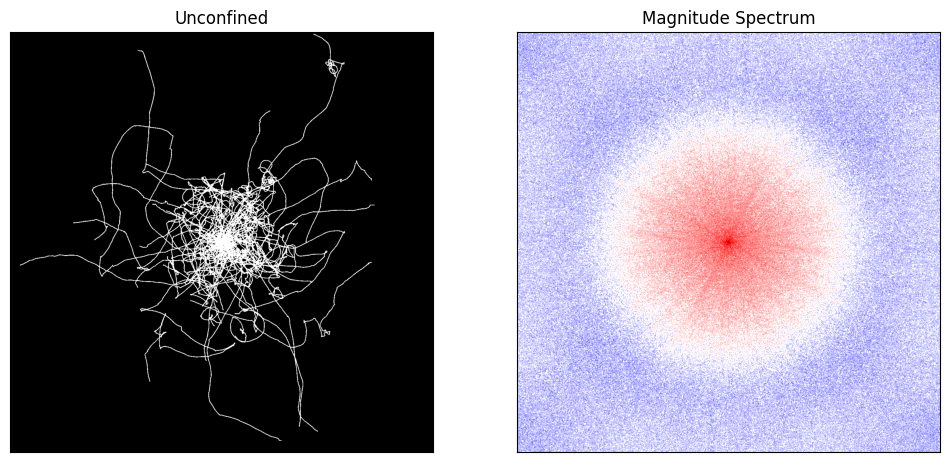

In [33]:
#FFT and plot the magnitude spectrum
img = imread('unc-repos-inversely-binarized.png')
f = np.fft.fft2(img)
fshift = np.fft.fftshift(f)
magnitude_spectrum = 20*np.log(np.abs(fshift))
# Set the figure size
plt.figure(figsize=(12, 6))  # Adjust the figure size as needed
plt.subplot(121),plt.imshow(img, cmap = 'gray')
plt.title('Unconfined'), plt.xticks([]), plt.yticks([])
plt.subplot(122),plt.imshow(magnitude_spectrum, cmap = 'seismic')
plt.title('Magnitude Spectrum'), plt.xticks([]), plt.yticks([])
plt.savefig('unconfined_fft.pdf',dpi=300,transparent=True)
plt.show()

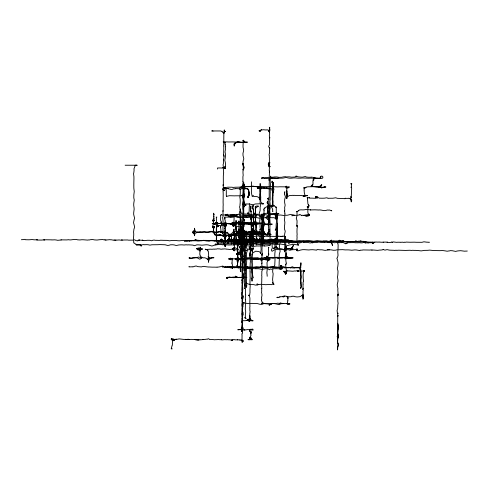

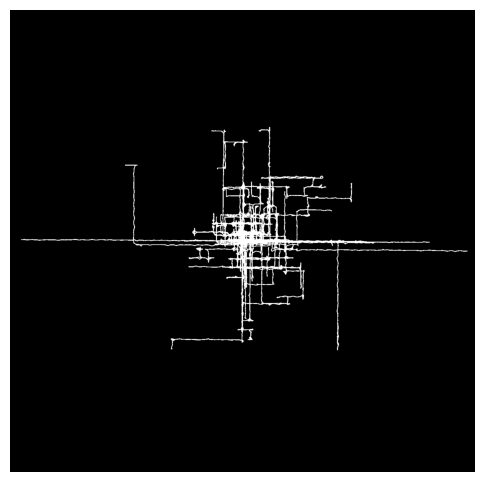

In [37]:
# Assuming datadic is already defined and contains the trajectory data
fig, ax = plt.subplots(figsize=(6,6))

device = 'dev1'
pillar = 'pil3'
disorder = 'dis1'

# Get the total number of trajectories available
total_trajectories = len(datadic[device][pillar][disorder]['reposition'])

random.seed(2021)
# Randomly select 50 unique indices
random_indices = random.sample(range(total_trajectories), 60)

# Plot the selected trajectories
for i in random_indices:
    path = np.array(datadic[device][pillar][disorder]['reposition'][i])
    ax.plot(*path.T, linewidth=0.6, c='k') # ".T" transposes the array, "*" unpacks the rows of the transposed array

plt.xlim(-350, 350)
plt.ylim(-350, 350)
plt.axis('off')

# Save the plot
plt.savefig('1-0x-repos-0709.png', dpi=300, bbox_inches='tight', pad_inches=0)

# Convert the saved image to grayscale and inverse binarize it
# Open the saved image
img = Image.open('1-0x-repos-0709.png').convert('L')

# Define a threshold value for inverse binarization
threshold = 128

# Apply the inverse binarization
inversely_binarized_img = img.point(lambda p: p > threshold and 0)  # Set pixels above threshold to 0 (black)
inversely_binarized_img = img.point(lambda p: p < threshold and 255)  # Set pixels above threshold to 0 (black)
#inversely_binarized_img = inversely_binarized_img.point(lambda p: p == 0 and 255)  # Set black pixels to white
#inversely_binarized_img = inversely_binarized_img.point(lambda p: p == 255 and 0)  # Set white pixels to black

# Save the inversely binarized image
inversely_binarized_img.save('1-0x-repos-inversely-binarized.png')

# Display the inversely binarized image
plt.figure(figsize=(6, 6))
plt.imshow(np.array(inversely_binarized_img), cmap='gray')
plt.axis('off')
plt.show()


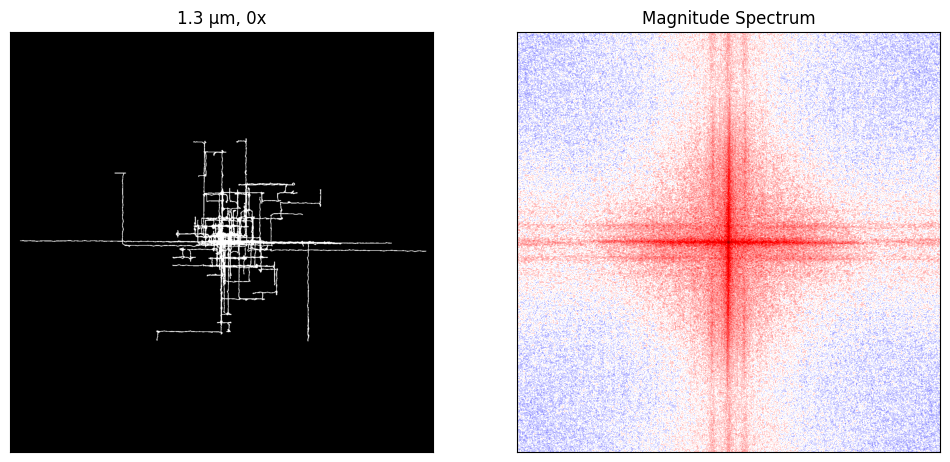

In [38]:
#FFT and plot the magnitude spectrum
img = imread('1-0x-repos-inversely-binarized.png')
f = np.fft.fft2(img)
fshift = np.fft.fftshift(f)
magnitude_spectrum = 20*np.log(np.abs(fshift))
# Set the figure size
plt.figure(figsize=(12, 6))  # Adjust the figure size as needed
plt.subplot(121),plt.imshow(img, cmap = 'gray')
plt.title('1.3 µm, 0x'), plt.xticks([]), plt.yticks([])
plt.subplot(122),plt.imshow(magnitude_spectrum, cmap = 'seismic')
plt.title('Magnitude Spectrum'), plt.xticks([]), plt.yticks([])
plt.savefig('1-0x_fft.pdf',dpi=300,transparent=True)
plt.show()

pil0
dis0


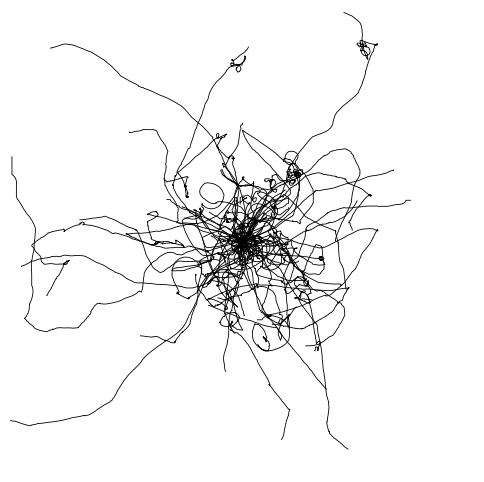

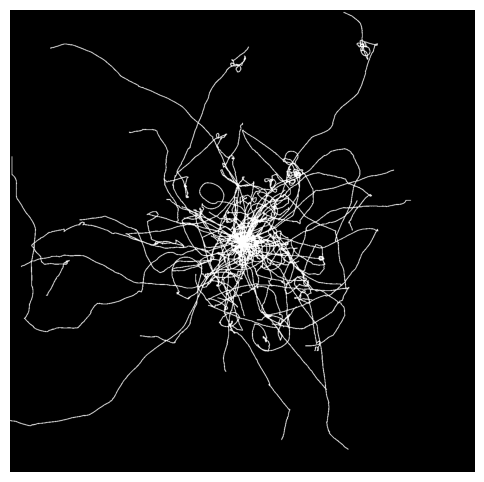

pil1
dis1


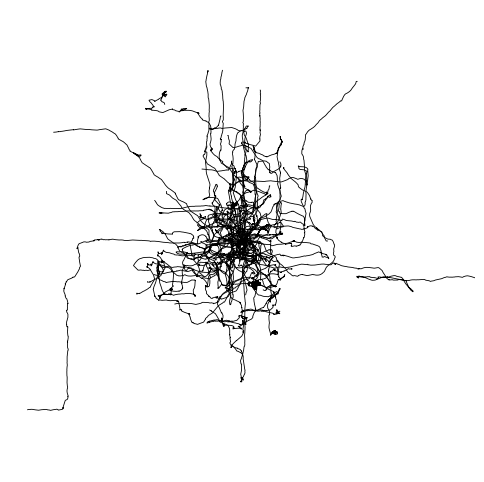

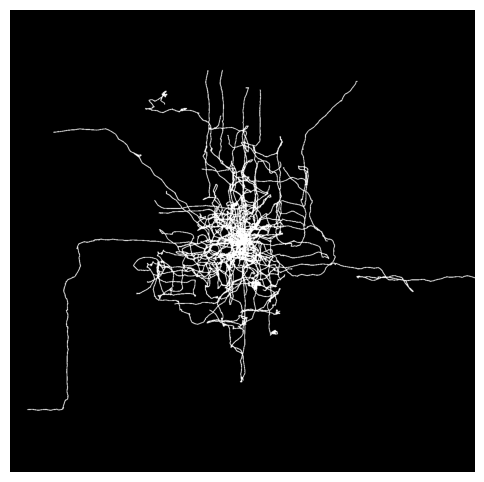

pil1
dis2


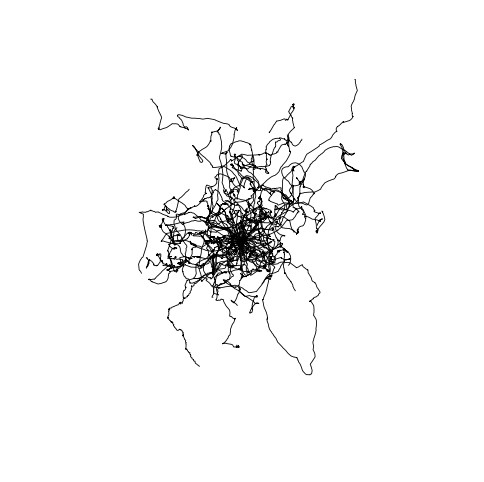

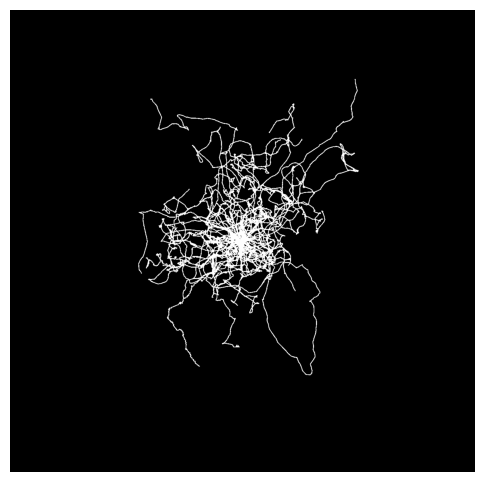

pil1
dis3


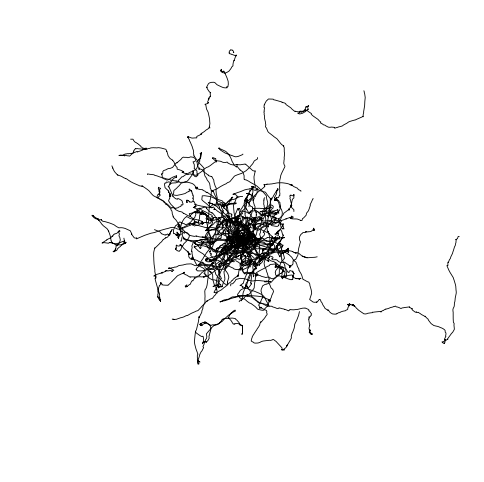

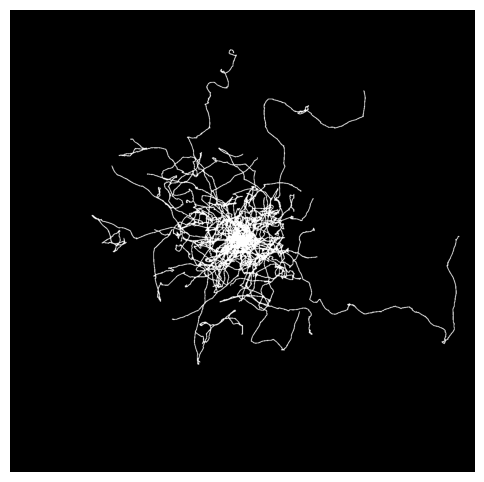

pil1
dis4


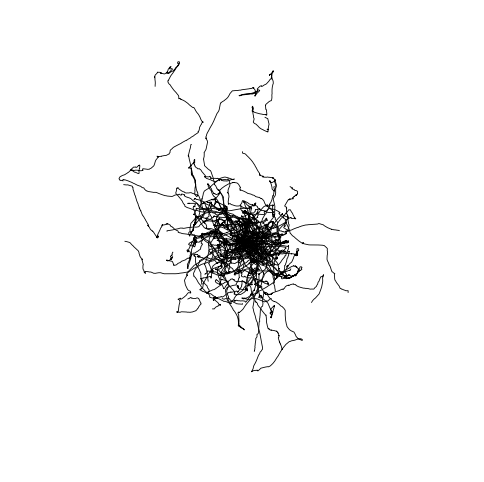

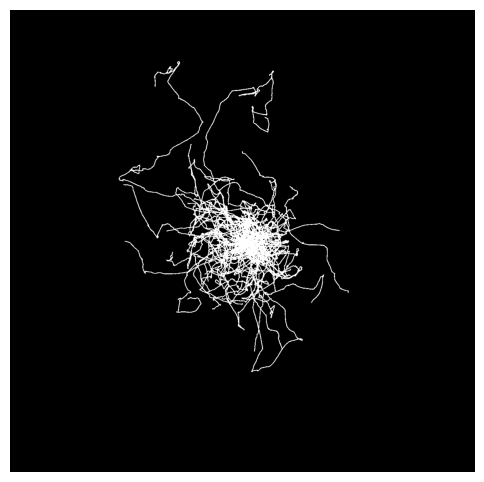

pil2
dis1


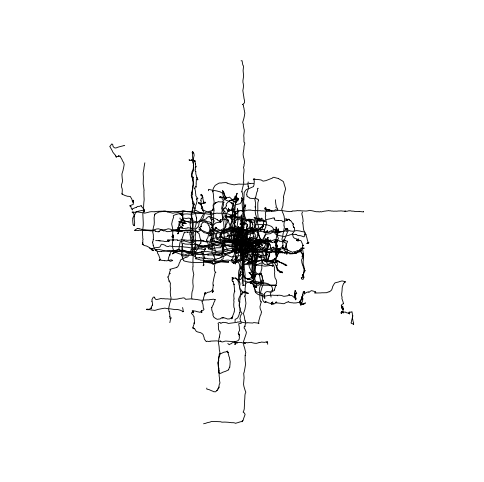

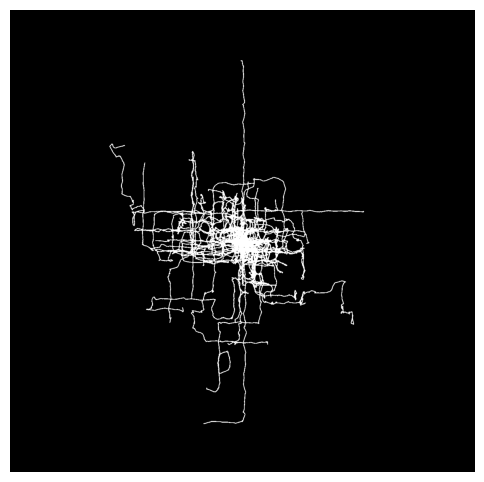

pil2
dis2


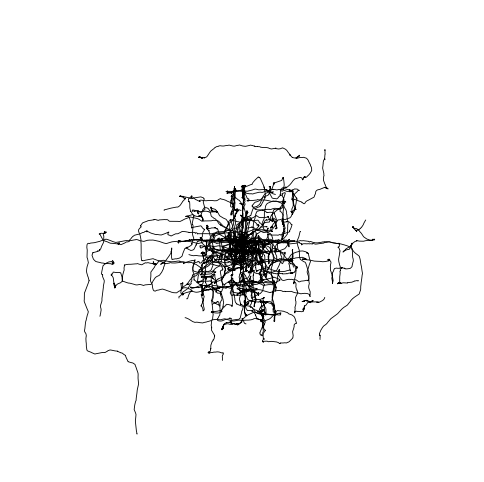

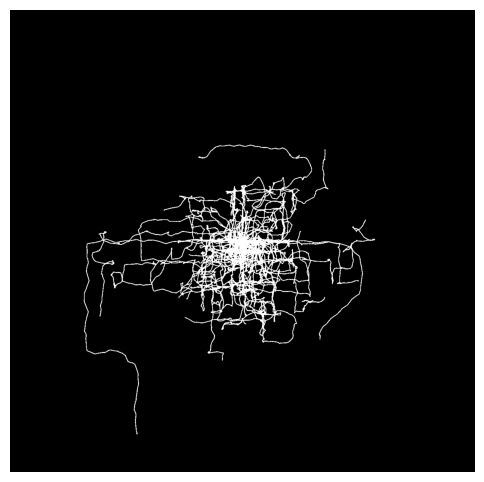

pil2
dis3


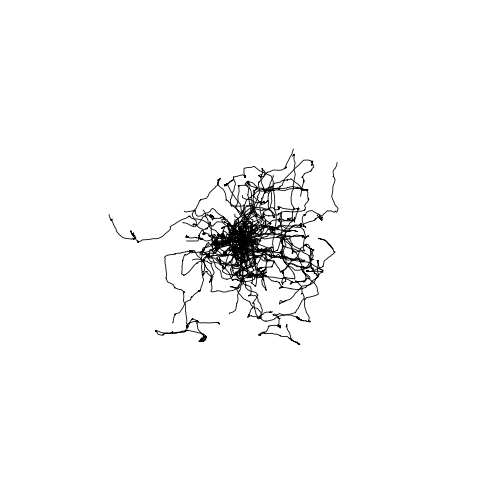

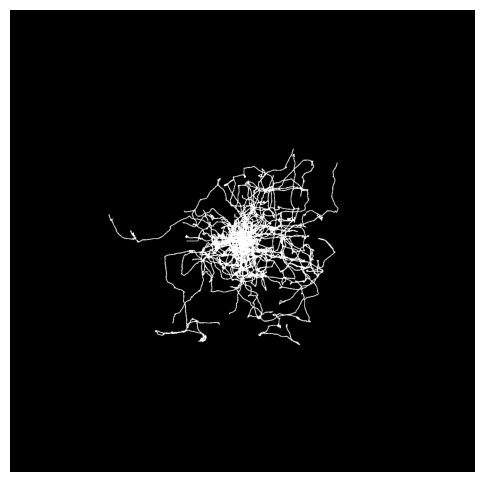

pil2
dis4


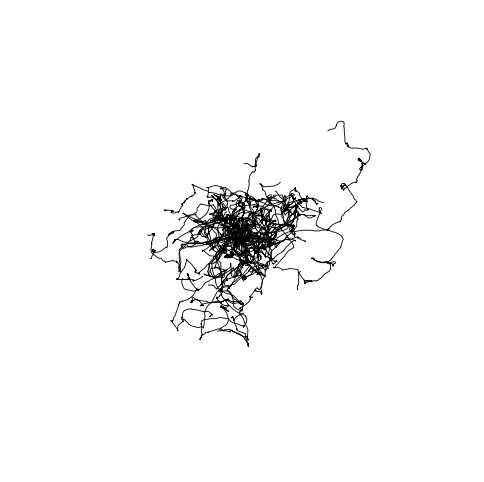

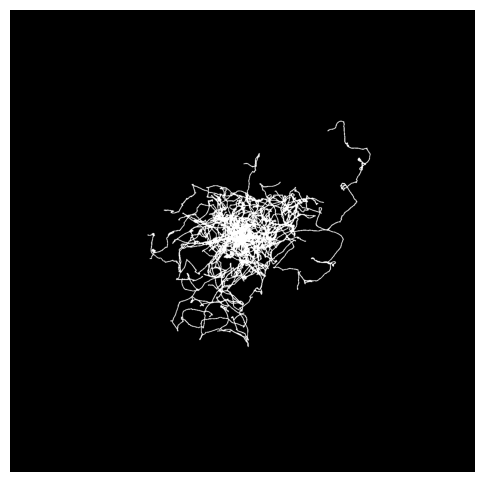

pil3
dis1


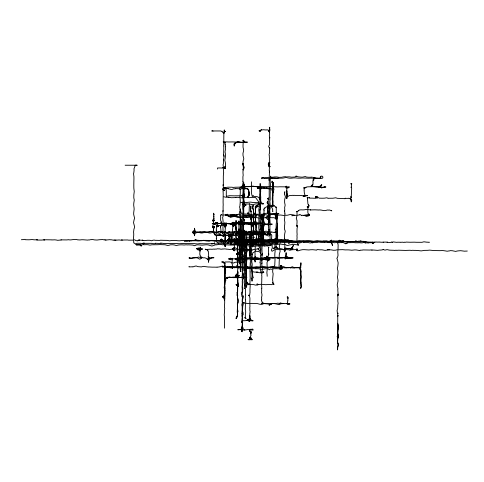

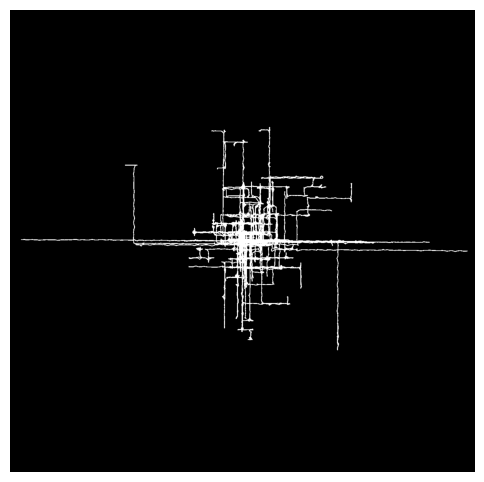

pil3
dis2


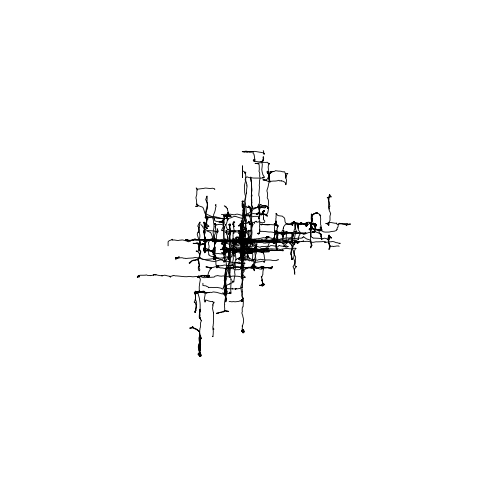

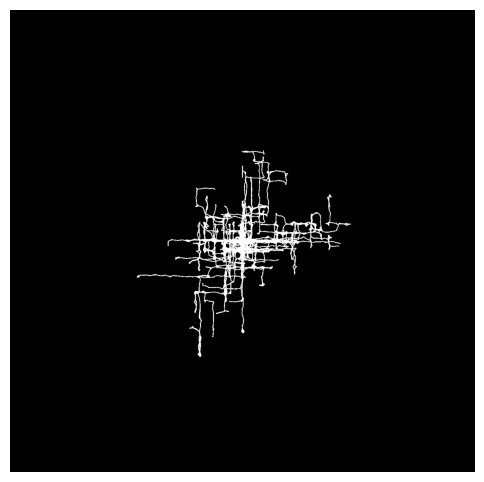

pil3
dis3


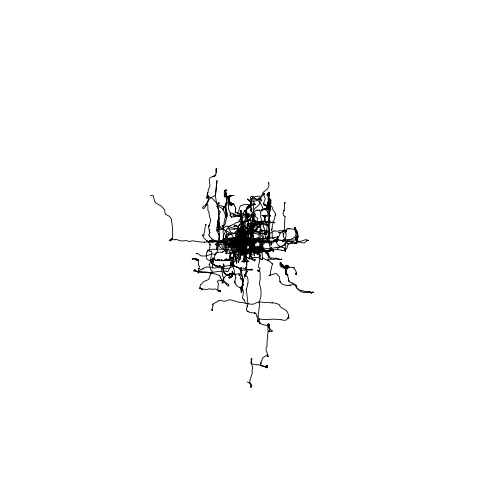

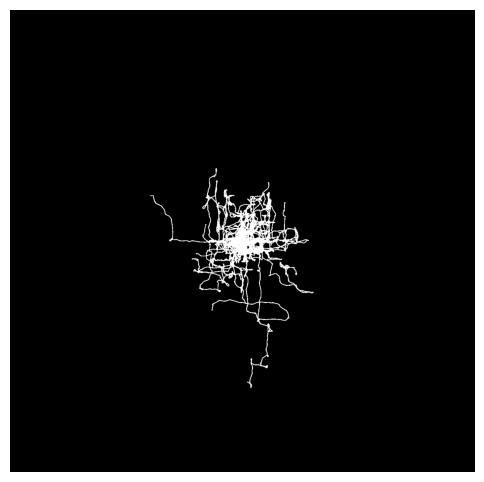

pil3
dis4


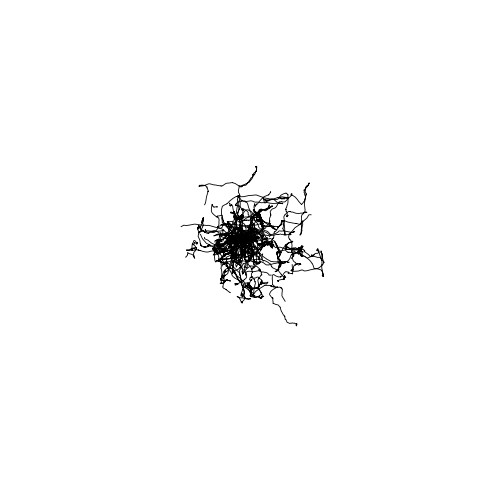

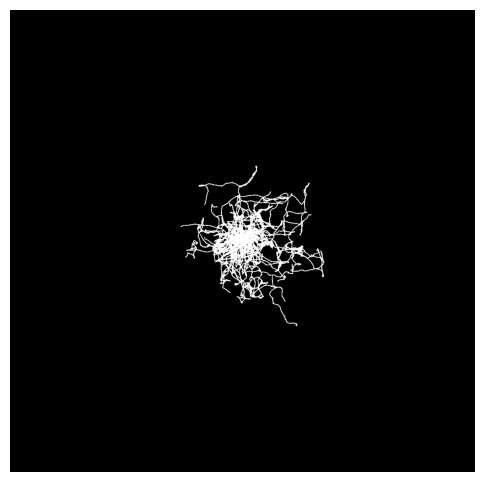

In [80]:
condition = ['Unc', '6 µm; 0x', '6 µm; 1x', '6 µm; 2x', '6 µm; 3x',
       '2.6 µm; 0x', '2.6 µm; 1x', '2.6 µm; 2x', '2.6 µm; 3x', 
        '1.3 µm; 0x', '1.3µm; 1x', '1.3 µm; 2x', '1.3 µm; 3x']

name = ['Unc', '6-0x', '6-1x', '6-2x', '6-3x',
       '2-0x', '2-1x', '2-2x', '2-3x', 
        '1-0x', '1-1x', '1-2x', '1-3x']


#Starting from unconfined -> 6 -> 2.6 -> 1.3
for dev in list(datadic):
    count = 0
    for pil in list(datadic[dev]):
        for dis in list(datadic[dev][pil]):
            print(pil)
            print(dis)
            total_trajectories = len(datadic[dev][pil][dis]['reposition'])

            random.seed(2008)
            # Randomly select 50 unique indices
            random_indices = random.sample(range(total_trajectories), 60)
                
            fig, ax = plt.subplots(figsize=(6,6))
            # Plot the selected trajectories
            for i in random_indices:
                path = np.array(datadic[dev][pil][dis]['reposition'][i])
                ax.plot(*path.T, linewidth=0.6, c='k') # ".T" transposes the array, "*" unpacks the rows of the transposed array

            plt.xlim(-350, 350)
            plt.ylim(-350, 350)
            plt.axis('off')

            # Save the plot
            plt.savefig(f'{name[count]}-repos.png', dpi=300, bbox_inches='tight', pad_inches=0)

            # Convert the saved image to grayscale and inverse binarize it
            # Open the saved image
            img = Image.open(f'{name[count]}-repos.png').convert('L')

            # Define a threshold value for inverse binarization
            threshold = 128

            # Apply the inverse binarization
            inversely_binarized_img = img.point(lambda p: p > threshold and 0)  # Set pixels above threshold to 0 (black)
            inversely_binarized_img = img.point(lambda p: p < threshold and 255)  # Set pixels above threshold to 0 (black)
            #inversely_binarized_img = inversely_binarized_img.point(lambda p: p == 0 and 255)  # Set black pixels to white
            #inversely_binarized_img = inversely_binarized_img.point(lambda p: p == 255 and 0)  # Set white pixels to black

            # Save the inversely binarized image
            inversely_binarized_img.save(f'{name[count]}-repos-inversely-binarized.png')

            # Display the inversely binarized image
            plt.figure(figsize=(6, 6))
            plt.imshow(np.array(inversely_binarized_img), cmap='gray')
            plt.axis('off')
            plt.show()
            count+=1
            

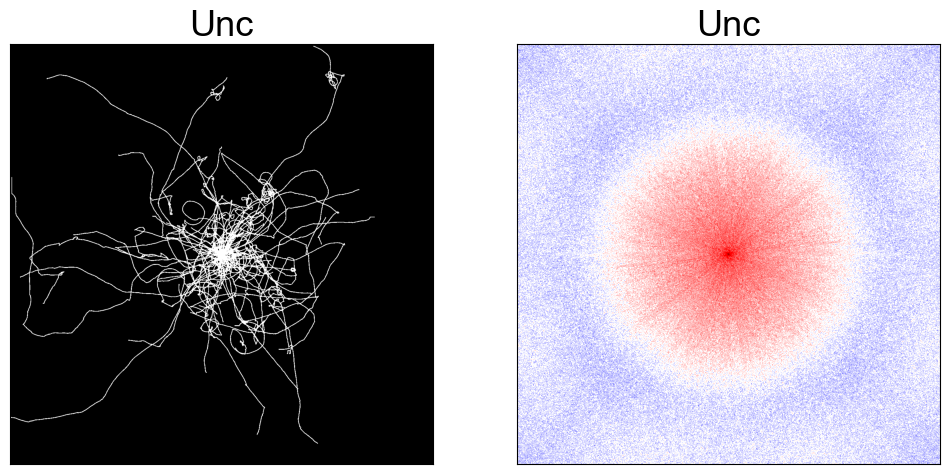

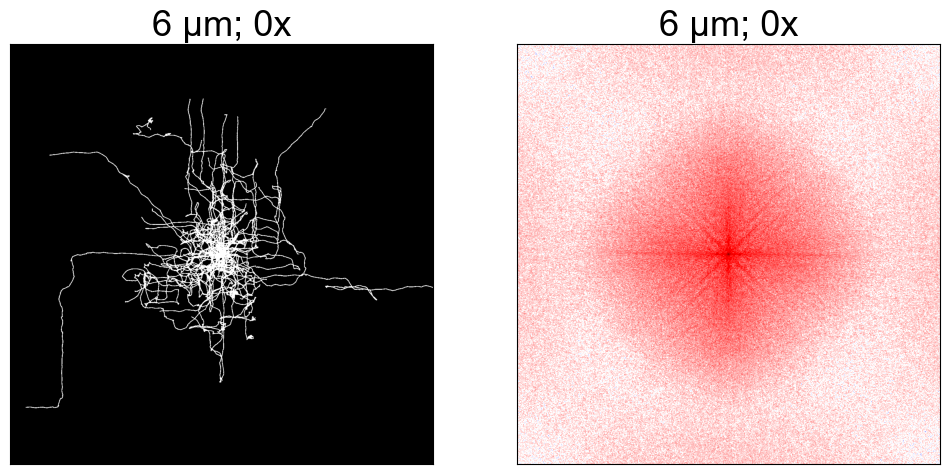

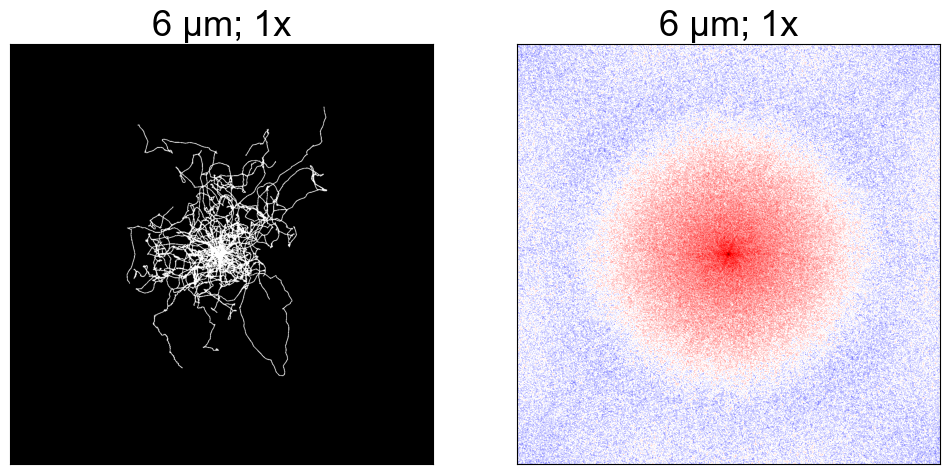

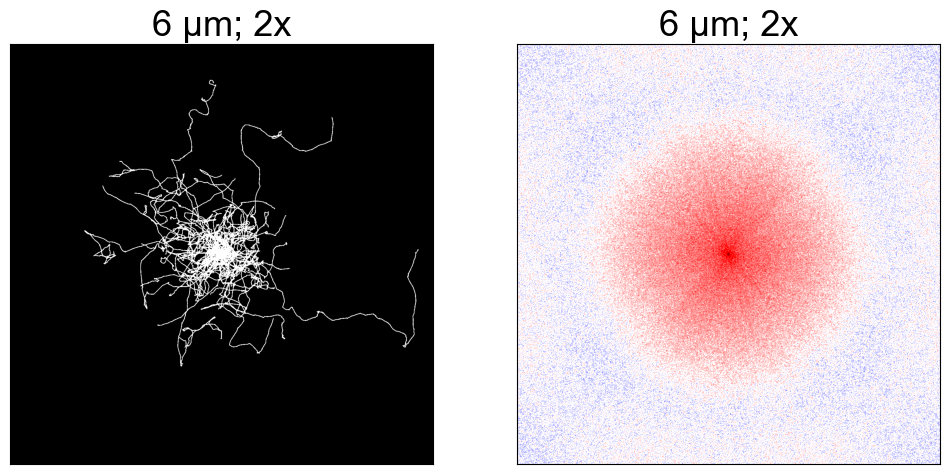

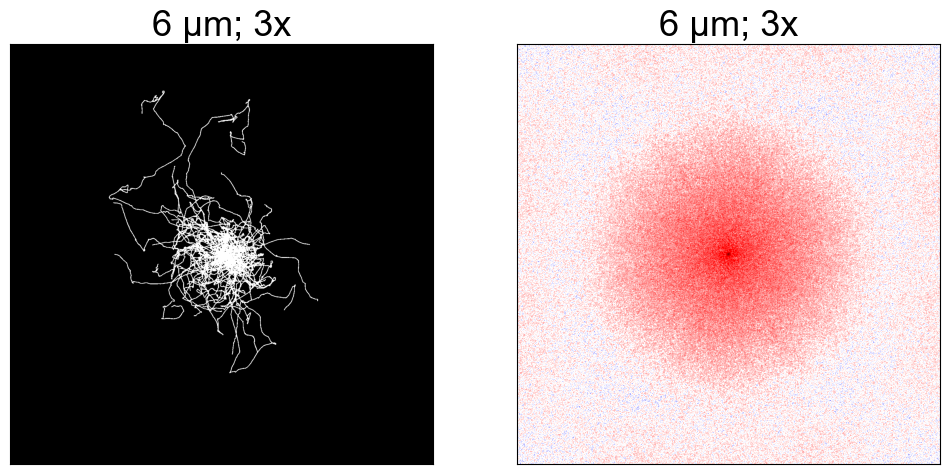

...

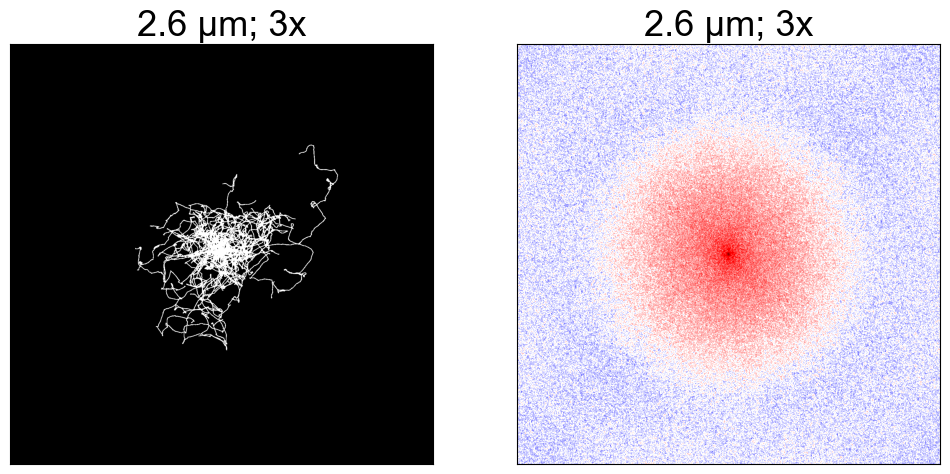

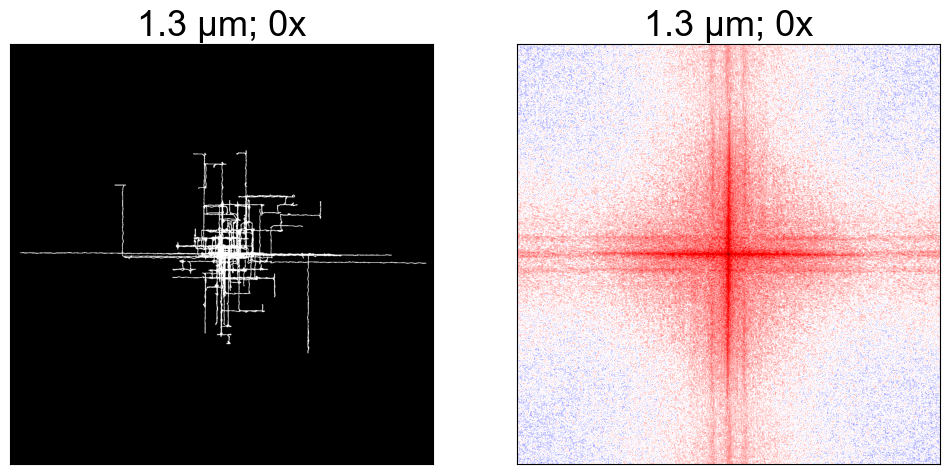

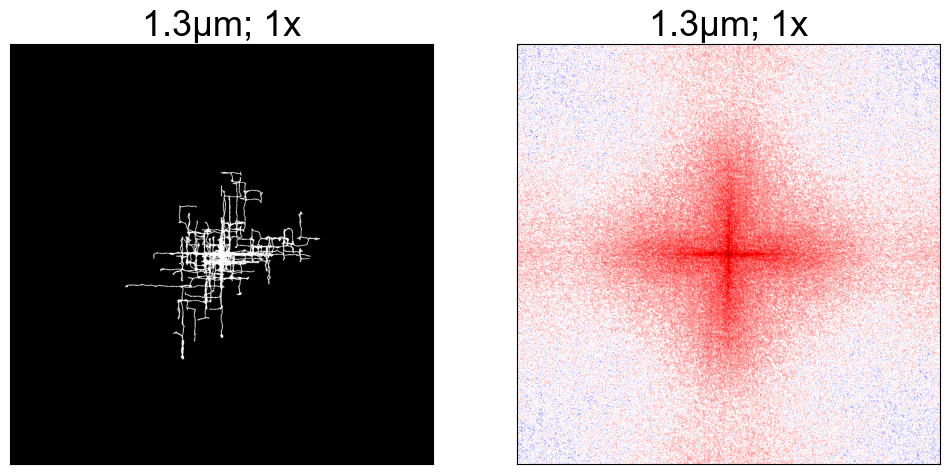

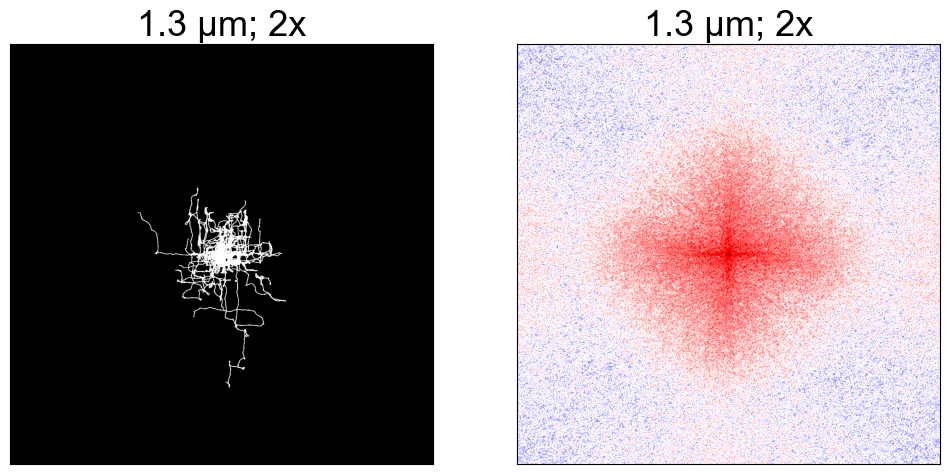

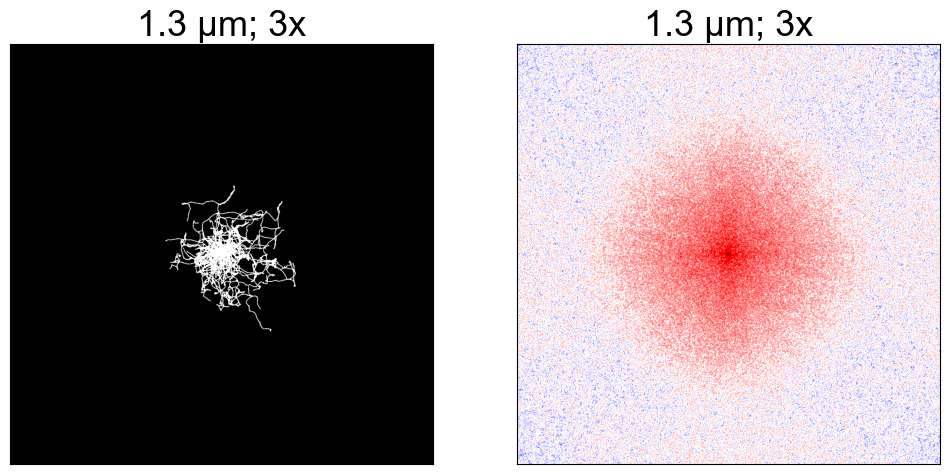

In [84]:
#FFT and plot the magnitude spectrum
plt.rcParams["font.family"] = "Arial"
for i in range(len(name)):
    
    img = imread(f'{name[i]}-repos-inversely-binarized.png')
    f = np.fft.fft2(img)
    fshift = np.fft.fftshift(f)
    magnitude_spectrum = 20*np.log(np.abs(fshift))
    # Set the figure size
    plt.figure(figsize=(12, 6))  # Adjust the figure size as needed
    plt.subplot(121),plt.imshow(img, cmap = 'gray')
    plt.title(f'{condition[i]}',fontsize=26), plt.xticks([]), plt.yticks([])
    plt.subplot(122),plt.imshow(magnitude_spectrum, cmap = 'seismic')
    plt.title(f'{condition[i]}',fontsize=26), plt.xticks([]), plt.yticks([])
    plt.savefig(f'{name[i]}_fft.pdf',dpi=300,transparent=True)
    plt.show()

#### Angle Distribution (Pie charts on polar axis)

In [ ]:
#https://stackoverflow.com/questions/22562364/circular-polar-histogram-in-python
#https://matplotlib.org/2.0.2/examples/pie_and_polar_charts/polar_bar_demo.html

In [89]:
import plotly.graph_objects as go

fig = go.Figure(data=
    go.Scatterpolar(
        r = [0.5,1,2,2.5,3,2.6,4,3,],
        theta = [0,30,60,90,120,150,180,210,240,270,300,330,360],
        mode = 'markers',
    ))

fig.update_layout(showlegend=False)
fig.show()

In [122]:
import plotly.graph_objects as go

fig = go.Figure(go.Barpolar(
    r=[3.5, 1.5, 2.5, 4.5, 4.5, 4, 3],
    theta=[65, 15, 210, 110, 312.5, 180, 270],
    width=[20,15,10,20,15,30,15,],
    marker_color=["#E4FF87", '#709BFF', '#709BFF', '#FFAA70', '#FFAA70', '#FFDF70', '#B6FFB4'],
    marker_line_color="black",
    marker_line_width=2,
    opacity=0.8
))

fig.update_layout(
    template=None,
    polar = dict(
        radialaxis = dict(range=[0, 5], showticklabels=False, ticks=''),
        angularaxis = dict(showticklabels=False, ticks='')
    )
)

fig.show()

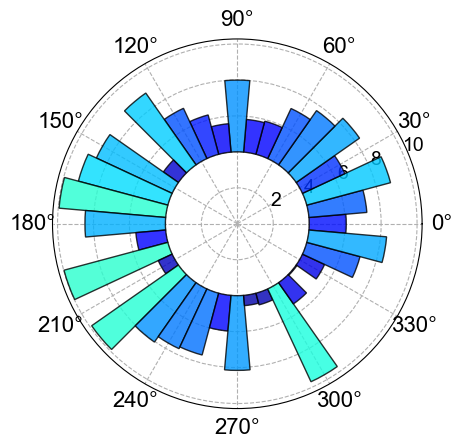

In [146]:
N = 36 #division, every 10 degrees
bottom = 4
max_height = 6

theta = np.linspace(0.0, 2 * np.pi, N, endpoint=False)
radii = max_height*np.random.rand(N)
width = (2*np.pi) / N

ax = plt.subplot(111, polar=True)
bars = ax.bar(theta, radii, width=width,bottom = bottom)
ax.set_theta_zero_location("E")

# Use custom colors and opacity
for r, bar in zip(radii, bars):
    bar.set_facecolor(plt.cm.jet(r /15.))
    bar.set_edgecolor('black')
    bar.set_alpha(0.8)
    bar.set_zorder(3)

# Change the size of the degree labels
ax.tick_params(axis='x', labelsize=16)
ax.tick_params(axis='y', labelsize=14)


# Change x-ticks (angle labels)
ax.set_xticks(np.pi/180. * np.linspace(0,  360, 12, endpoint=False))
ax.set_xticklabels(['0°', '30°', '60°', '90°', '120°', '150°', '180°', '210°','240°','270°','300°','330°'])

# Change y-ticks (radial labels)
# ax.set_yticks([1, 2, 3, 4, 5, 6])  # Example values; change as needed
# ax.set_yticklabels(['1', '2', '3', '4', '5', '6'], fontsize=12)  # Set the font size for y-ticks

# Make the polar grid dashed
ax.grid(True, linestyle='--',zorder=1)  # Set the linestyle to dashed

plt.show()


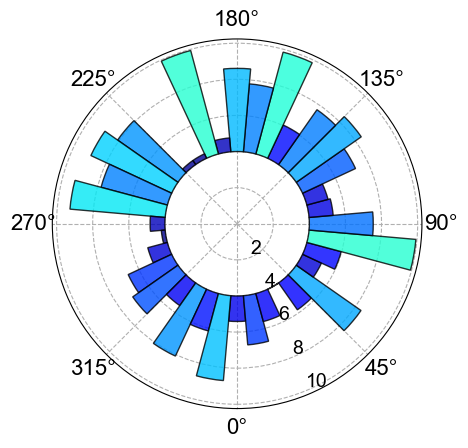

In [141]:
N = 36 #division, every 10 degrees
bottom = 4
max_height = 6

theta = np.linspace(0.0, 2 * np.pi, N, endpoint=False)
radii = max_height*np.random.rand(N)
width = (2*np.pi) / N

ax = plt.subplot(111, polar=True)
bars = ax.bar(theta, radii, width=width,bottom = bottom)
ax.set_theta_zero_location("S")

# Use custom colors and opacity
for r, bar in zip(radii, bars):
    bar.set_facecolor(plt.cm.jet(r /15.))
    bar.set_edgecolor('black')
    bar.set_alpha(0.8)
    bar.set_zorder(3)

# Change the size of the degree labels
ax.tick_params(axis='x', labelsize=16)
ax.tick_params(axis='y', labelsize=14)

# Change x-ticks (angle labels)
#ax.set_xticks(np.pi/180. * np.linspace(0,  360, 8, endpoint=False))
#ax.set_xticklabels(['0°', '45°', '90°', '135°', '180°', '225°','270°','315°'])

# Change y-ticks (radial labels)
# ax.set_yticks([1, 2, 3, 4, 5, 6])  # Example values; change as needed
# ax.set_yticklabels(['1', '2', '3', '4', '5', '6'], fontsize=12)  # Set the font size for y-ticks

# Make the polar grid dashed
ax.grid(True, linestyle='--',zorder=1)  # Set the linestyle to dashed

plt.show()
